In [202]:
#setwd("../../FIGURE4/")
library(data.table)
cool=read.table("GSE114822.rawCounts.txt",header = T)
cool=as.data.frame(cool)
cool=CreateSeuratObject(cool)
cool=NormalizeData(cool,verbose = F)
cool=FindVariableFeatures(cool,verbose = F)
cool=ScaleData(cool,verbose = F,vars.to.regress = "nCount_RNA")
cool=RunPCA(cool,verbose=F)
cool=RunUMAP(cool,dims=1:15,verbose=F)
cool=FindNeighbors(cool,dims=1:15,verbose=F)
cool=FindClusters(cool,verbose=F)
cool$stage=sub("_.*","",Cells(cool))

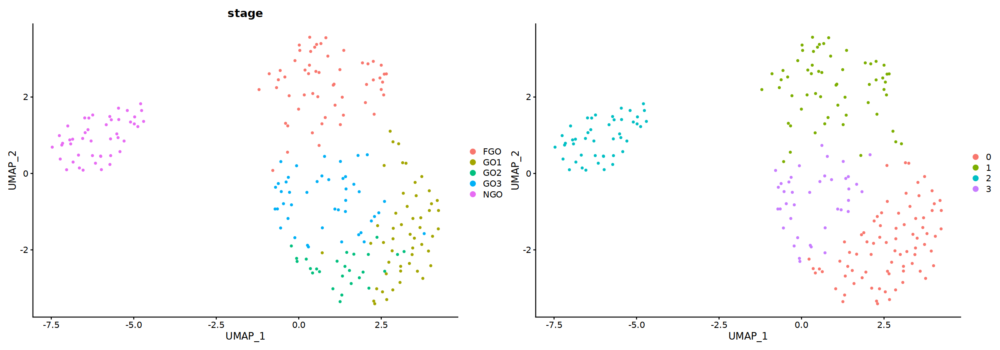

In [205]:
DimPlot(cool,group.by = "stage") + DimPlot(cool)

In [217]:
Idents(cool)="stage"
markers3=FindAllMarkers(cool)

Calculating cluster NGO

Calculating cluster GO1

Calculating cluster GO2

Calculating cluster GO3

Calculating cluster FGO



In [218]:
head(markers3)

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
Crabp1,7.823579e-42,0.5047108,0.935,0.028,1.815148e-37,NGO,Crabp1
Impdh1,2.763987e-28,0.2607691,0.978,0.316,6.412726e-24,NGO,Impdh1
Trap1a,8.950663e-28,0.2915766,0.891,0.153,2.076643e-23,NGO,Trap1a
Itm2a,4.145190e-27,0.2579512,0.870,0.136,9.617256e-23,NGO,Itm2a
Rbms1,7.925830e-27,0.2899920,0.978,0.299,1.838872e-22,NGO,Rbms1
Rbm46,8.583844e-27,0.4951525,1.000,0.373,1.991538e-22,NGO,Rbm46


In [219]:
markers3$num=1:nrow(markers3)
test1=markers3 %>% group_by(cluster) %>% top_n(15,wt=-num)
split(test1$gene,test1$cluster)

$NGO
 [1] "Crabp1"   "Impdh1"   "Trap1a"   "Itm2a"    "Rbms1"    "Rbm46"   
 [7] "Atxn10"   "Sohlh1"   "Krt79"    "Ogfr"     "Adad2"    "Ctsf"    
[13] "Slc25a10" "Hspbp1"   "Cox4i2"  

$GO1
 [1] "Zfp616"        "Tmed2"         "Zp3"           "Pfn1"         
 [5] "Tmem250-ps"    "Btbd9"         "Eif2s2"        "Lamtor1"      
 [9] "Baz1a"         "Fam160a1"      "Ssb"           "Gdap1"        
[13] "Cd9"           "1190002N15Rik" "Hnrnpul2"     

$GO2
 [1] "Rab14"         "Lmo3"          "Tmem171"       "Epsti1"       
 [5] "Angel2"        "Bcl2l10"       "Depdc7"        "Musk"         
 [9] "Rbbp7"         "Malat1"        "H2afz"         "Mcu"          
[13] "E330023G01Rik" "Ppp1r12a"      "Tiparp"       

$GO3
 [1] "Il17f"      "Cmya5"      "Luzp1"      "Lypd6b"     "Abcc6"     
 [6] "Ccnb2"      "Crip2"      "Pop7"       "Fam221a"    "Mettl7a3"  
[11] "Nudt7"      "D5Ertd577e" "Rab33b"     "Psmg1"      "Cnn3"      

$FGO
 [1] "Pkib"    "Mrps36"  "Pigp"    "Zbtb49"  "Nkiras1" "Fetub"   "Derl2"  
 [8] "Tmem50a" "Rpp21"   "Abcd4"   "H1f0"    "Dppa5a"  "Hpse"    "Cebpzos"
[15] "Trps1"

In [34]:
#setwd("../../FIGURE4/")
library(data.table)
TT=fread("GSE197578_mouse_mat.txt",header = T)
TT=as.data.frame(TT)
TT$gene=sub("[^-]*_","",TT$gene)
TT=TT[!duplicated(TT$gene),]
rownames(TT)=TT$gene
TT=TT[,-1]
TT=CreateSeuratObject(TT)
TT$stage=sub("_.*","",sub("Mouse_[0-9]*","",Cells(TT)))
TT=NormalizeData(TT,verbose = F)
TT=FindVariableFeatures(TT,verbose = F)
TT=ScaleData(TT,verbose = F,vars.to.regress = "nCount_RNA")
TT$stage=sub("_.*","",sub("Mouse_[0-9]*","",Cells(TT)))
table(TT$stage)
markers=FindMarkers(TT,group.by = "stage",`ident.1` = "GV",`ident.2` = "MII")
markers$num=1:nrow(markers)
markers$gene=rownames(markers)
library(dplyr)
test=markers %>% group_by(avg_log2FC>0) %>% top_n(15,wt=-num)
split(test$gene,test$`avg_log2FC > 0`)


 GV MII 
 12  12 


Attaching package: ‘dplyr’


The following objects are masked from ‘package:data.table’:

    between, first, last


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union




$`FALSE`
 [1] "Ralgps2" "Rab14"   "Fastkd1" "Ddb2"    "Api5"    "Kif18a"  "Zswim3" 
 [8] "E2f5"    "Sclt1"   "Siah2"   "Tiparp"  "Trim59"  "Vps72"   "Golph3l"
[15] "Cept1"  

$`TRUE`
 [1] "Ss18l2"  "Gstt2"   "Prss12"  "Chchd7"  "Rps9"    "Rps13"   "Dscc1"  
 [8] "Rps4x"   "Nudt5"   "Nek6"    "Psmb7"   "Psmb4"   "Rps20"   "Prkrip1"
[15] "Emg1"

In [35]:
test=markers %>% group_by(avg_log2FC>0) %>% top_n(15,wt=-num)
split(test$gene,test$`avg_log2FC > 0`)

$`FALSE`
 [1] "Ralgps2" "Rab14"   "Fastkd1" "Ddb2"    "Api5"    "Kif18a"  "Zswim3" 
 [8] "E2f5"    "Sclt1"   "Siah2"   "Tiparp"  "Trim59"  "Vps72"   "Golph3l"
[15] "Cept1"  

$`TRUE`
 [1] "Ss18l2"  "Gstt2"   "Prss12"  "Chchd7"  "Rps9"    "Rps13"   "Dscc1"  
 [8] "Rps4x"   "Nudt5"   "Nek6"    "Psmb7"   "Psmb4"   "Rps20"   "Prkrip1"
[15] "Emg1"

Warning message:
“ggrepel: 4221 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


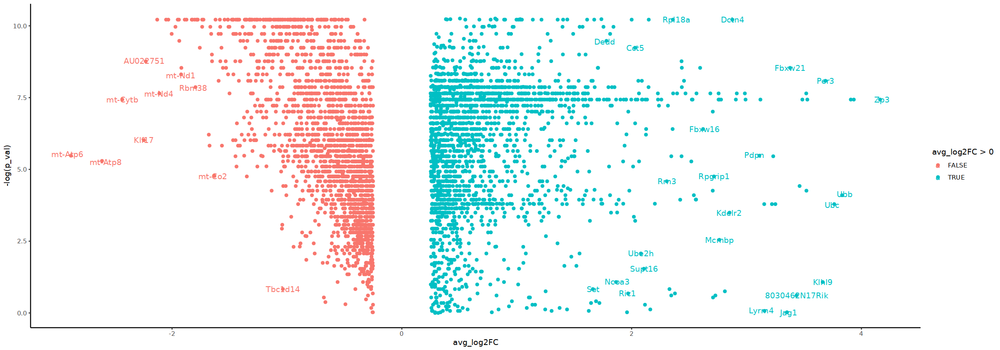

In [147]:
options(repr.plot.width=20)
ggplot(markers,aes(x=avg_log2FC,y=-log(p_val),color=avg_log2FC>0))+geom_point()+ggrepel::geom_text_repel(aes(label=rownames(markers)),max.overlaps = 2)+theme_classic()
options(repr.plot.width=8)

In [2]:
library(Seurat)
library(ggplot2)
library(clusterProfiler)
library(harmony)

Attaching SeuratObject



Registered S3 methods overwritten by 'treeio':
  method              from    
  MRCA.phylo          tidytree
  MRCA.treedata       tidytree
  Nnode.treedata      tidytree
  Ntip.treedata       tidytree
  ancestor.phylo      tidytree
  ancestor.treedata   tidytree
  child.phylo         tidytree
  child.treedata      tidytree
  full_join.phylo     tidytree
  full_join.treedata  tidytree
  groupClade.phylo    tidytree
  groupClade.treedata tidytree
  groupOTU.phylo      tidytree
  groupOTU.treedata   tidytree
  is.rooted.treedata  tidytree
  nodeid.phylo        tidytree
  nodeid.treedata     tidytree
  nodelab.phylo       tidytree
  nodelab.treedata    tidytree
  offspring.phylo     tidytree
  offspring.treedata  tidytree
  parent.phylo        tidytree
  parent.treedata     tidytree
  root.treedata       tidytree
  rootnode.phylo      tidytree
  sibling.phylo       tidytree

clusterProfiler v4.6.2  For help: https://yulab-smu.top/biomedical-knowledge-mining-book/

In [14]:
setwd("/hwfssz1/ST_SUPERCELLS/P22Z10200N0661/haoshijie/FIGURE4")

In [47]:
library(data.table)
E5_gem=fread("D01767E5.gem")

In [48]:
C1_gem=fread("A03099C1/A03099C1.gem")

In [49]:
E5_mask=fread("D01767E5.cell_mask.csv")

In [50]:
C1_mask=fread("A03099C1/A03099C1.cell_mask.csv")

In [51]:
E5_mer=merge(E5_gem,E5_mask,group.by=c("x","y"))

In [52]:
C1_mer=merge(C1_gem,C1_mask,group.by=c("x","y"))

In [53]:
module=read.csv("/hwfssz1/ST_SUPERCELLS/P22Z10200N0661/haoshijie/FIGURE4/hotspot/select.module-gene.list",header=F)

In [54]:
modules=split(module$V1,module$V7)

In [55]:
E5_mer$coor_x=round(E5_mer$x/10,digits = 0)
E5_mer$coor_y=round(E5_mer$y/10,digits = 0)
E5_mer$bin=paste0(E5_mer$coor_x,"_",E5_mer$coor_y)
cell=1:length(unique(E5_mer$bin))
gene=1:length(unique(E5_mer$geneID))
names(cell)=unique(E5_mer$bin)
names(gene)=unique(E5_mer$geneID)
library(Matrix)
mat=sparseMatrix(j = cell[E5_mer$bin],i=gene[E5_mer$geneID],x=E5_mer$MIDCount)

In [56]:
library(Seurat)
rownames(mat)=names(gene)
colnames(mat)=names(cell)
obj=CreateSeuratObject(mat)

In [57]:
obj=NormalizeData(obj)

In [58]:
obj=AddModuleScore(obj,features = modules)

In [59]:
map=unique(E5_mer[,c("bin","cell")])

In [60]:
map=map[!duplicated(map$bin),]

In [61]:
rownames(map)=map$bin

In [62]:
map=as.data.frame(map)

In [63]:
obj$cell=map[rownames(obj@meta.data),"cell"]

In [64]:
obj@meta.data[,"coor_x"]=as.numeric(sub("_.*","",rownames(obj@meta.data)))

In [65]:
obj@meta.data[,"coor_y"]=as.numeric(sub(".*_","",rownames(obj@meta.data)))

In [66]:
map=as.data.frame(unique(E5_mer[,c("bin","cell")]))
map=map[!duplicated(map$bin),]
rownames(map)=map$bin

In [42]:
obj$mask=map[rownames(obj@meta.data),"bin"]

In [275]:
modules[[10]]

[1] "Zbed3"      "Ubb"        "Pdcd7"      "Plat"       "Dnmt1"     
 [6] "Bmp15"      "D6Ertd527e" "Oog3"       "Rfpl4"      "Fip1l1"    
[11] "Slc45a3"    "Clk1"       "Arhgef11"   "Mdm4"       "Txndc5"    
[16] "Gm2042"     "Henmt1"

Warning message:
“Removed 109673 rows containing missing values (`geom_tile()`).”


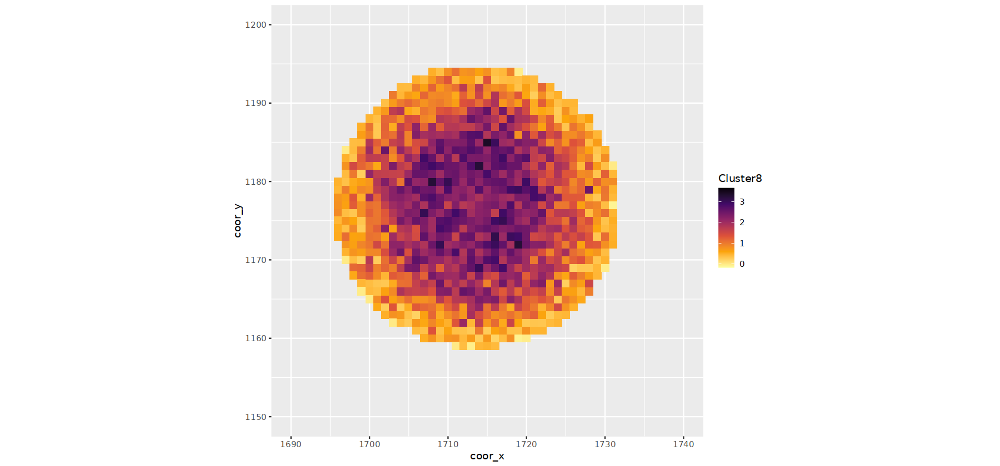

In [68]:
ggplot(obj@meta.data,aes(coor_x,coor_y,fill=Cluster8))+geom_tile()+coord_fixed()+xlim(1690,1740)+ylim(1150,1200)+scale_fill_viridis_c(option = "B",direction = -1)

Warning message:
“Removed 109673 rows containing missing values (`geom_tile()`).”


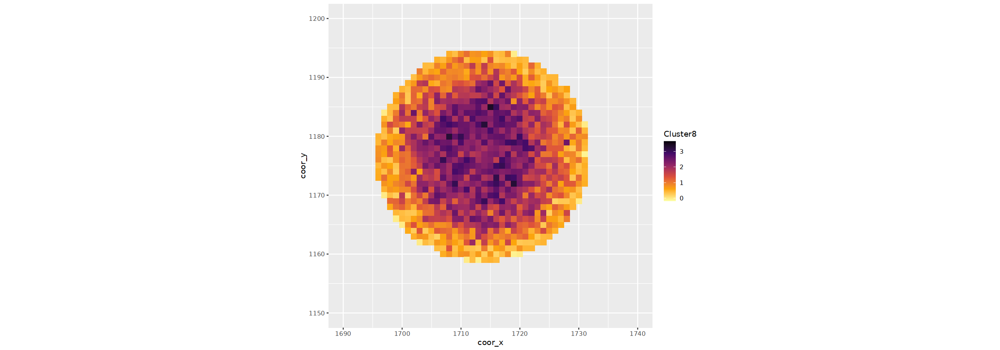

In [227]:
ggplot(obj@meta.data,aes(coor_x,coor_y,fill=Cluster8))+geom_tile()+coord_fixed()+xlim(1690,1740)+ylim(1150,1200)+scale_fill_viridis_c(option = "B",direction = -1)

In [69]:
library(viridis)

Loading required package: viridisLite



In [253]:
viridis_pal(option = "B",direction = -1)(10)

[1] "#FCFFA4FF" "#F7D03CFF" "#FB9A06FF" "#ED6925FF" "#CF4446FF" "#A52C60FF"
 [7] "#781C6DFF" "#4B0C6BFF" "#1B0C42FF" "#000004FF"

In [76]:
p1=ggplot(obj@meta.data,aes(coor_x,coor_y,z=Cluster8))+geom_contour_filled(bins=10)+coord_fixed()+xlim(1690,1740)+ylim(1150,1200)+scale_fill_manual(values = viridis_pal(option = "B",direction = 1)(8))+theme_void()
p2=ggplot(obj@meta.data,aes(coor_x,coor_y,z=Cluster10))+geom_contour_filled(bins=10)+coord_fixed()+xlim(1690,1740)+ylim(1150,1200)+scale_fill_manual(values = viridis_pal(option = "B",direction = 1)(8))+theme_void()

Warning message:
“Removed 109673 rows containing non-finite values (`stat_contour_filled()`).”
Warning message:
“Removed 109673 rows containing non-finite values (`stat_contour_filled()`).”
Warning message:
“Removed 109673 rows containing non-finite values (`stat_contour_filled()`).”
Warning message:
“Removed 109673 rows containing non-finite values (`stat_contour_filled()`).”


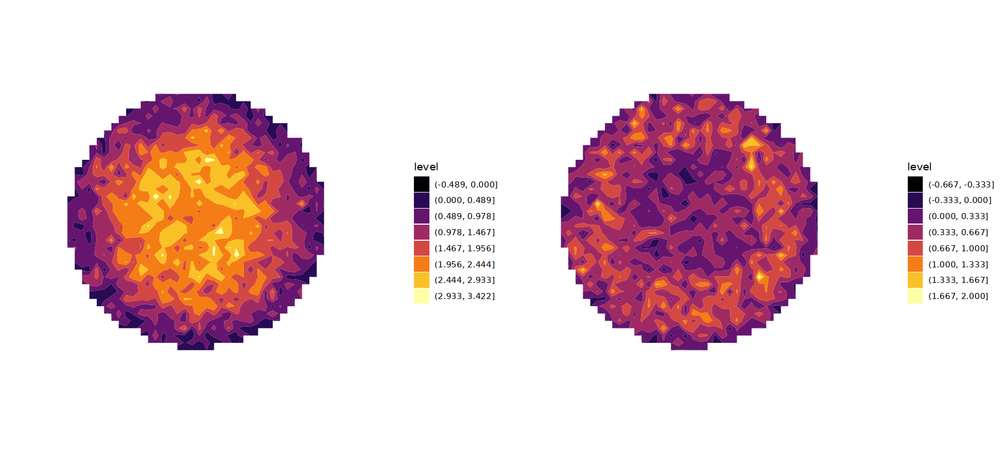

In [78]:
p1|p2
ggsave("subcellular.module.pdf",plot=p1|p2,width = 10,height=4)

In [73]:
modules[8]
modules[10]

$A03099C1_82_4
 [1] "Ooep"          "Gm42418"       "Gm813"         "E330017A01Rik"
 [5] "Dppa3"         "Oas1c"         "Oosp1"         "H1foo"        
 [9] "Uchl1"         "Oas1h"         "Tmem14c"       "D10Wsu102e"   
[13] "Elobl"         "Fbxw24"        "Gtsf1"

$A03099C3_130_1
 [1] "Zbed3"      "Ubb"        "Pdcd7"      "Plat"       "Dnmt1"     
 [6] "Bmp15"      "D6Ertd527e" "Oog3"       "Rfpl4"      "Fip1l1"    
[11] "Slc45a3"    "Clk1"       "Arhgef11"   "Mdm4"       "Txndc5"    
[16] "Gm2042"     "Henmt1"

In [16]:
library(Rmagic)

In [74]:
pdf("Ooep_Rfpl4.cell.pdf",width=5,height=5)
df$color=df$geneID=="Ooep"
ggplot(df,aes(x,y,fill=color))+geom_tile()+coord_fixed()+scale_fill_manual(values = c("gray","red"))+geom_point(inherit.aes = F,data=df[df$geneID=="Ooep",],aes(x,y),color="red")+labs(title="Ooep")+theme_void()
df$color=df$geneID=="Rfpl4"
ggplot(df,aes(x,y,fill=color))+geom_tile()+coord_fixed()+scale_fill_manual(values = c("gray","red"))+geom_point(inherit.aes = F,data=df[df$geneID=="Rfpl4",],aes(x,y),color="red")+labs(title="Rfpl4")+theme_void()
dev.off()

png 
  2

In [75]:
getwd()

[1] "/hwfssz1/ST_SUPERCELLS/P22Z10200N0661/haoshijie/FIGURE4"

In [39]:
df=E5_mer[ E5_mer$x > 16900 & E5_mer$x < 17400 & E5_mer$y>11500 & E5_mer$y<12000 ,]

In [45]:
table(df$color)


 FALSE   TRUE 
244073   1583 

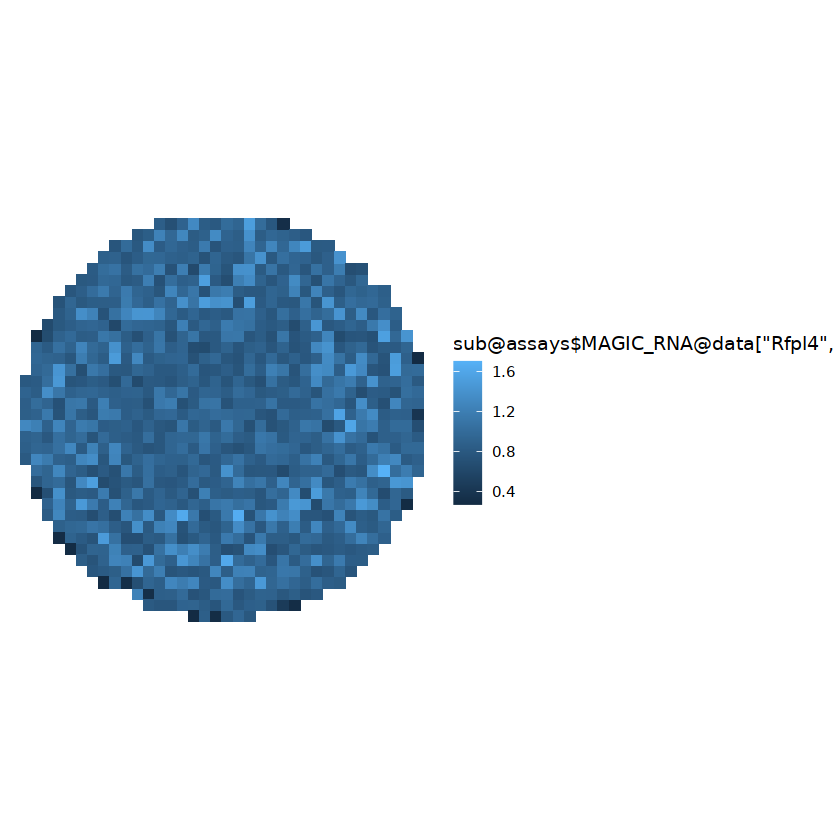

In [69]:
ggplot(sub@meta.data,aes(coor_x,coor_y,fill=sub@assays$MAGIC_RNA@data["Rfpl4",]))+geom_tile()+coord_fixed()+theme_void()

In [20]:
sub=subset(obj,subset=coor_x>1690 & coor_x<1740 & coor_y>1150 & coor_y<1200)

In [21]:
sub=magic(sub,genes = c(modules[[8]],modules[[10]]))

Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from magic_rna_ to magicrna_”


[1] "Added MAGIC output to MAGIC_RNA. To use it, pass assay='MAGIC_RNA' to downstream methods or set DefaultAssay(seurat_object) <- 'MAGIC_RNA'."


In [29]:
length(sub@assays$MAGIC_RNA["H1foo",])
nrow(sub@meta.data)

[1] 1034

[1] 1034

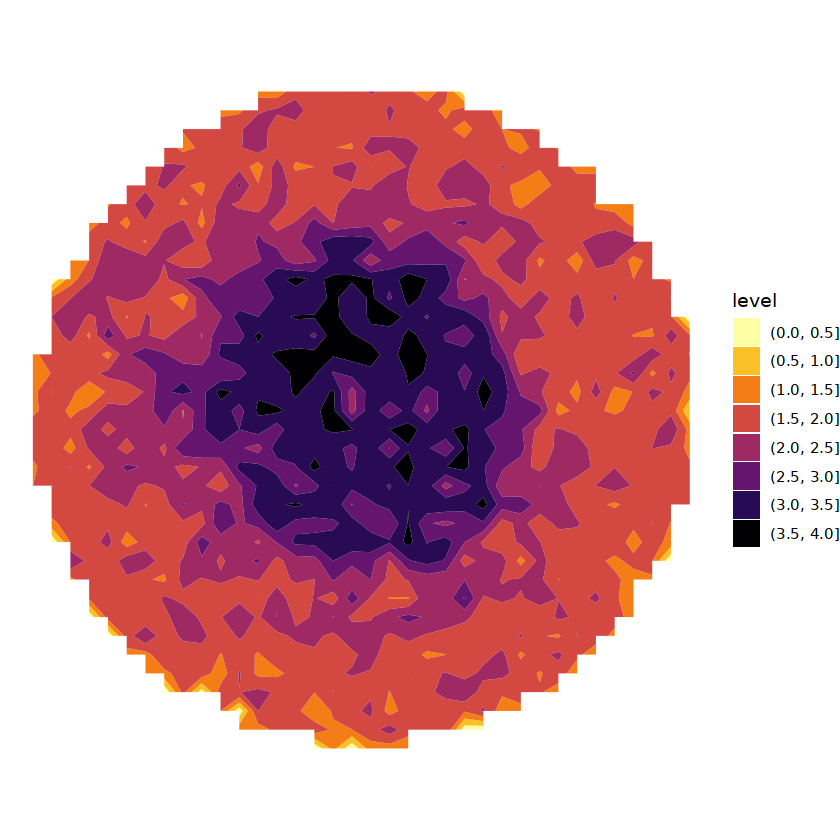

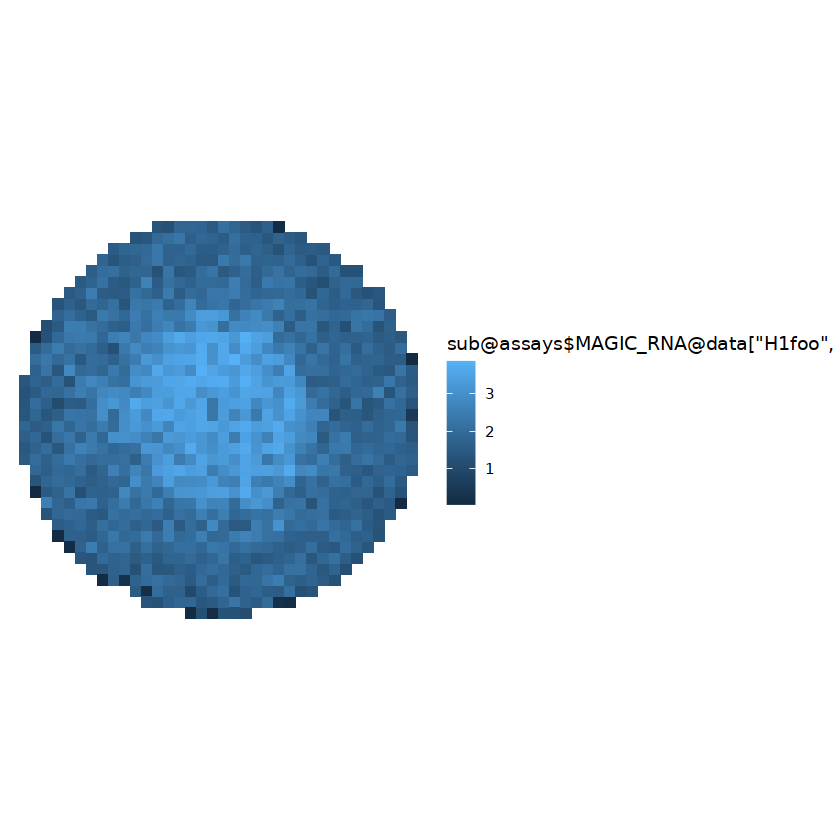

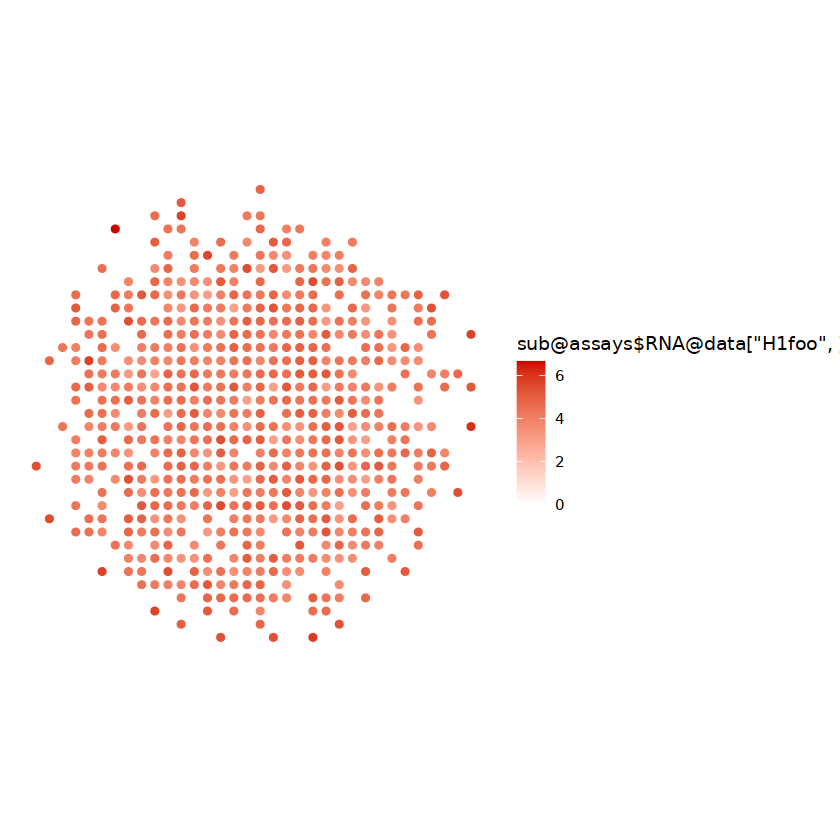

In [70]:
library(ggplot2)
ggplot(sub@meta.data,aes(coor_x,coor_y,z=sub@assays$MAGIC_RNA@data["H1foo",]))+geom_contour_filled(bins=8)+coord_fixed()+scale_fill_manual(values = viridis_pal(option = "B",direction = -1)(8))+theme_void()
ggplot(sub@meta.data,aes(coor_x,coor_y,fill=sub@assays$MAGIC_RNA@data["H1foo",]))+geom_tile()+coord_fixed()+theme_void()
ggplot(sub@meta.data,aes(coor_x,coor_y,color=sub@assays$RNA@data["H1foo",]))+geom_point()+coord_fixed()+theme_void()+scale_color_gradient2(low = "gray",high = "red3")


In [45]:
mean(mer$nFeature_RNA)

[1] 8972.003

Warning message:
“Removed 109673 rows containing non-finite values (`stat_contour_filled()`).”
Warning message:
“Removed 109673 rows containing non-finite values (`stat_contour_filled()`).”


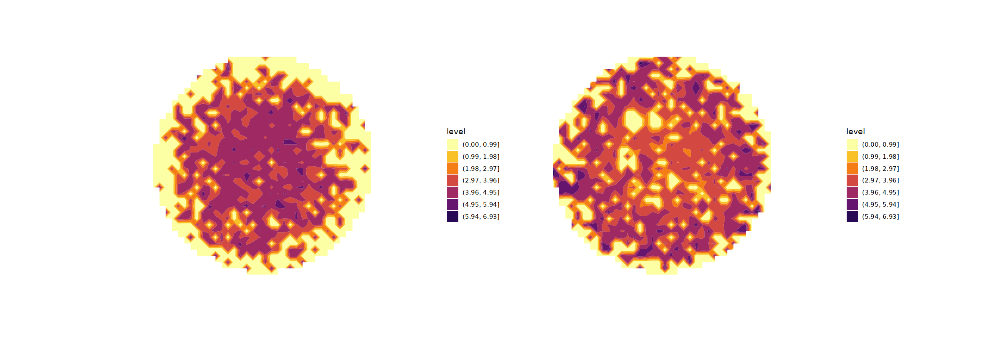

In [285]:
p1=ggplot(obj@meta.data,aes(coor_x,coor_y,z=obj@assays$RNA@data["H1foo",]))+geom_contour_filled(bins=10)+coord_fixed()+xlim(1690,1740)+ylim(1150,1200)+scale_fill_manual(values = viridis_pal(option = "B",direction = -1)(8))+theme_void()
p2=ggplot(obj@meta.data,aes(coor_x,coor_y,z=obj@assays$RNA@data["Zbed3",]))+geom_contour_filled(bins=10)+coord_fixed()+xlim(1690,1740)+ylim(1150,1200)+scale_fill_manual(values = viridis_pal(option = "B",direction = -1)(8))+theme_void()
p1|p2

Warning message:
“Removed 109673 rows containing non-finite values (`stat_contour_filled()`).”
Warning message:
“Removed 109673 rows containing non-finite values (`stat_contour_filled()`).”


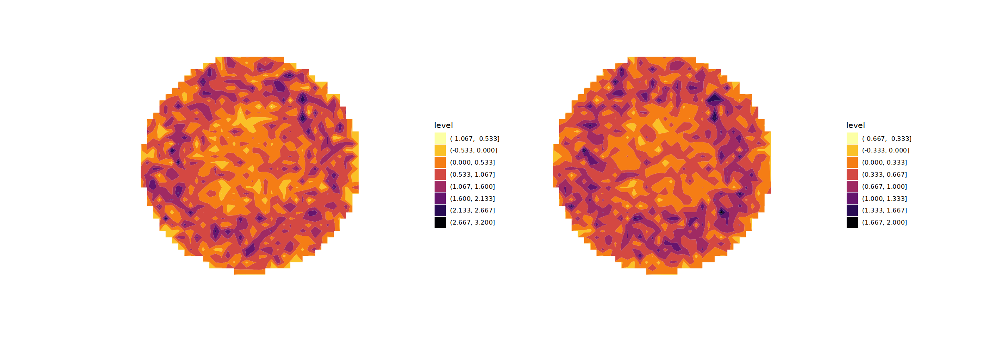

In [277]:
p=p1|p2
p

In [259]:
p=p1|p2
ggsave("Cluster8_tile.pdf",width = 8,height = 4,plot=p)

Warning message:
“Removed 109673 rows containing non-finite values (`stat_contour_filled()`).”
Warning message:
“Removed 109673 rows containing non-finite values (`stat_contour_filled()`).”


In [66]:
pdf("test.pdf")
apply(as.matrix(names(modules)),1,function(x){
ggplot(obj@meta.data,aes(coor_x,coor_y,fill=obj@meta.data[,x]))+geom_tile()+coord_fixed()+scale_fill_viridis_c(option = "B",direction = -1)+labs(title=x)
    }
      )
dev.off()

[[1]]

[[2]]

[[3]]

[[4]]

[[5]]

[[6]]

[[7]]

[[8]]

[[9]]

[[10]]

[[11]]

[[12]]

[[13]]

[[14]]

[[15]]

[[16]]

[[17]]

[[18]]

[[19]]

[[20]]

[[21]]

[[22]]

[[23]]

[[24]]

[[25]]

[[26]]

[[27]]

[[28]]

[[29]]

[[30]]

[[31]]

[[32]]

[[33]]

[[34]]

[[35]]

[[36]]

[[37]]

[[38]]

[[39]]

[[40]]

[[41]]

[[42]]

[[43]]

[[44]]

[[45]]

[[46]]

[[47]]

[[48]]

[[49]]

[[50]]

[[51]]

[[52]]

[[53]]

[[54]]

[[55]]

[[56]]

[[57]]

[[58]]

[[59]]

[[60]]

[[61]]

[[62]]

[[63]]

[[64]]

[[65]]

[[66]]

[[67]]

[[68]]

[[69]]

[[70]]

[[71]]

[[72]]

[[73]]

[[74]]

[[75]]

[[76]]

[[77]]

[[78]]

[[79]]

[[80]]


png 
  2

In [20]:
library(Matrix)

In [21]:
E5=readRDS("D01767E5_cluster.rds")
C1=readRDS("A03099C1/A03099C1.rds")
C5=readRDS("A03099C5/A03099C5.rds")
C3=readRDS("A03099C3/A03099C3.rds")
M8=readRDS("Y00309M8/Y00309M8.rds")

In [22]:
E5$sample="D01767E5"
C1$sample="A03099C1"
C5$sample="A03099C5"
C3$sample="A03099C3"
M8$sample="Y00309M8"

In [23]:
mer=merge(E5,list(C1,C5,C3,M8))

Warning message in CheckDuplicateCellNames(object.list = objects):
“Some cell names are duplicated across objects provided. Renaming to enforce unique cell names.”


In [28]:
mer=NormalizeData(mer,verbose = F)
mer=FindVariableFeatures(mer,verbose = F)
mer=ScaleData(mer,verbose = F)
mer=RunPCA(mer,verbose = F)
mer=RunHarmony(mer,group.by.vars = "sample")
mer=RunUMAP(mer,dims=1:20,verbose = F,reduction = 'harmony')
mer=FindNeighbors(mer,verbose = F,reduction = "harmony",dims = 1:20)
mer=FindClusters(mer,verbose = F)

Transposing data matrix

Harmony 1/10

Harmony 2/10

Harmony 3/10

Harmony 4/10

Harmony 5/10

Harmony 6/10

Harmony converged after 6 iterations

Warning message:
“Invalid name supplied, making object name syntactically valid. New object name is Seurat..ProjectDim.RNA.harmony; see ?make.names for more details on syntax validity”
Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”


In [57]:
markers=FindAllMarkers(mer)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9



In [59]:
markers$num=1:nrow(markers)
df=markers[markers$avg_log2FC>0,] %>% group_by(cluster) %>% top_n(10,wt=-num)
split(df$gene,df$cluster)

$`0`
 [1] "Zfp57"      "Cd164l2"    "Obox2"      "Obox1"      "Uchl1"     
 [6] "H1foo"      "Gadd45gip1" "Syce2"      "Tubb4b"     "Nsmce2"    

$`1`
 [1] "Adgrv1"        "Spag16"        "As3mt"         "Gm15728"      
 [5] "Catsperd"      "Adamts16"      "Susd4"         "3110009E18Rik"
 [9] "Gm20388"       "Tomm7"        

$`2`
 [1] "Bmp15"   "Klhl21"  "Golph3"  "Slc45a3" "Zfp280b" "Bnc1"    "Snai1"  
 [8] "Sirt1"   "Cd9"     "Dnmt1"  

$`3`
 [1] "Ube2g1"  "Rnf38"   "Glce"    "Mdm4"    "Tbc1d14" "Znrf2"   "Spry4"  
 [8] "Cnot6l"  "Birc3"   "Hivep1" 

$`4`
 [1] "Sec61b" "Dynll1" "Dppa5a" "Avpi1"  "Sugt1"  "Cox7a2" "Polr2j" "Sec61g"
 [9] "Serf2"  "Oas1h" 

$`5`
 [1] "Ms4a7"  "Aif1"   "Wfdc17" "C1qa"   "Trem2"  "Pf4"    "Mpeg1"  "Ccl9"  
 [9] "C1qc"   "Fcrls" 

$`6`
 [1] "Dnajb4"   "Rbbp7"    "March7"   "Lrp1b"    "AU022751" "Lrrfip1" 
 [7] "Fndc3a"   "C2cd5"    "Eps8"     "Hectd2"  

$`7`
 [1] "Clu"      "Ppic"     "Jun"      "Ier3"     "Igfbp2"   "P3h4"    
 [7] "Rcn1"     "Amotl2"   "Gpx7"     "Serpinh1"

$`8`
 [1] "Cnot3"   "Slbp"    "Dcp2"    "Riok1"   "Ermp1"   "Paip2b"  "Hpf1"   
 [8] "Rnf141"  "Trim60"  "Eif4e1b"

$`9`
 [1] "Pgc"     "Ctse"    "Chia1"   "Cd24a"   "Il31ra"  "Camk1d"  "Gm20594"
 [8] "Gphn"    "Gm42418" "Kpna1"

In [69]:

df=colorspace::hex2RGB(ggsci::pal_cosmic()(10))
df=df@coords*255
df=as.data.frame(df)
rownames(df)=0:9
df
write.csv(df,"cluster_color.csv")

,R,G,B
,<dbl>,<dbl>,<dbl>
0,46,42,43
1,207,78,156
2,140,87,162
3,53,141,185
4,130,88,31
5,47,80,158
6,229,97,76
7,151,161,167
8,61,168,115


In [70]:
write.csv(mer@meta.data,"meta.csv")

In [902]:
mer$annotation1=plyr::mapvalues(mer$seurat_clusters,from = c(0,1,2,3,4),to=c("GV1","GV3","GV2","M","GV4"))
mer$annotation2=plyr::mapvalues(mer$seurat_clusters,from = c(0,1,2,3,4),to=c("GV","GV","GV","M","GV"))
mer$annotation3=plyr::mapvalues(mer$seurat_clusters,from = c(0,1,2,3,4),to=c("GV1","GV2","GV1","M","GV2"))

In [80]:
sum(table(mer$seurat_clusters[mer$sample %in% c("A03099C3","A03099C5","A03099C3")]))

[1] 434

In [30]:
mer=subset(mer,subset=seurat_clusters %in% c(0:4,6,8))

In [31]:
mer=RunUMAP(mer,dims=1:20,verbose = F,reduction = 'harmony')
mer=FindNeighbors(mer,verbose = F,reduction = "harmony",dims = 1:20)
mer=FindClusters(mer,verbose = F,resolution = 0.5)

In [1]:
mer=readRDS("/mnt//workdir/Stereo-cell/review_202505/expand.merge.rds")

In [4]:
mer1=readRDS("/mnt//workdir/Stereo-cell/review_202505/merge.rds")

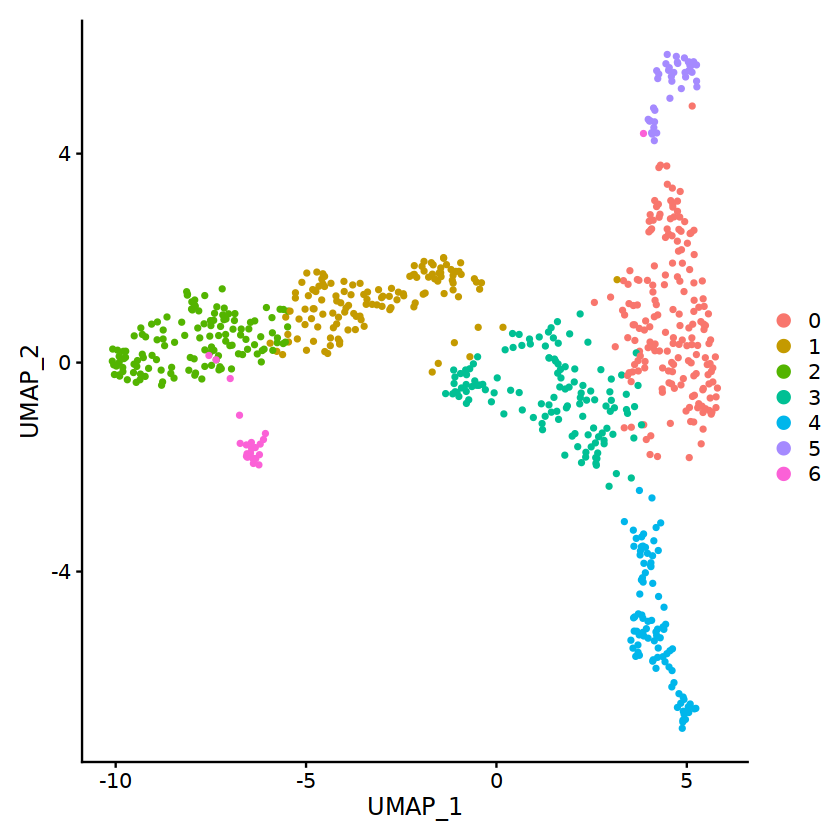

In [5]:
DimPlot(mer1)

In [7]:
mer1 
mer

An object of class Seurat 
24622 features across 719 samples within 1 assay 
Active assay: RNA (24622 features, 2000 variable features)
 3 dimensional reductions calculated: pca, harmony, umap

An object of class Seurat 
24876 features across 719 samples within 2 assays 
Active assay: regulon (254 features, 0 variable features)
 1 other assay present: RNA
 4 dimensional reductions calculated: pca, harmony, umap, dm

Attaching SeuratObject



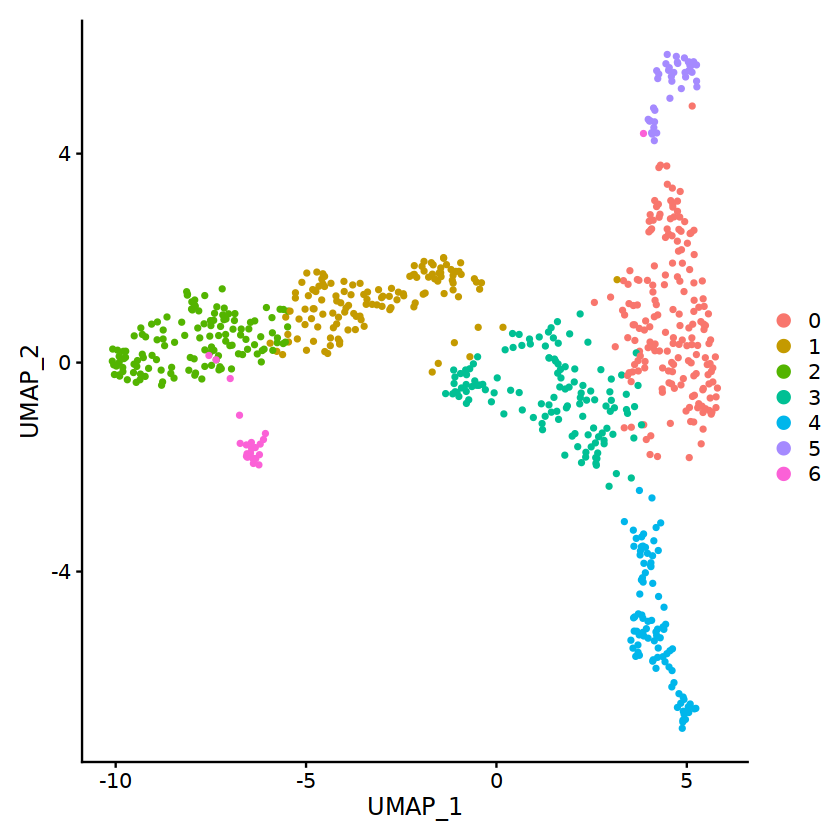

In [3]:
library(Seurat)
DimPlot(mer)

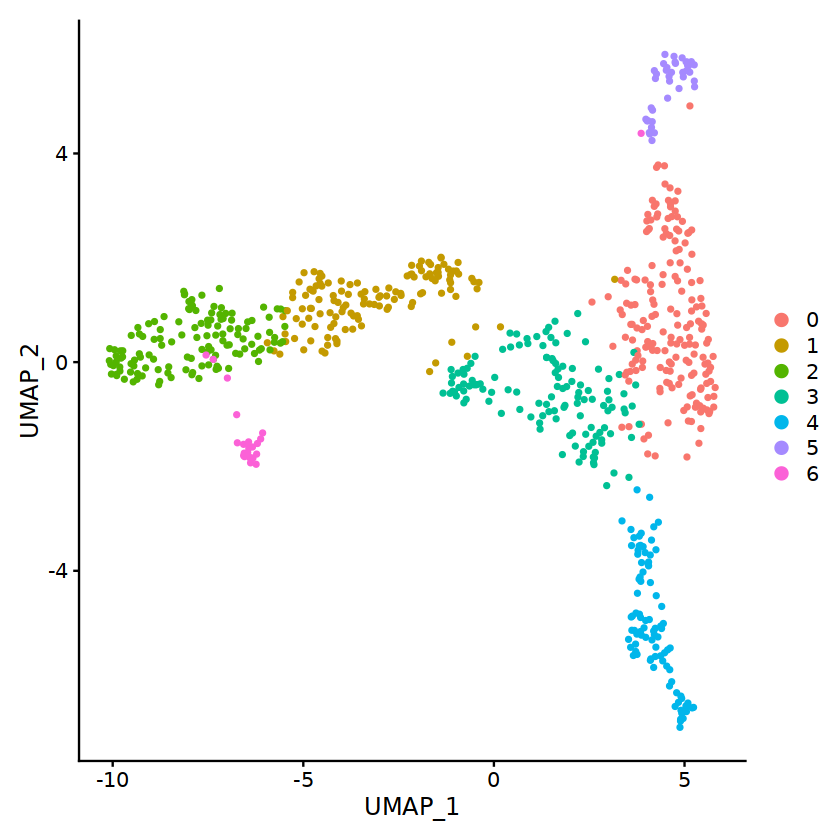

In [32]:
DimPlot(mer)

In [36]:
split(test$gene,test$`avg_log2FC > 0`)

$`FALSE`
 [1] "Ralgps2" "Rab14"   "Fastkd1" "Ddb2"    "Api5"    "Kif18a"  "Zswim3" 
 [8] "E2f5"    "Sclt1"   "Siah2"   "Tiparp"  "Trim59"  "Vps72"   "Golph3l"
[15] "Cept1"  

$`TRUE`
 [1] "Ss18l2"  "Gstt2"   "Prss12"  "Chchd7"  "Rps9"    "Rps13"   "Dscc1"  
 [8] "Rps4x"   "Nudt5"   "Nek6"    "Psmb7"   "Psmb4"   "Rps20"   "Prkrip1"
[15] "Emg1"

In [35]:
mer=AddModuleScore(mer,features = split(test$gene,test$`avg_log2FC > 0`))

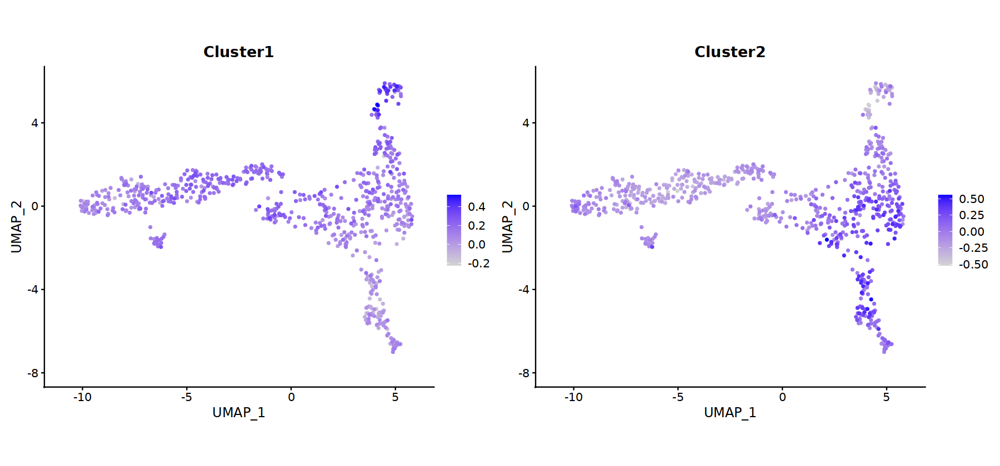

In [37]:
options(repr.plot.width=15)
FeaturePlot(mer,"Cluster1",order=T)+coord_fixed()|FeaturePlot(mer,"Cluster2",order=T)+coord_fixed()

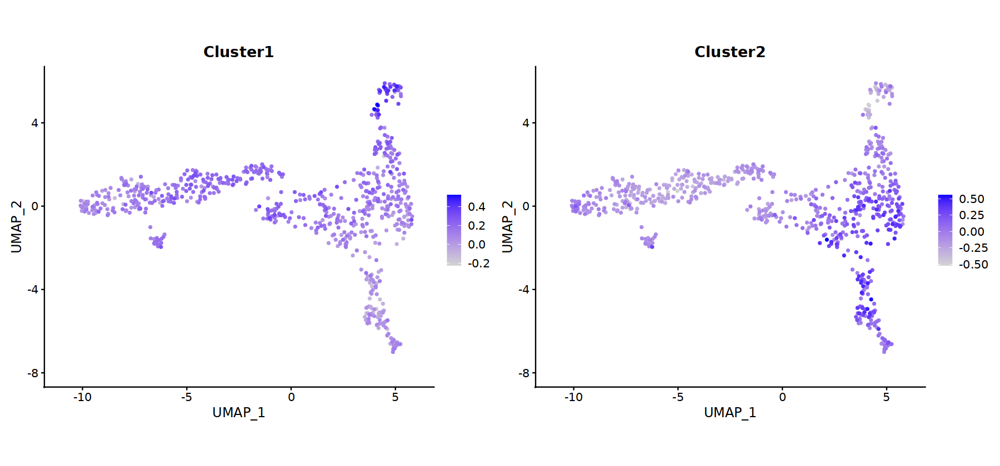

In [37]:
options(repr.plot.width=15)
FeaturePlot(mer,"Cluster1",order=T)+coord_fixed()|FeaturePlot(mer,"Cluster2",order=T)+coord_fixed()

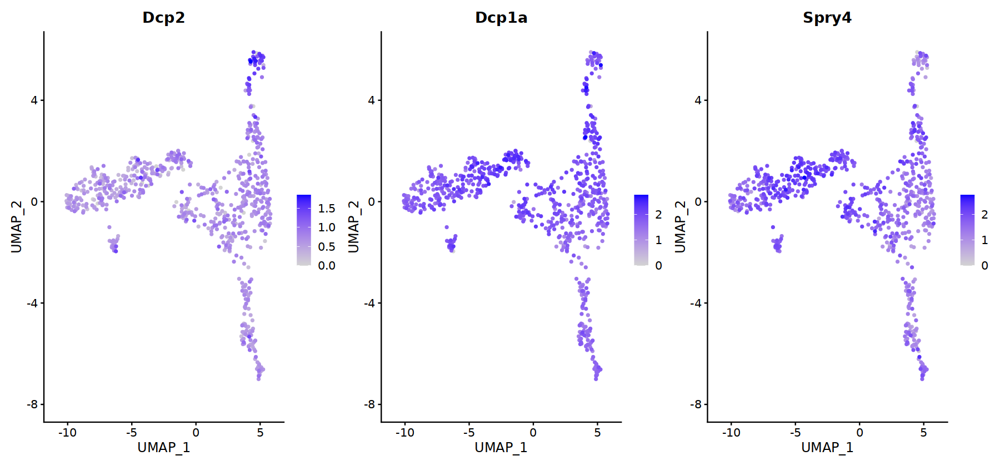

In [38]:
FeaturePlot(mer,"Dcp2",order=T)|FeaturePlot(mer,"Dcp1a",order=T)|FeaturePlot(mer,"Spry4",order=T)

In [133]:
mer

An object of class Seurat 
24622 features across 719 samples within 1 assay 
Active assay: RNA (24622 features, 2000 variable features)
 3 dimensional reductions calculated: pca, harmony, umap

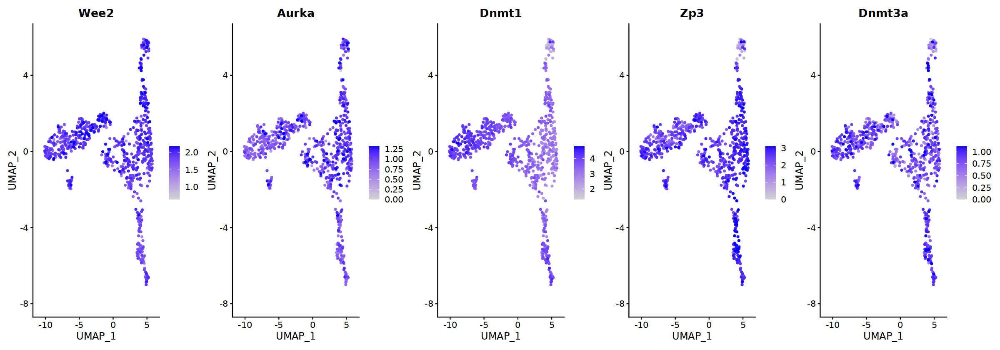

In [183]:
FeaturePlot(mer,"Wee2",order=T,max.cutoff = "q95")|FeaturePlot(mer,"Aurka",order=T,max.cutoff = "q95")|FeaturePlot(mer,"Dnmt1",order=T)|FeaturePlot(mer,"Zp3",order=T,max.cutoff = "q95")|FeaturePlot(mer,"Dnmt3a",order=T,max.cutoff = "q95")

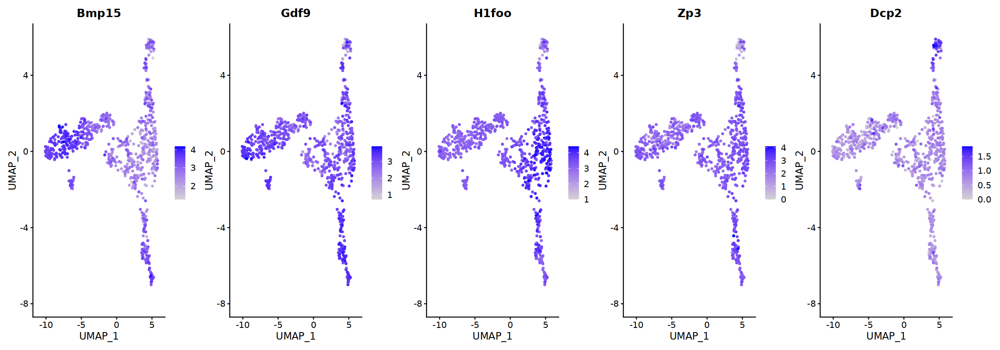

In [176]:
FeaturePlot(mer,"Bmp15",order=T)|FeaturePlot(mer,"Gdf9",order=T)|FeaturePlot(mer,"H1foo",order=T)|FeaturePlot(mer,"Zp3",order=T)|FeaturePlot(mer,"Dcp2",order=T)

In [179]:
p1=FeaturePlot(mer,"Bmp15",order=T,pt.size=1.5)+coord_fixed(ratio = 1.4)+scale_color_gradientn(colours = c("lightgray","red"))
p2=FeaturePlot(mer,"Gdf9",order=T,pt.size=1.5)+coord_fixed(ratio = 1.4)+scale_color_gradientn(colours = c("lightgray","red"))
p3=FeaturePlot(mer,"H1foo",order=T,pt.size=1.5)+coord_fixed(ratio = 1.4)+scale_color_gradientn(colours = c("lightgray","red"))
p4=FeaturePlot(mer,"Dcp2",order=T,pt.size=1.5)+coord_fixed(ratio = 1.4)+scale_color_gradientn(colours = c("lightgray","red"))
p=(p1|p2)/(p3|p4)
ggsave("FeaturePlot.pdf",height=10,width = 10,plot=p)

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


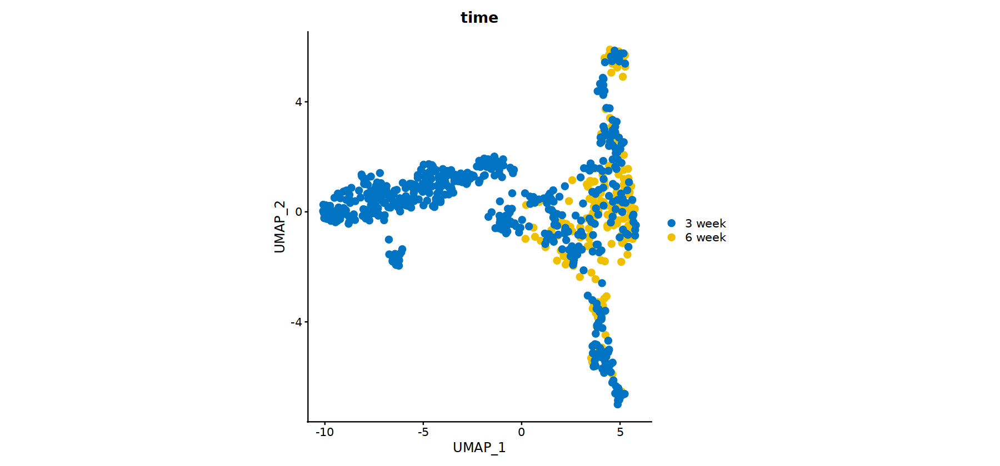

In [42]:
DimPlot(mer,pt.size = 3,label=F,group.by = "time")+coord_fixed(ratio = 1.4)+ggsci::scale_color_jco()

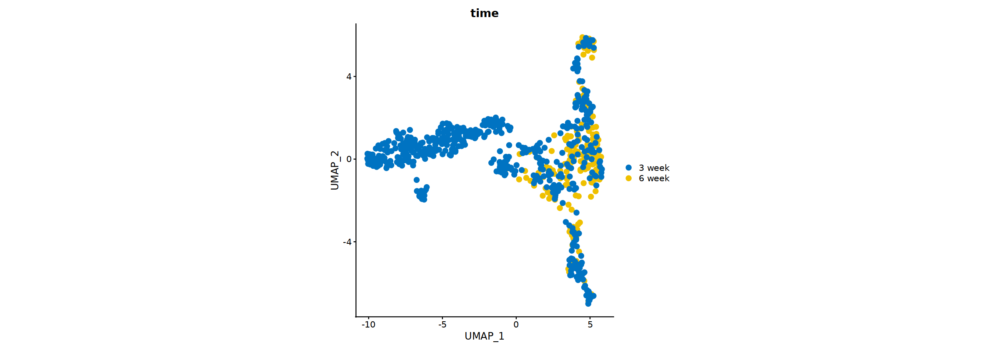

In [194]:
p=DimPlot(mer,pt.size = 3,label=F,group.by = "time")+coord_fixed(ratio = 1.4)+ggsci::scale_color_jco()
p
ggsave("DimPlot_time.pdf",height=5,width = 5,plot=p)

In [39]:
p=FeaturePlot(mer,"Cluster1",order=T)+coord_fixed(ratio = 1.4)+scale_color_viridis_c(option = "B")|FeaturePlot(mer,"Cluster2",order=T)+coord_fixed(ratio = 1.4)+scale_color_viridis_c(option = "B")
ggsave("ModuleScore.pdf",height=5,width = 10,plot=p)

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


In [174]:
p=DimPlot(mer,pt.size = 3,label=T)+coord_fixed(ratio = 1.4)+ggsci::scale_color_cosmic()
ggsave("DimPlot.pdf",height=5,width = 5,plot=p)

In [21]:
mer$stage="Growing Oocyte"
mer$stage[mer$seurat_clusters %in% c(3,4)]="GV"
mer$stage[mer$seurat_clusters %in% c(0)]="GVBD"
mer$stage[mer$seurat_clusters %in% c(5)]="M"

In [22]:
Idents(mer)=mer$stage

In [23]:
markers=FindAllMarkers(mer)

Calculating cluster M

Calculating cluster GVBD

Calculating cluster GV

Calculating cluster Growing Oocyte



In [24]:
write.csv(markers,"Oocyte.marker.csv")

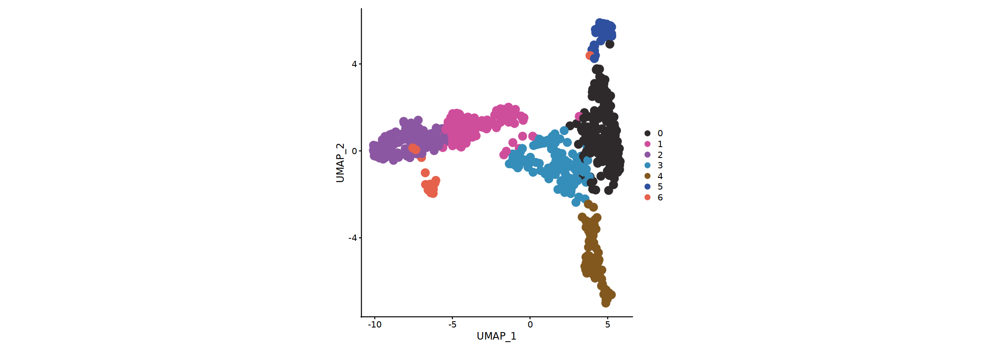

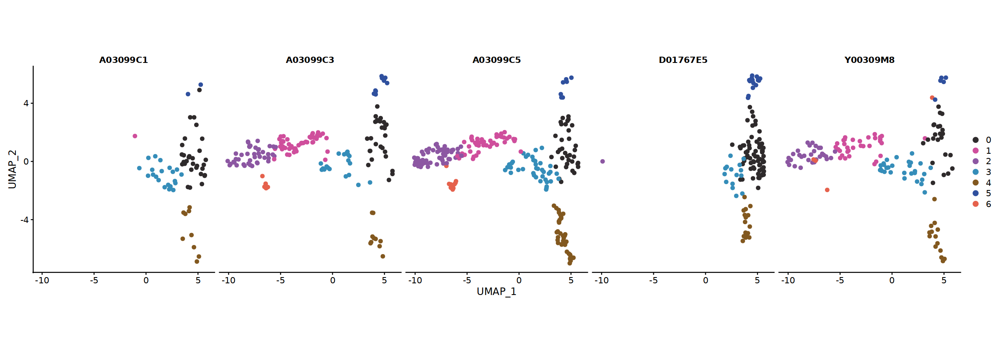

In [44]:
options(repr.plot.width=20)
DimPlot(mer,pt.size = 5)+coord_fixed(ratio = 1.4)+ggsci::scale_color_cosmic()
DimPlot(mer,pt.size = 2,split.by="sample")+coord_fixed(ratio = 1.4)+ggsci::scale_color_cosmic()

In [85]:
mer$time="3 week"
mer$time[mer$sample %in% c("A03099C1","D01767E5")]="6 week"

In [118]:
markers=FindAllMarkers(mer)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6



In [86]:
table(mer$time)


3 week 6 week 
   540    179 

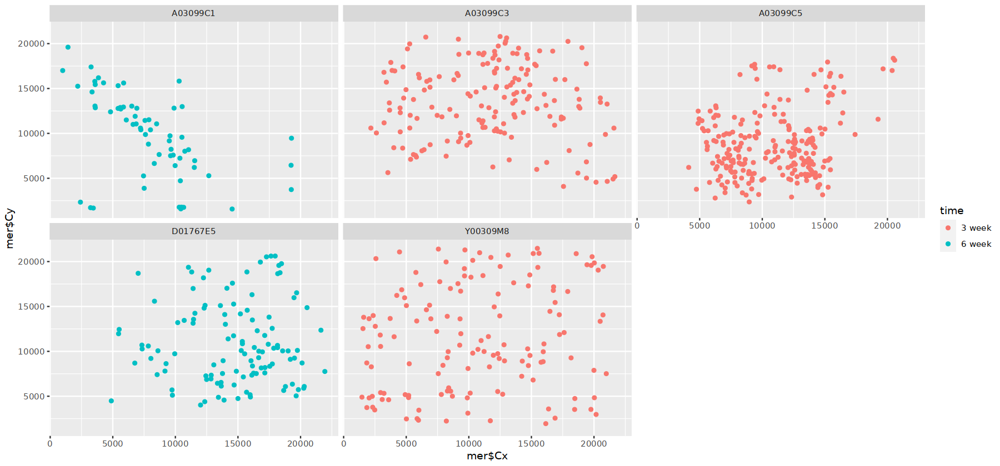

In [87]:
ggplot(mer@meta.data,aes(x=mer$Cx,y=mer$Cy,color=time))+geom_point()+facet_wrap(sample~.)

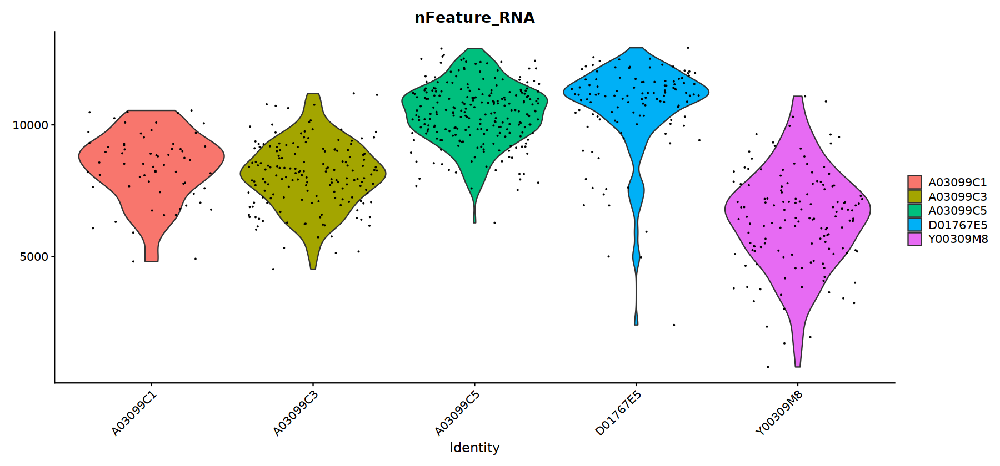

In [88]:
VlnPlot(mer,"nFeature_RNA",group.by="sample")

In [89]:
obj=readRDS("/hwfssz1/ST_SUPERCELLS/P22Z10200N0661/haoshijie/FIGURE3/02.analysis_bone_marrow/A03779D2.anno.rds")

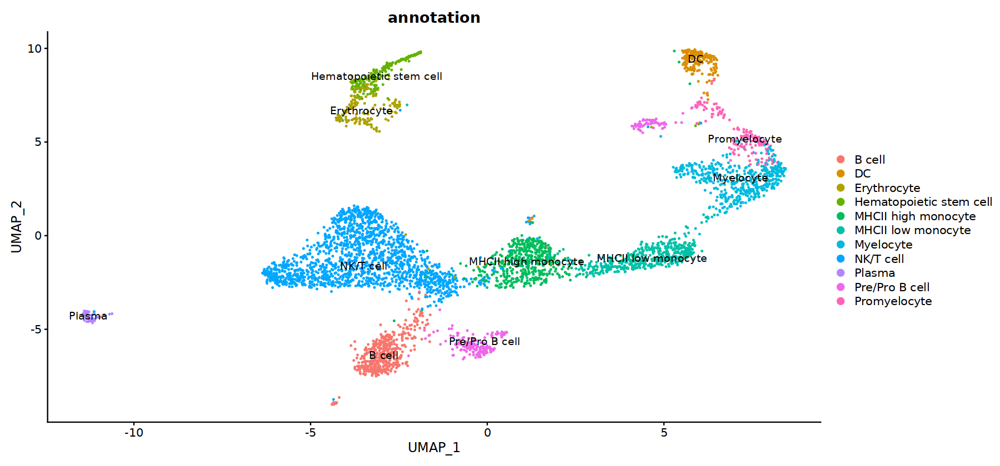

In [95]:
DimPlot(obj,group.by = "annotation",label=T)

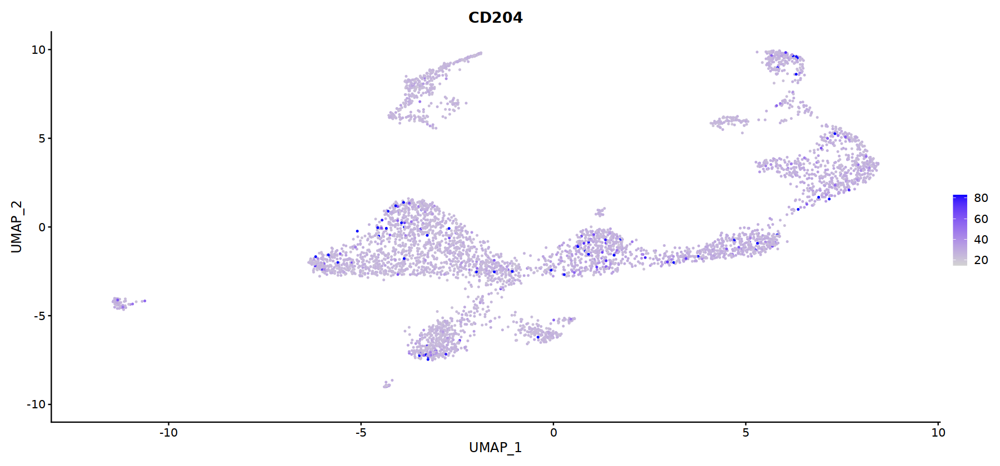

In [104]:
FeaturePlot(obj,"CD204",max.cutoff="q99")

In [ ]:
obj$

In [40]:
saveRDS(mer,"merge.rds")

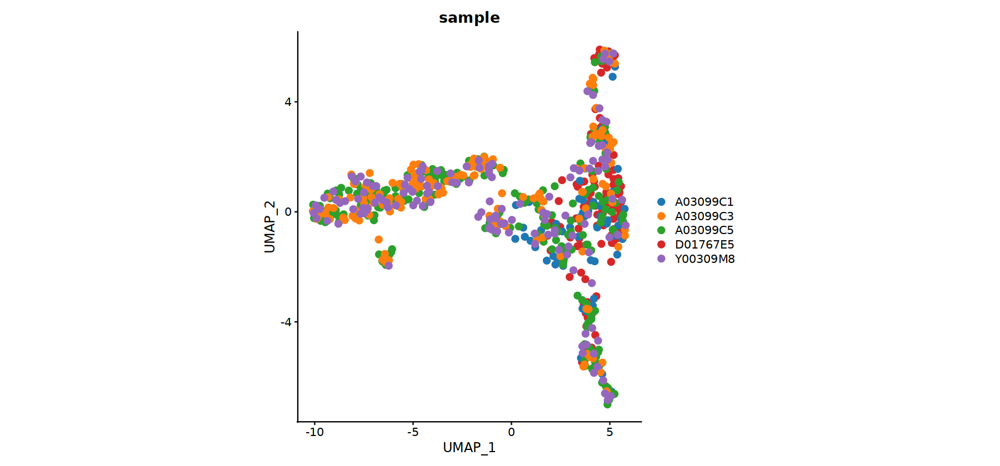

In [39]:
DimPlot(mer,group.by = "sample",pt.size = 3)+coord_fixed(ratio = 1.4)+ggsci::scale_color_d3()

In [158]:
mer=AddModuleScore(mer,features = split(test$gene,test$`avg_log2FC > 0`))

In [139]:
markers=FindAllMarkers(mer)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6



In [170]:
head(mer@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,area,perimeter,Cx,Cy,AR,solidity,roundness,circularity,cell,scDblFinder.class,RNA_snn_res.0.8,seurat_clusters,sample,RNA_snn_res.0.4,RNA_snn_res.0.5,Cluster1,Cluster2
,<chr>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<fct>,<fct>,<chr>,<fct>,<fct>,<dbl>,<dbl>
C135_1,SeuratProject,28061,5009,24633,586.1564,4882.5,4482.5,1,0.9945093,0.9898911,0.9009488,135,singlet,8,5,D01767E5,5,5,0.21789067,-0.14457587
C48_1,SeuratProject,164748,10488,77007,1038.7737,5462.5,11961.5,1,0.9962740,0.9944456,0.8968053,48,doublet,1,0,D01767E5,0,0,0.10539866,0.11438617
C44_1,SeuratProject,262514,11302,84552,1087.0580,5510.0,12441.0,1,0.9965584,0.9945857,0.8991421,44,singlet,0,0,D01767E5,0,0,0.07719979,0.19506891
C86_1,SeuratProject,76344,7608,59457,912.5483,6759.5,8692.5,1,0.9955794,0.9937907,0.8972245,86,singlet,8,5,D01767E5,5,5,0.23678410,-0.30117535
C13_1,SeuratProject,210683,10983,65665,959.1758,7027.5,18692.5,1,0.9960561,0.9941412,0.8969070,13,singlet,5,0,D01767E5,0,0,0.10754856,0.04674901
C64_1,SeuratProject,342588,12109,99616,1180.3128,7346.0,10270.0,1,0.9967182,0.9951826,0.8985551,64,doublet,0,0,D01767E5,0,0,0.04927185,0.12198378


In [171]:
write.csv(mer@meta.data,"meta.csv")

In [140]:
markers$num=1:nrow(markers)
df=markers[markers$avg_log2FC>0,] %>% group_by(cluster) %>% top_n(10,wt=-num)
split(df$gene,df$cluster)

$`0`
 [1] "Zfp57"      "Cd164l2"    "Obox2"      "Obox1"      "Gadd45gip1"
 [6] "H1foo"      "Nsmce2"     "Uchl1"      "Psmd4"      "Syce2"     

$`1`
 [1] "Ube2g1"  "Glce"    "Fip1l1"  "Atad1"   "Spry4"   "Alg10b"  "Mdm4"   
 [8] "Lrrfip1" "Ireb2"   "Dnajb4" 

$`2`
 [1] "Bmp15"   "Golph3"  "Slc45a3" "Zfp280b" "Klhl21"  "Sirt1"   "Mex3c"  
 [8] "Dnmt1"   "Bnc1"    "Yrdc"   

$`3`
 [1] "Adgrv1"        "As3mt"         "Gm15728"       "Spag16"       
 [5] "Adamts16"      "Susd4"         "Catsperd"      "Tomm7"        
 [9] "Gm20388"       "3110009E18Rik"

$`4`
 [1] "Sec61b" "Dynll1" "Dppa5a" "Rps19"  "Avpi1"  "Cox7a2" "Sugt1"  "Rplp1" 
 [9] "Cops9"  "Rps14" 

$`5`
 [1] "Cnot3"  "Slbp"   "Dcp2"   "Paip2b" "Ermp1"  "Riok1"  "Trim60" "Rnf141"
 [9] "Cdk8"   "Chd4"  

$`6`
 [1] "Kcnip4"  "Trpm7"   "Atp6v1h" "Kbtbd7"  "Matr3"   "Fhit"    "Gm10719"
 [8] "Rspo2"   "Pls1"    "Rest"

In [270]:
markers$num=1:nrow(markers)
df=markers[markers$avg_log2FC>0,] %>% group_by(cluster) %>% top_n(20,wt=-num)
split(df$gene,df$cluster)

$`0`
 [1] "Zfp57"      "Cd164l2"    "Obox2"      "Obox1"      "Gadd45gip1"
 [6] "H1foo"      "Nsmce2"     "Uchl1"      "Psmd4"      "Syce2"     
[11] "Tubb4b"     "Dclre1a"    "Foxr1"      "Mrnip"      "Oser1"     
[16] "Psmb7"      "Tuba3a"     "Pfdn1"      "Gm1070"     "Map3k6"    

$`1`
 [1] "Ube2g1"  "Glce"    "Fip1l1"  "Atad1"   "Spry4"   "Alg10b"  "Mdm4"   
 [8] "Lrrfip1" "Ireb2"   "Dnajb4"  "Amfr"    "Bmi1"    "Nfxl1"   "Dnajc21"
[15] "March7"  "Flcn"    "Cnot6l"  "Akirin2" "Hivep1"  "Zfp750" 

$`2`
 [1] "Bmp15"   "Golph3"  "Slc45a3" "Zfp280b" "Klhl21"  "Sirt1"   "Mex3c"  
 [8] "Dnmt1"   "Bnc1"    "Yrdc"    "Cd9"     "Adam10"  "Wee1"    "Furin"  
[15] "Snai1"   "Ak4"     "Zmym5"   "Fbxl14"  "Rcc2"    "Atxn1l" 

$`3`
 [1] "Adgrv1"        "As3mt"         "Gm15728"       "Spag16"       
 [5] "Adamts16"      "Susd4"         "Catsperd"      "Tomm7"        
 [9] "Gm20388"       "3110009E18Rik" "Slirp"         "Gm44511"      
[13] "Gm36307"       "Gm31816"       "Hist1h1a"      "Smim11"       
[17] "Mrps18c"       "Chchd3"        "Gabrb3"        "Rps27l"       

$`4`
 [1] "Sec61b" "Dynll1" "Dppa5a" "Rps19"  "Avpi1"  "Cox7a2" "Sugt1"  "Rplp1" 
 [9] "Cops9"  "Rps14"  "Sec61g" "Serf2"  "Polr2j" "Usmg5"  "Uqcr10" "Cox17" 
[17] "Rps20"  "Rps29"  "Oas1h"  "Rps13" 

$`5`
 [1] "Cnot3"         "Slbp"          "Dcp2"          "Paip2b"       
 [5] "Ermp1"         "Riok1"         "Trim60"        "Rnf141"       
 [9] "Cdk8"          "Chd4"          "Fam133b"       "4933427D06Rik"
[13] "Tbl1xr1"       "Eif4e1b"       "Hpf1"          "Btg4"         
[17] "Eif4a1"        "Nexn"          "Smarca2"       "Stard7"       

$`6`
 [1] "Kcnip4"        "Trpm7"         "Atp6v1h"       "Kbtbd7"       
 [5] "Matr3"         "Fhit"          "Gm10719"       "Rspo2"        
 [9] "Pls1"          "Rest"          "Gdf9"          "Armc1"        
[13] "4930528G23Rik" "Cdk12"         "Ormdl1"        "Lmbrd2"       
[17] "Far1"          "Nbeal1"        "Mob1b"         "Uba6"

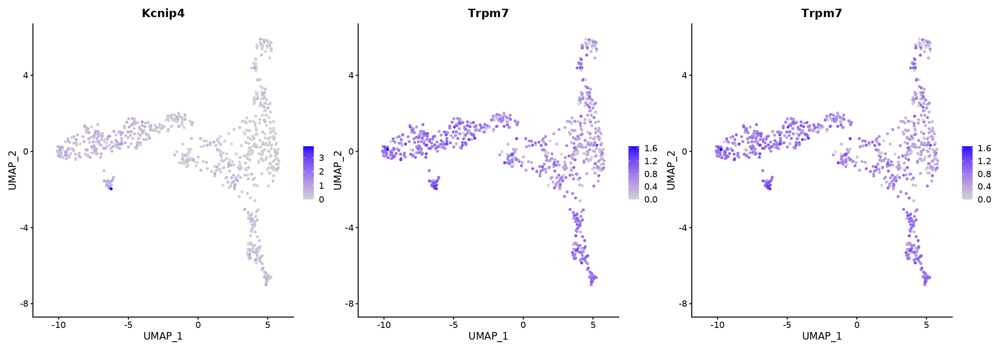

In [145]:
FeaturePlot(mer,features = "Kcnip4") | FeaturePlot(mer,features = "Trpm7") | FeaturePlot(mer,features = "Trpm7")

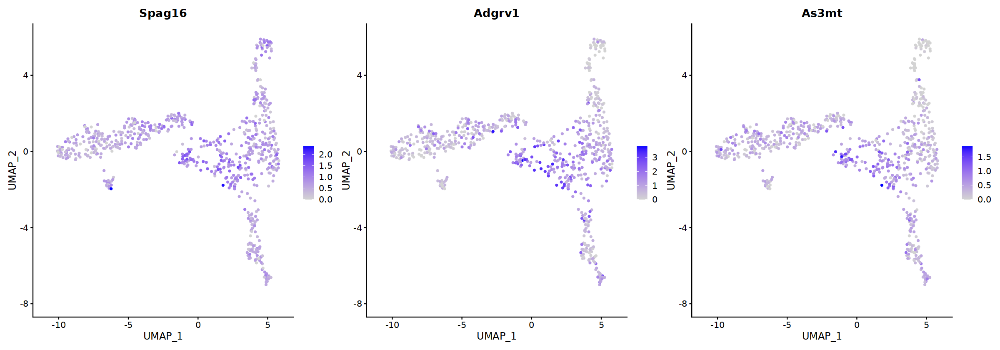

In [143]:
FeaturePlot(mer,features = "Spag16") | FeaturePlot(mer,features = "Adgrv1") | FeaturePlot(mer,features = "As3mt")

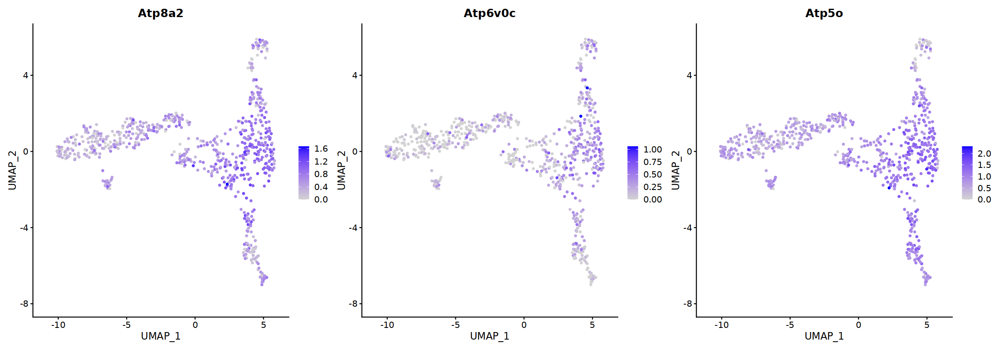

In [154]:
FeaturePlot(mer,features = "Atp8a2") | FeaturePlot(mer,features = "Atp6v0c") | FeaturePlot(mer,features = "Atp5o")

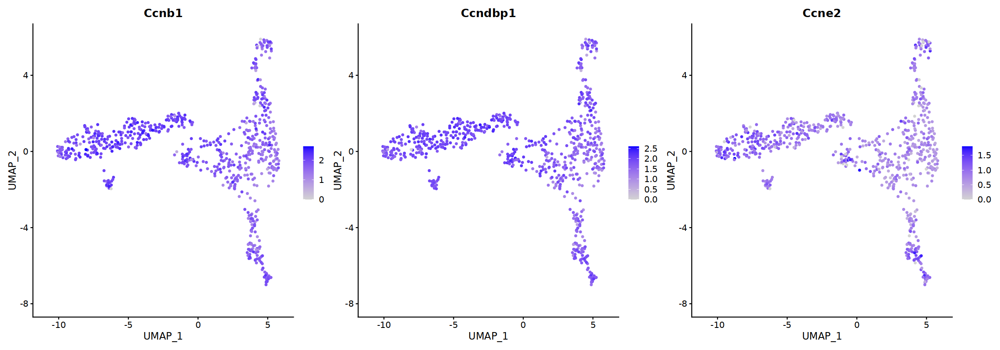

In [160]:
FeaturePlot(mer,features = "Ccnb1") | FeaturePlot(mer,features = "Ccndbp1") | FeaturePlot(mer,features = "Ccne2")

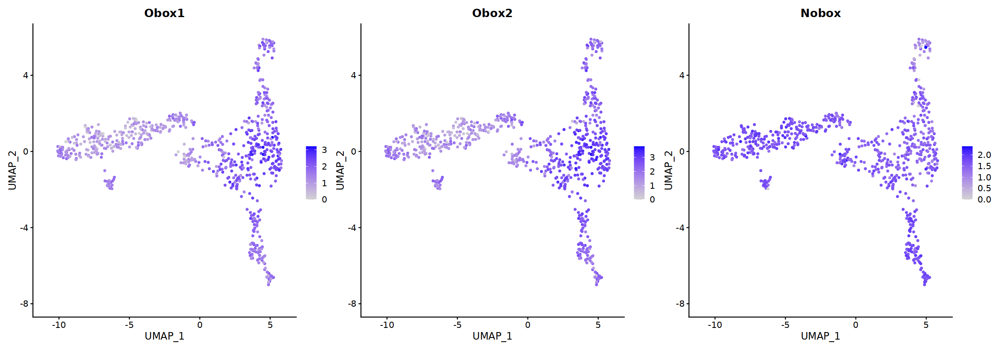

In [144]:
FeaturePlot(mer,features = "Obox1") | FeaturePlot(mer,features = "Obox2") | FeaturePlot(mer,features = "Nobox")

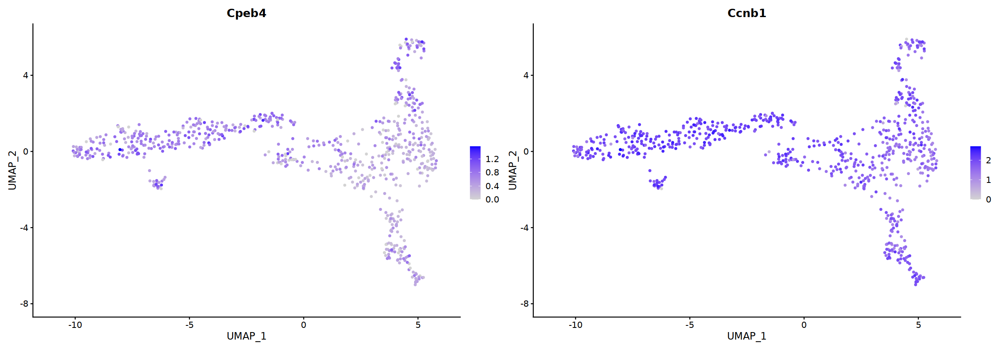

In [269]:
FeaturePlot(mer,features = "Cpeb4") | FeaturePlot(mer,features = "Ccnb1") | FeaturePlot(mer,features = "Thrl4")

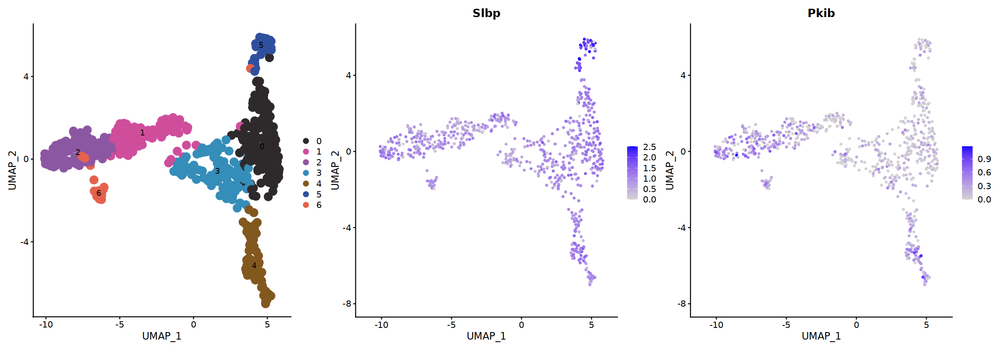

In [135]:
options(repr.plot.width=20)
DimPlot(mer,pt.size = 5,label=T)+coord_fixed(ratio = 1.4)+ggsci::scale_color_cosmic() + FeaturePlot(mer,features = "Slbp")+ FeaturePlot(mer,features = "Pkib")

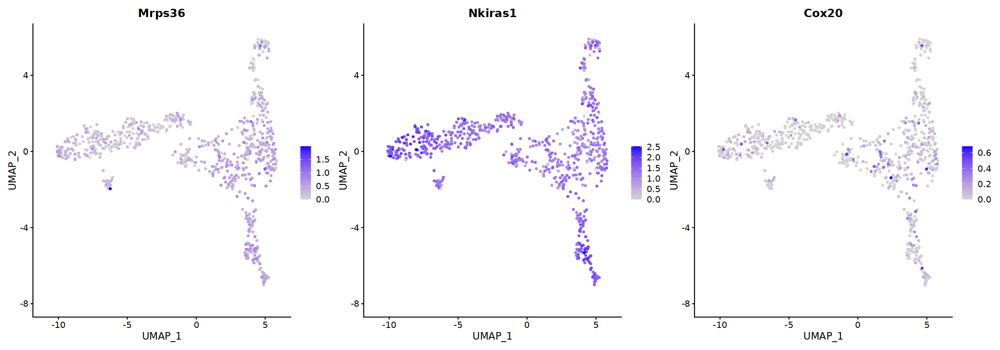

In [138]:
FeaturePlot(mer,features = "Mrps36")| FeaturePlot(mer,features = "Nkiras1")| FeaturePlot(mer,features = "Cox20")

In [169]:
FeaturePlot(mer,features = "Bub3",order=T) |FeaturePlot(mer,features = "Bub1b",order=T)|FeaturePlot(mer,features = "Tubb8b",order=T)

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Tubb8b”


ERROR: Error: None of the requested features were found: Tubb8b in slot data


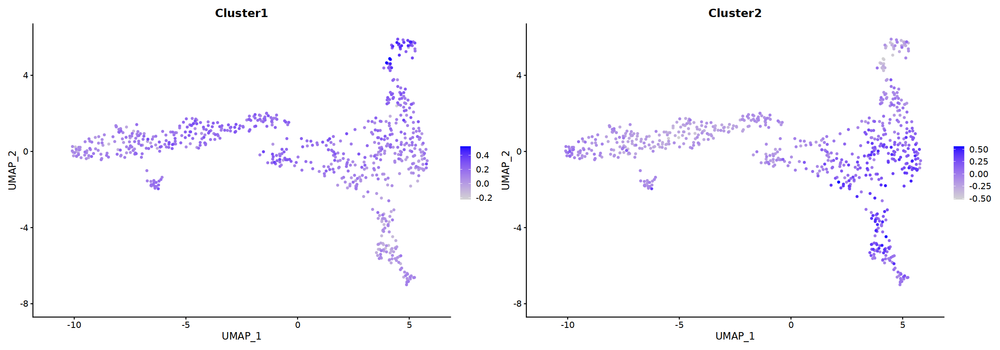

In [163]:
FeaturePlot(mer,features = "Cluster1",order=T) |FeaturePlot(mer,features = "Cluster2",order=T)

In [256]:
mer=AddModuleScore(mer,features = split(test1$gene,test1$cluster),name = "Growth")

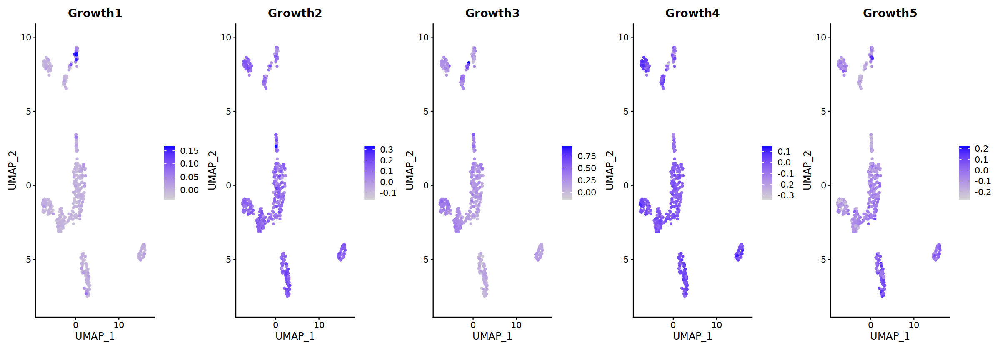

In [257]:
FeaturePlot(mer,features = "Growth1",order=T)|FeaturePlot(mer,features = "Growth2")|FeaturePlot(mer,features = "Growth3")|FeaturePlot(mer,features = "Growth4")|FeaturePlot(mer,features = "Growth5")

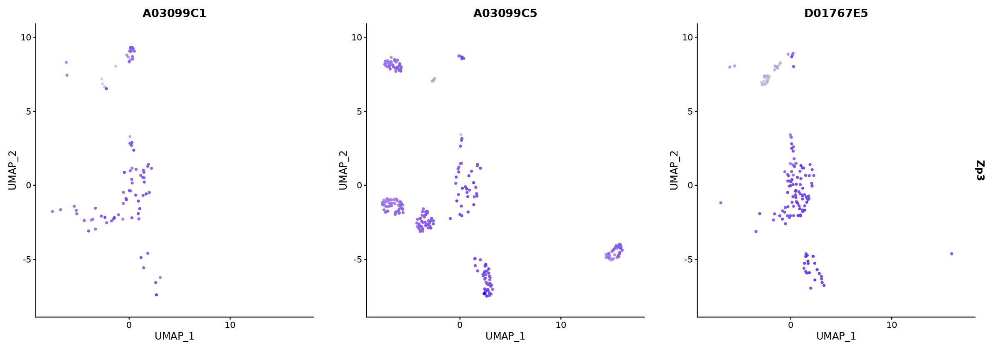

In [263]:
FeaturePlot(mer,features = "Zp3",order=T,split.by="sample")

In [163]:
markers2$num=1:nrow(markers2)
library(dplyr)
test=markers2 %>% group_by(cluster) %>% top_n(20,wt=-num)
split(test$gene,test$cluster)

$`0`
 [1] "Obox2"   "Zfp57"   "Cd164l2" "H1foo"   "Tuba3a"  "Obox1"   "Gm1070" 
 [8] "Izumo1r" "Ccdc69"  "Oser1"   "Stx5a"   "Fam46c"  "Crabp2"  "Smagp"  
[15] "Cpsf4l"  "Mos"     "Syce2"   "Psmd4"   "Drap1"   "Grem1"  

$`1`
 [1] "Sec61b"        "Dppa5a"        "Avpi1"         "Sugt1"        
 [5] "Ldhc"          "Haus4"         "Pcbd2"         "Dynll1"       
 [9] "Gtf2a1l"       "Ccno"          "Serf2"         "Pcca"         
[13] "2010107E04Rik" "Naa20"         "Gdf9"          "Astl"         
[17] "Tubb2a"        "Cox7a2"        "Ndufb2"        "Ndufa1"       

$`2`
 [1] "Spag16"        "Gm45609"       "As3mt"         "9130015A21Rik"
 [5] "Susd4"         "Adamts16"      "Adgrv1"        "Gm15728"      
 [9] "Gm44511"       "Gabrb3"        "Slirp"         "Chchd3"       
[13] "Catsperd"      "Rap1gap"       "Clec18a"       "Hmgb2"        
[17] "AL589670.4"    "Gm31816"       "Mrps31"        "Plac8"        

$`3`
 [1] "Lrrfip1"       "Znrf2"         "Hmgb2"         "Depdc7"       
 [5] "Plat"          "Abcb1b"        "Rfpl4"         "Glce"         
 [9] "Dnajb4"        "C230088H06Rik" "Alg10b"        "Pcgf6"        
[13] "Kremen1"       "Bmi1"          "E330034G19Rik" "Dnajc21"      
[17] "Spry4"         "Kdm6a"         "Lrp1b"         "Patz1"        

$`4`
 [1] "Ccdc6"    "Rest"     "Setd2"    "Phf13"    "Rif1"     "Spry4"   
 [7] "Nin"      "Foxj3"    "Mn1"      "Furin"    "Nav3"     "Deptor"  
[13] "Cdc42se2" "Satb1"    "Kmt2c"    "Arid2"    "Ppp1r15b" "Inpp4a"  
[19] "Gtf2a1"   "Fam53c"  

$`5`
 [1] "Mblac2"   "Snai1"    "Bnc1"     "Klhl21"   "Mob1a"    "Traf3ip1"
 [7] "Tmem30b"  "Bmp15"    "Adam10"   "Pikfyve"  "Zmym5"    "Fam117a" 
[13] "Tob1"     "Tob2"     "Hsd17b7"  "Zfp280b"  "Golph3"   "Csrnp1"  
[19] "Zxdb"     "Zfp503"  

$`6`
 [1] "P3h4"     "Ier3"     "Igfbp2"   "Jun"      "Hsd17b11" "Nr4a1"   
 [7] "Kazald1"  "Psme1"    "Apoa1"    "Rgcc"     "Adamts1"  "Ihh"     
[13] "Prps2"    "Serpinh1" "Clu"      "Pla2g4a"  "Nnat"     "Fundc2"  
[19] "Ucp2"     "Gatm"    

$`7`
 [1] "Wfdc17"     "Eif4a1"     "Slbp"       "Rps12"      "Trim60"    
 [6] "Metap2"     "Btg4"       "Gm42418"    "Epb41l4aos" "Ppp1r8"    
[11] "Cnot3"      "Sms"        "AA545190"   "Dcp2"       "Tpd52"     
[16] "Rcc1"       "Zcchc10"    "C1qc"       "Cfl2"       "Swi5"

In [870]:
marker=FindMarkers(mer,`ident.1` = "GV",group.by = "annotation2")

In [1377]:
marker=marker[ marker$p_val_adj<0.01, ]
test1=split(rownames(marker),marker$avg_log2FC>0)

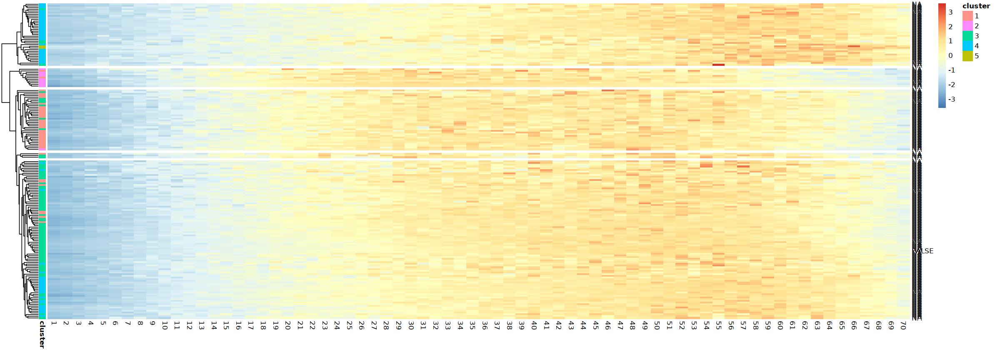

In [1378]:
pheatmap::pheatmap(df1[test1$`FALSE`[test1$`FALSE` %in% rownames(df1)],1:70],cluster_cols = F,cluster_rows = T,scale="row",labels_row = F,annotation_row = test,cutree_rows = 5 )

In [1379]:
pheatmap::pheatmap(df1[test1$`FALSE`[test1$`TRUE` %in% rownames(df1)],1:70],cluster_cols = F,cluster_rows = T,scale="row",labels_row = F,annotation_row = test,cutree_rows = 5 )

ERROR: Error in hclust(d, method = method): NA/NaN/Inf in foreign function call (arg 10)


In [879]:
res_GV=enrichGO(gene = test$`TRUE`,OrgDb = "org.Mm.eg.db",keyType = "SYMBOL",ont = "all")

In [880]:
res_M=enrichGO(gene = test$`FALSE`,OrgDb = "org.Mm.eg.db",keyType = "SYMBOL",ont = "all")

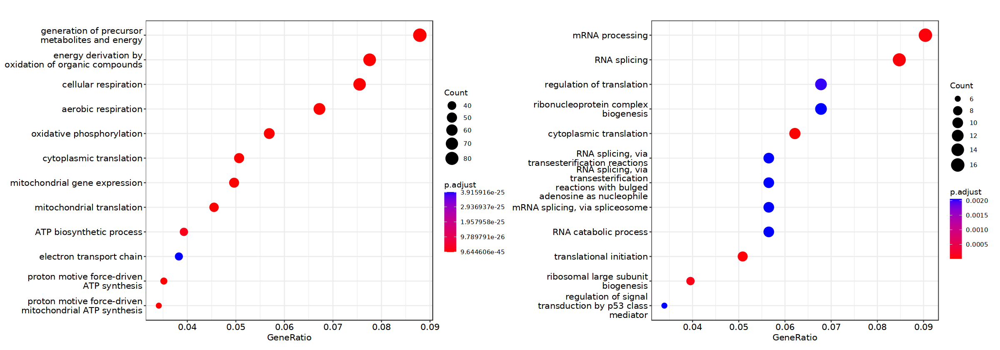

In [1087]:
options(repr.plot.width=20)
p=dotplot(res_GV,showCategory=12)+dotplot(res_M,showCategory=12)
ggsave("M_GV.GO.dotplot.pdf",width=20,height = 9,plot=p)
p

In [904]:
marker1=FindMarkers(mer,`ident.1` ="GV1",`ident.2` = "GV2",group.by = "annotation3")

In [1375]:
marker1=marker1[ marker1$p_val_adj<0.01, ]
test1=split(rownames(marker1),marker1$avg_log2FC>0)
table(test[test1$`TRUE`,])
table(test[test1$`FALSE`,])


 1  2  3  4 
38  6 53 32 


 1  2  3  4 
30 29 30 24 

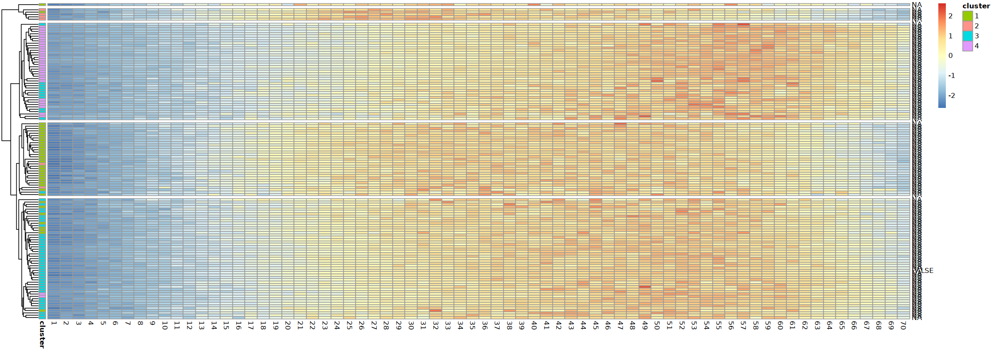

In [1373]:
pheatmap::pheatmap(df1[test1$`TRUE`,1:70],cluster_cols = F,cluster_rows = T,scale="row",labels_row = F,annotation_row = test,cutree_rows = 5 )

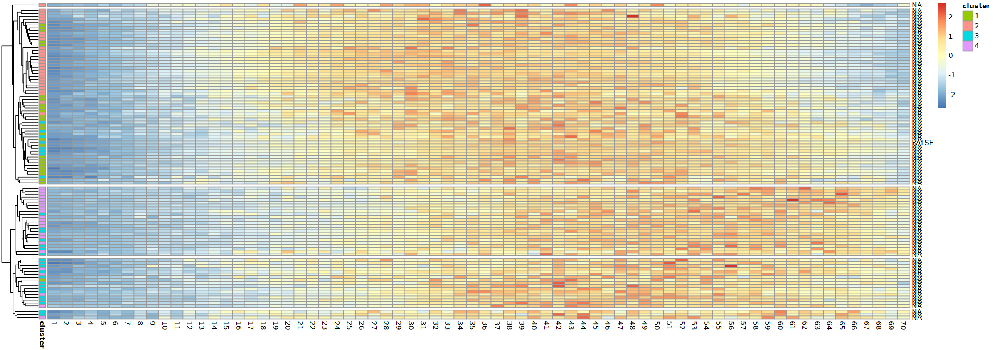

In [1376]:
pheatmap::pheatmap(df1[test1$`FALSE`[test1$`FALSE` %in% rownames(df1)],1:70],cluster_cols = F,cluster_rows = T,scale="row",labels_row = F,annotation_row = test,cutree_rows = 5 )

In [907]:
marker1=marker1[ marker1$p_val_adj<0.01, ]
test=split(rownames(marker1),marker1$avg_log2FC>0)
res_GV1=enrichGO(gene = test$`TRUE`,OrgDb = "org.Mm.eg.db",keyType = "SYMBOL",ont = "all")
res_GV2=enrichGO(gene = test$`FALSE`,OrgDb = "org.Mm.eg.db",keyType = "SYMBOL",ont = "all")

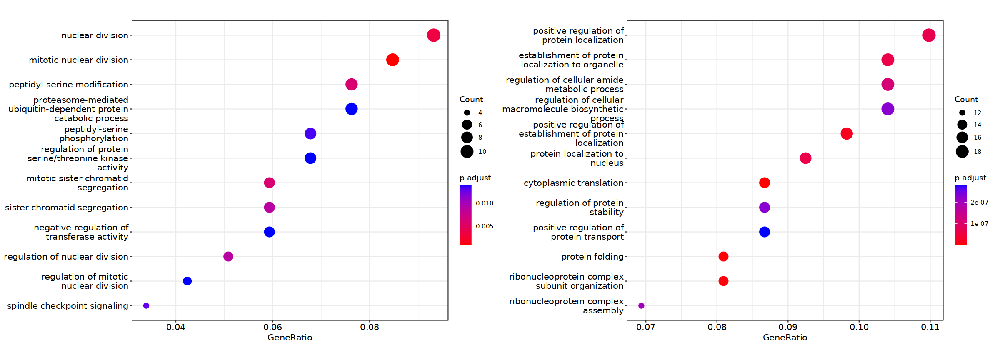

In [1086]:
options(repr.plot.width=20)
p=dotplot(res_GV1,showCategory=12)+dotplot(res_GV2,showCategory=12)
ggsave("GV1_GV2.GO.dotplot.pdf",width=20,height = 9,plot=p)
p

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


png 
  2

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


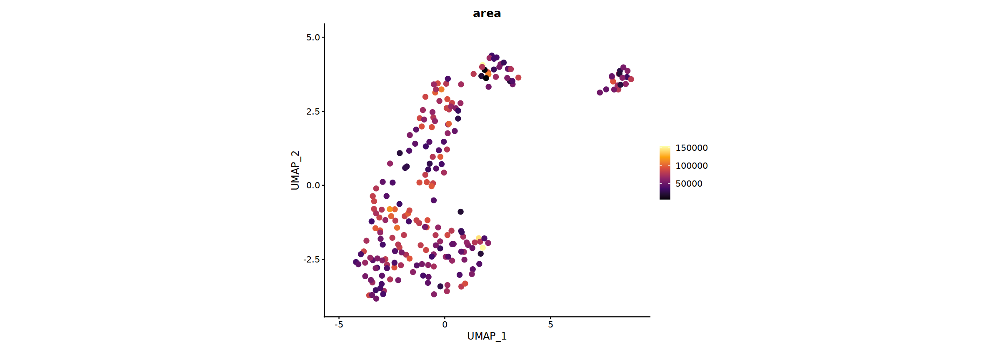

In [1114]:
pdf("Oocyte_area.pdf",width=5,height = 5)
FeaturePlot(mer,features = "area",pt.size = 3,slot  = "data")+coord_fixed(ratio = 1.4)+scale_color_viridis_c(option="B")
dev.off()
FeaturePlot(mer,features = "area",pt.size = 3,slot  = "data")+coord_fixed(ratio = 1.4)+scale_color_viridis_c(option="B")


Warning message:
“Scaling data with a low number of groups may produce misleading results”
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


png 
  2

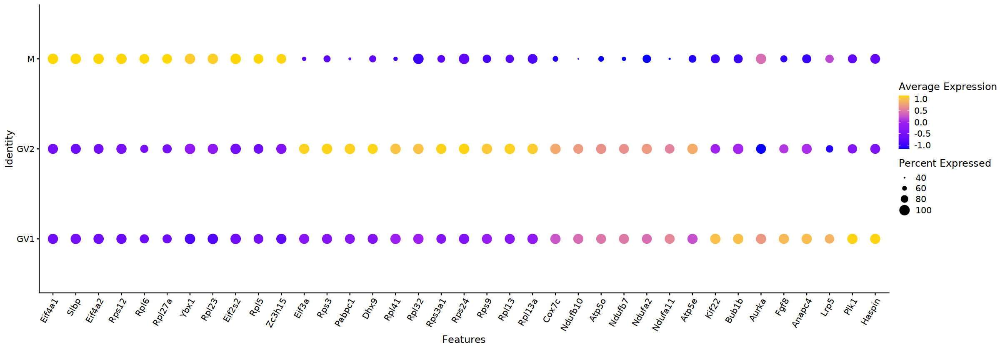

In [962]:
pdf("DotPlot.celltype.pdf",width=12,height=4)
p=DotPlot(mer,features = unique(strsplit("Eif4a1/Slbp/Eif4a2/Rps12/Rpl6/Rpl27a/Ybx1/Rpl23/Eif2s2/Rpl5/Zc3h15/Eif3a/Rps3/Pabpc1/Dhx9/Rpl41/Rpl32/Rps3a1/Rps24/Rps9/Rpl13/Rpl13a/Cox7c/Ndufb10/Atp5o/Ndufb7/Ndufa2/Ndufa11/Atp5e/Kif22/Bub1b/Aurka/Fgf8/Anapc4/Lrp5/Plk1/Haspin",split = "/")[[1]]),group.by = "annotation3")+theme(axis.text.x = element_text(angle=60,hjust=1))+
    scale_color_gradientn(colours = c("blue","purple","gold"))
p
dev.off()
p

In [970]:
E5_mer$CELL=paste0("C",E5_mer$cell,"_1")
C1_mer$CELL=paste0("C",C1_mer$cell,"_2")

In [971]:
gem=rbind(E5_mer,C1_mer)

In [972]:
mer@meta.data$CELL=rownames(mer@meta.data)

In [980]:
gem_mer=merge(gem,as.data.table(mer@meta.data[,c("Cx","Cy","area","CELL","annotation3")]),by="CELL",all = T)

In [1004]:
gem_mer$distance1=sqrt((gem_mer$x-gem_mer$Cx)^2+(gem_mer$y-gem_mer$Cy)^2)/sqrt(gem_mer$area)

In [1047]:
gem_mer$order=cut(gem_mer$distance1,breaks = 100,labels=1:100)

In [1050]:
agg1=aggregate(gem_mer$geneID,by=list("gene"=gem_mer$geneID,"order"=gem_mer$order),length)

In [ ]:
df=dcast(agg1,formula = gene~order,value.var = "x")
df[is.na(df)]=0

In [1059]:
rownames(df)=df$gene
df=df[,-1]

In [1063]:
df1=df[rowSums(df)>1000,]

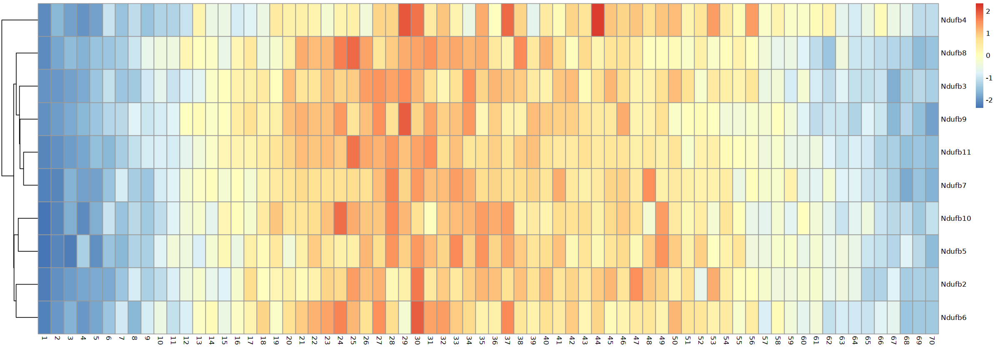

In [1074]:
pheatmap::pheatmap(df1[grepl("^Ndufb",rownames(df1)),1:70],cluster_cols = F,cluster_rows = T,scale="row")

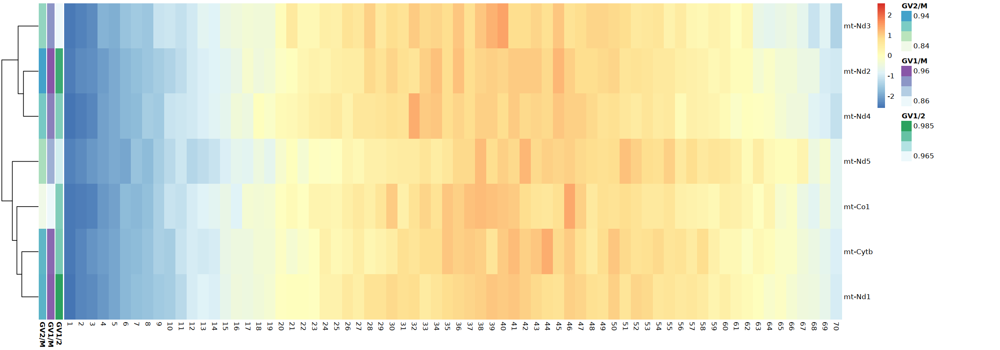

In [1183]:
pheatmap::pheatmap(df1[grepl("^mt-",rownames(df1)),1:70],cluster_cols = F,cluster_rows = T,scale="row",annotation_row = res1[grepl("^mt-",rownames(df1)),])

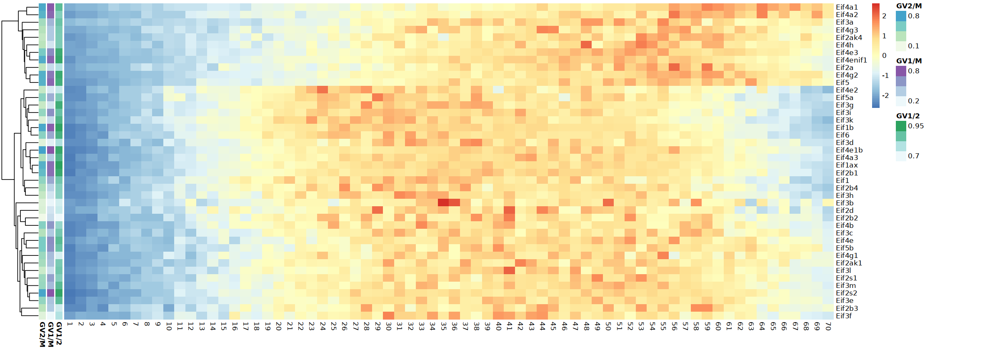

In [1182]:
p=pheatmap::pheatmap(df1[grepl("^Eif",rownames(df1)),1:70],cluster_cols = F,cluster_rows = T,scale="row",annotation_row = res1[grepl("^Eif",rownames(df1)),])
ggsave("Eif_location.pdf",height=8,width=9,plot=p)

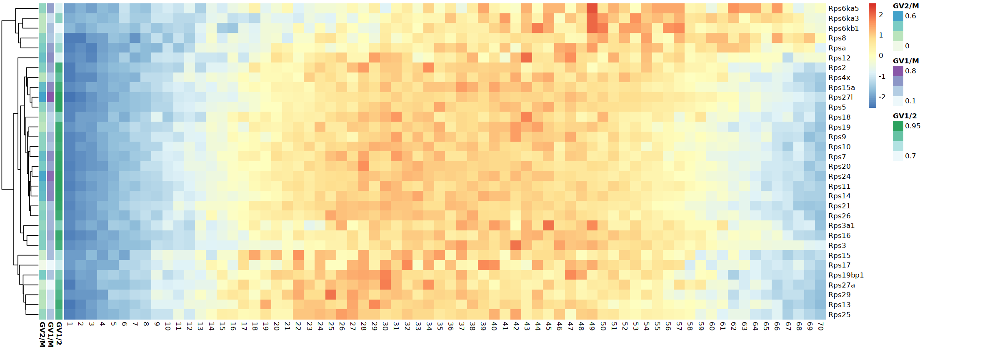

In [1225]:
p=pheatmap::pheatmap(df1[grepl("^Rps",rownames(df1)),1:70],cluster_cols = F,cluster_rows = T,scale="row",annotation_row = res1)
ggsave("Rps_location.pdf",height=8,width=9,plot=p)

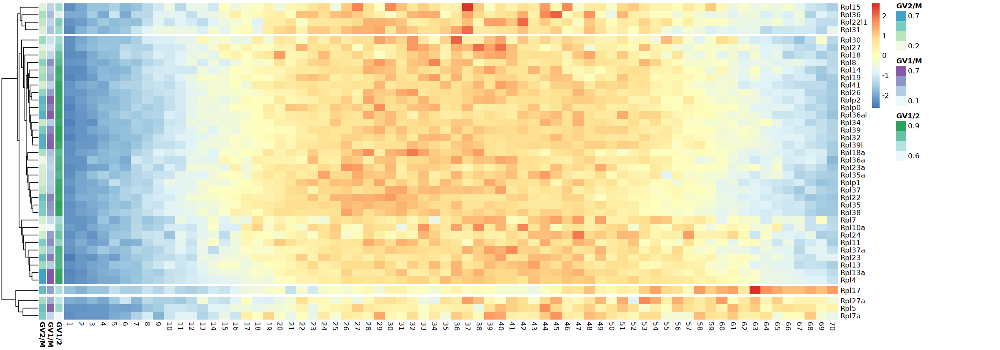

In [1303]:
p=pheatmap::pheatmap(df1[grepl("^Rpl",rownames(df1)),1:70],cluster_cols = F,cluster_rows = T,scale="row",annotation_row = res1,cutree_rows = 4)
ggsave("Rpl_location.pdf",height=8,width=9,plot=p)

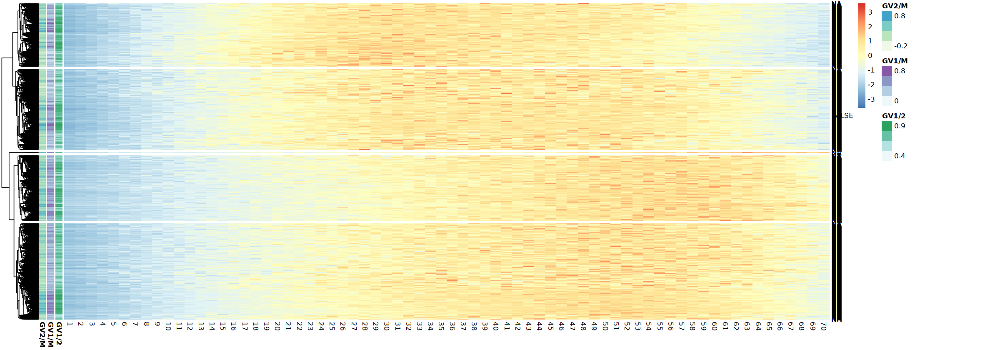

In [1308]:
p=pheatmap::pheatmap(df1[,1:70],cluster_cols = F,cluster_rows = T,scale="row",labels_row = F,annotation_row = res1,cutree_rows = 5)
ggsave("gene_location.pdf",height=8,width=9,plot=p)

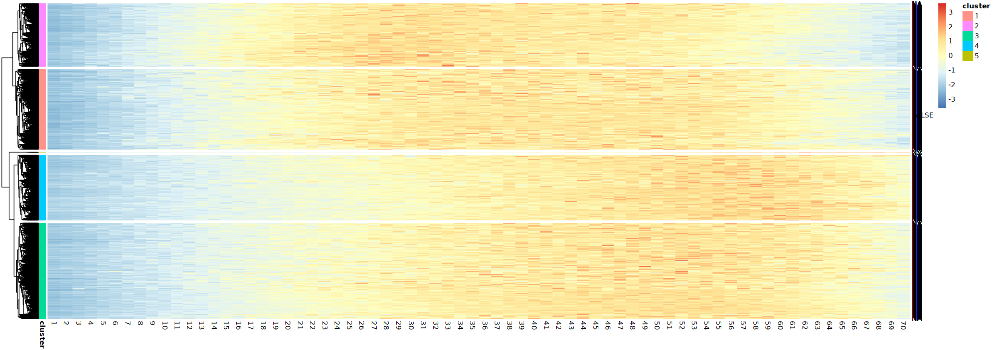

In [1316]:
pheatmap::pheatmap(df1[,1:70],cluster_cols = F,cluster_rows = T,scale="row",labels_row = F,annotation_row = test,cutree_rows = 5 )

In [1339]:
res=enrichGO(gene = rownames(test)[test$cluster==1],OrgDb = "org.Mm.eg.db",keyType = "SYMBOL",ont = "all")

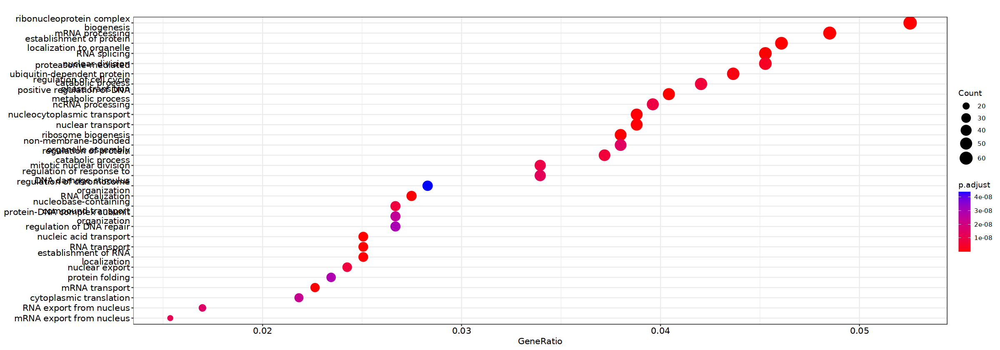

In [1342]:
dotplot(res,showCategory=30)

In [1335]:
res1=enrichGO(gene = rownames(test)[test$cluster==2],OrgDb = "org.Mm.eg.db",keyType = "SYMBOL",ont = "all")

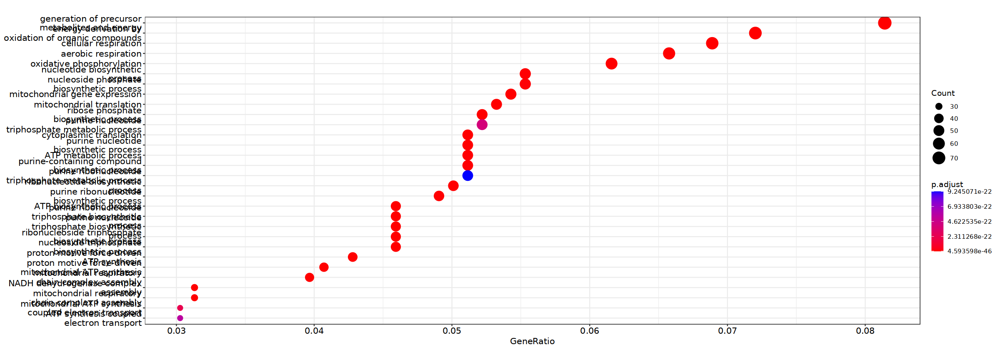

In [1337]:
dotplot(res1,showCategory=30)

In [1336]:
res2=enrichGO(gene = rownames(test)[test$cluster==3],OrgDb = "org.Mm.eg.db",keyType = "SYMBOL",ont = "all")
res3=enrichGO(gene = rownames(test)[test$cluster==4],OrgDb = "org.Mm.eg.db",keyType = "SYMBOL",ont = "all")

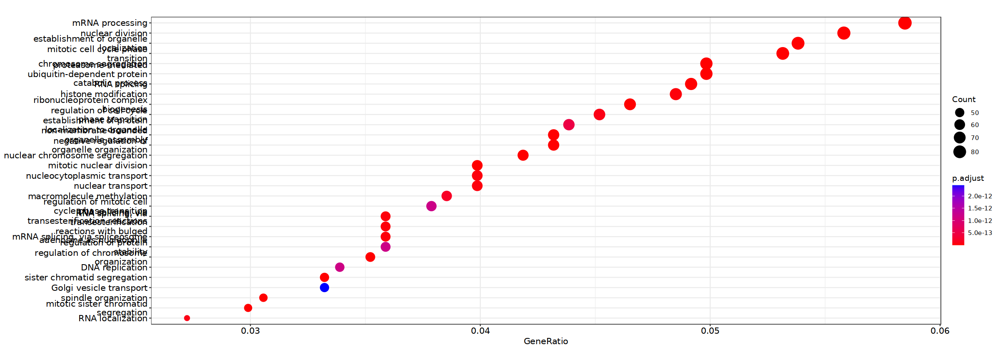

In [1338]:
dotplot(res2,showCategory=30)

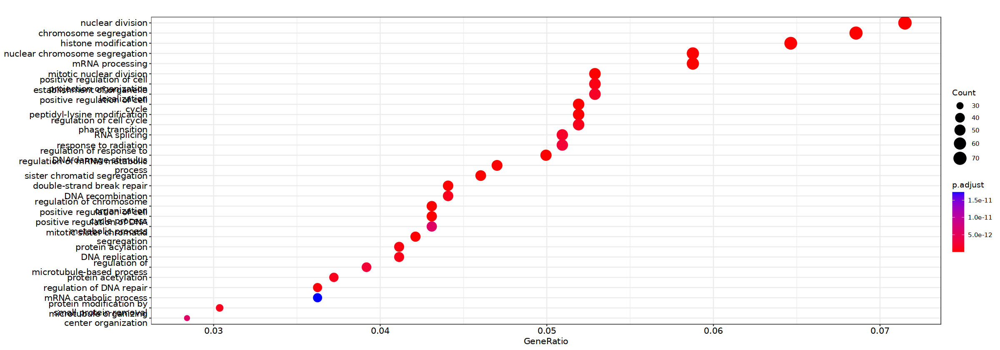

In [1341]:
dotplot(res3,showCategory=30)

In [1362]:
test=data.frame(cluster = cutree(p$tree_row, k = 5))
test$cluster=as.character(test$cluster)

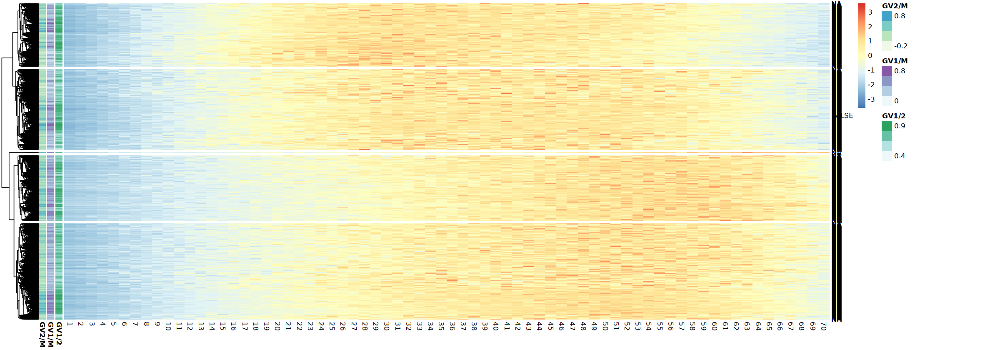

In [1364]:
p

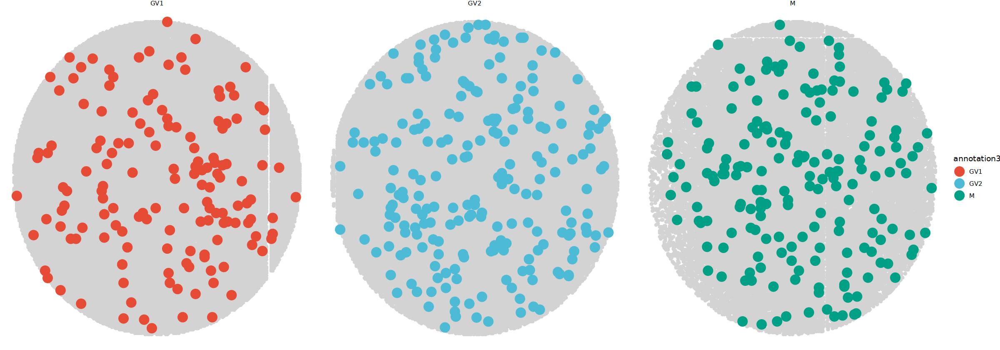

In [1221]:
ggplot(data=gem_mer[gem_mer$CELL %in% c("C100_1","C101_1","C102_1"),],aes(x,y))+geom_point(color="lightgray")+
    geom_point(inherit.aes = F,data=gem_mer[gem_mer$CELL %in% c("C100_1","C101_1","C102_1") & gem_mer$geneID %in% c("Eif4a1","Eif4g3","Eif4g2","Eif4e3","Eif4h","Eif4a2"),],aes(x,y,color=annotation3),size=6)+
    facet_wrap(annotation3~.,ncol=3,scales = "free")+theme_void()+ggsci::scale_color_npg()

In [1222]:
pdf("Eif4a1.pdf",width=12,height=4)
ggplot(data=gem_mer[gem_mer$CELL %in% c("C100_1","C101_1","C102_1"),],aes(x,y))+geom_point(color="lightgray")+
    geom_point(inherit.aes = F,data=gem_mer[gem_mer$CELL %in% c("C100_1","C101_1","C102_1") & gem_mer$geneID %in% c("Eif4a1"),],aes(x,y,color=annotation3),size=6)+
    facet_wrap(annotation3~.,ncol=3,scales = "free")+theme_void()+ggsci::scale_color_npg()
dev.off()

png 
  2

In [1218]:
pdf("Rps9.pdf",width=12,height=4)
ggplot(data=gem_mer[gem_mer$CELL %in% c("C100_1","C101_1","C102_1"),],aes(x,y))+geom_point(color="lightgray")+
    geom_point(inherit.aes = F,data=gem_mer[gem_mer$CELL %in% c("C100_1","C101_1","C102_1") & gem_mer$geneID=="Rps9",],aes(x,y,color=annotation3),size=6)+
    facet_wrap(annotation3~.,ncol=3,scales = "free")+theme_void()+ggsci::scale_color_npg()
dev.off()

png 
  2

In [1219]:
pdf("Eif3g.pdf",width=12,height=4)
ggplot(data=gem_mer[gem_mer$CELL %in% c("C100_1","C101_1","C102_1"),],aes(x,y))+geom_point(color="lightgray")+
    geom_point(inherit.aes = F,data=gem_mer[gem_mer$CELL %in% c("C100_1","C101_1","C102_1") & gem_mer$geneID=="Eif3g",],aes(x,y,color=annotation3),size=6)+
    facet_wrap(annotation3~.,ncol=3,scales = "free")+theme_void()+ggsci::scale_color_npg()
dev.off()

png 
  2

In [1192]:
head(gem_mer[gem_mer$annotation3=="GV2",])

CELL,x,y,geneID,MIDCount,ExonCount,V1,cell,Cx,Cy,area,annotation3,distance,distance1,order
<chr>,<int>,<int>,<chr>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<fct>
C102_1,13607,7519,Hist1h2aa,1,1,2394668,102,13765,7531,78512,GV2,158.4550,0.5655071,71
C102_1,13607,7520,Sp110,1,1,2395897,102,13765,7531,78512,GV2,158.3824,0.5652480,71
C102_1,13607,7522,Sgo2a,1,1,2398351,102,13765,7531,78512,GV2,158.2561,0.5647972,70
C102_1,13607,7524,Ssfa2,1,1,2400803,102,13765,7531,78512,GV2,158.1550,0.5644362,70
C102_1,13607,7526,Ice1,1,1,2403255,102,13765,7531,78512,GV2,158.0791,0.5641654,70
C102_1,13607,7528,Sfmbt1,1,1,2405705,102,13765,7531,78512,GV2,158.0285,0.5639847,70


In [1167]:
library(parallel)
cl <- makeCluster(10)
clusterExport(cl=cl,varlist=c("gem_mer"))
res=parApply(cl,X=as.matrix(rownames(df1)),MARGIN = 1,FUN=function(xx){
    df=gem_mer[gem_mer$geneID==xx,]
    temp1=aggregate(df$order,by=list("stage"=df$annotation3,"order"=df$order),length)
    temp2=aggregate(df$order,by=list("stage"=df$annotation3),length)
    temp3=merge(temp1,temp2,by="stage")
    temp3$pct=temp3$x.x/temp3$x.y
    temp4=reshape2::dcast(temp3,formula = stage~order,value.var = "pct")
    temp4[is.na(temp4)]=0
    rownames(temp4)=temp4$stage
    temp4=temp4[,-1]
    temp5=as.data.frame(t(temp4))
    c(cor(temp5$GV1,temp5$GV2),cor(temp5$GV1,temp5$M),cor(temp5$GV2,temp5$M))})
parallel::stopCluster(cl)

In [1171]:
res1=as.data.frame(t(res))
colnames(res1)=c("GV1/2","GV1/M","GV2/M")
rownames(res1)=rownames(df1)

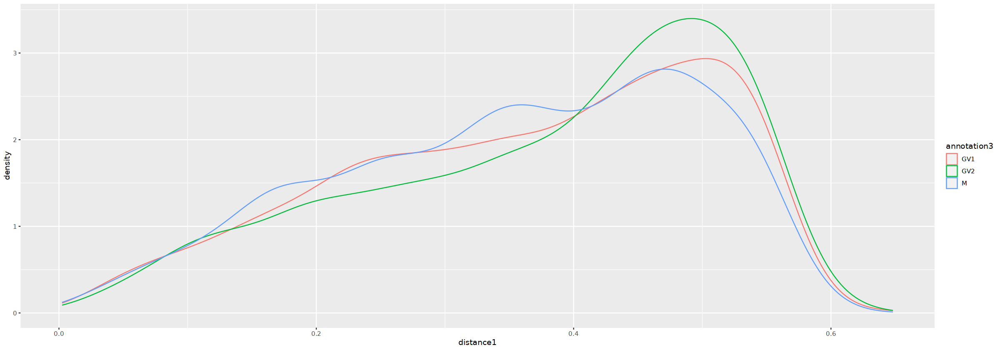

In [1185]:
ggplot(gem_mer[gem_mer$geneID=="Eif4a1",],aes(x=distance1,color=annotation3))+geom_density()

In [57]:
stages=fread("GSE71434_FPKM_stage.txt.gz",header = T)
stages=as.data.frame(stages)
stages=stages[!duplicated(stages$`#Gene`),]
rownames(stages)=stages$`#Gene`
stages=stages[,-1]
stages=CreateSeuratObject(stages)
stages$stage=Cells(stages)

In [77]:
TT$platform="TT"
obj$platform="Stereo-Cell"
#stages$platform="Smart-seq"

In [105]:
mer=merge(TT,obj)

In [79]:
library(harmony)

Loading required package: Rcpp



In [108]:
table(mer$platform)


Stereo-Cell          TT 
        139          24 

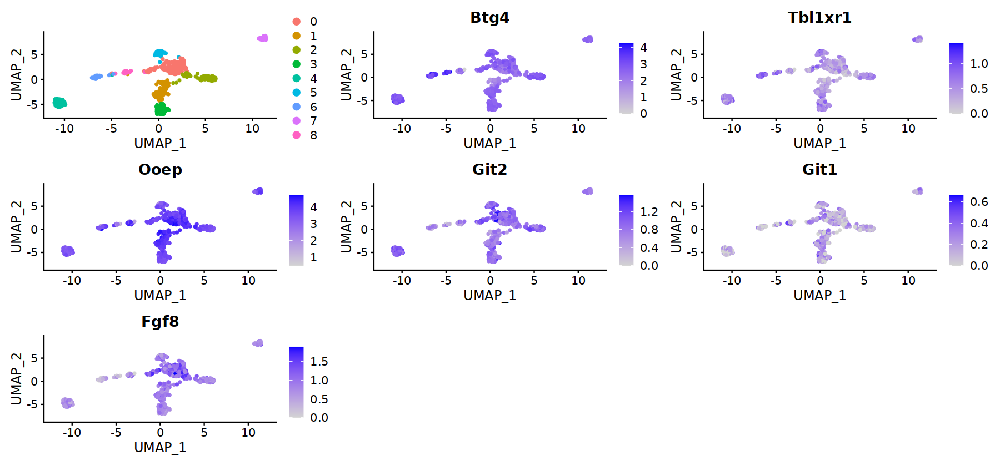

In [92]:
DimPlot(mer)+FeaturePlot(mer,"Btg4")+FeaturePlot(mer,"Tbl1xr1")+FeaturePlot(mer,"Ooep")+FeaturePlot(mer,"Git2")+FeaturePlot(mer,"Git1")+FeaturePlot(mer,"Fgf8")

In [89]:
marker=FindMarkers(mer,group.by = "annotation",`ident.1` = "GV1",`ident.2` = "GV2")

Warning message:
“ggrepel: 1091 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


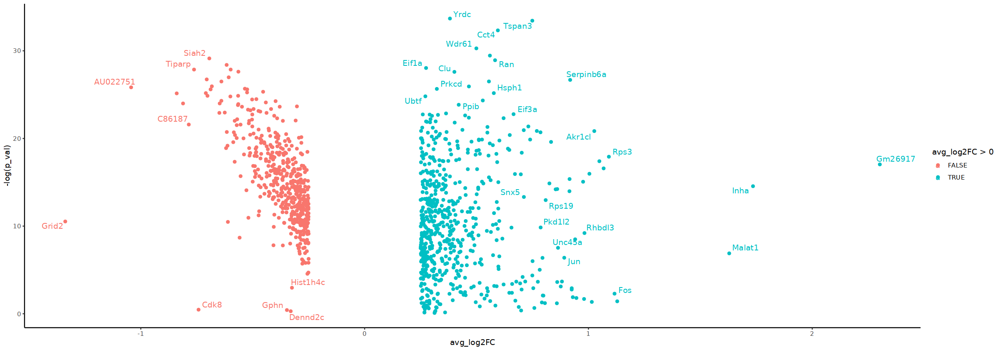

In [92]:
options(repr.plot.width=20)
ggplot(marker,aes(x=avg_log2FC,y=-log(p_val),color=avg_log2FC>0))+geom_point()+ggrepel::geom_text_repel(aes(label=rownames(marker)),max.overlaps = 3)+theme_classic()

In [231]:
df=as.data.frame(mer@reductions$umap@cell.embeddings)

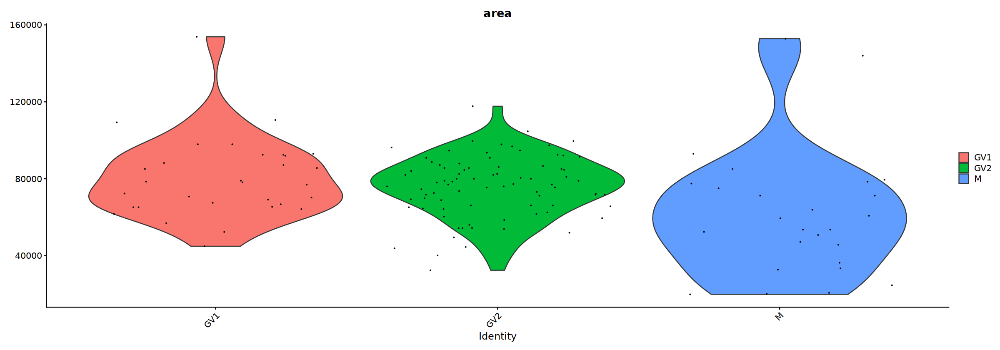

In [177]:
VlnPlot(subset(mer,subset=platform=="Stereo-Cell"),features = "area",group.by = "annotation")

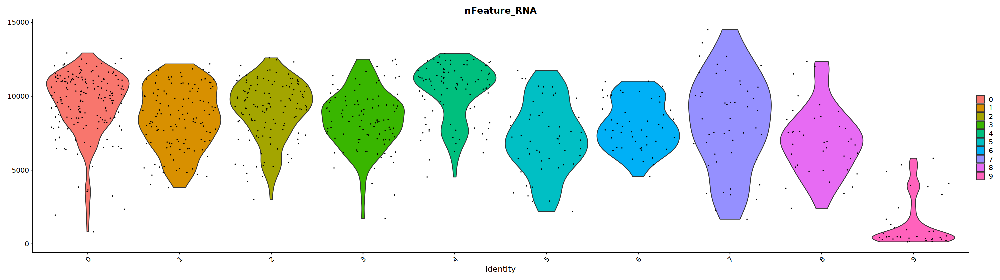

In [74]:
VlnPlot(mer,"nFeature_RNA")

In [2]:
mer=readRDS("/mnt/workdir/Stereo-cell/review_202505/merge.rds")

In [4]:
mer

An object of class Seurat 
24622 features across 719 samples within 1 assay 
Active assay: RNA (24622 features, 2000 variable features)
 3 dimensional reductions calculated: pca, harmony, umap

In [3]:
library(monocle3)
cds <- new_cell_data_set(mer@assays$RNA@counts,gene_metadata = DataFrame(gene_short_name=rownames(mer@assays$RNA@data),row.names =rownames(mer@assays$RNA@data)),
                         cell_metadata = mer@meta.data)

Loading required package: Biobase

Loading required package: BiocGenerics


Attaching package: ‘BiocGenerics’


The following objects are masked from ‘package:stats’:

    IQR, mad, sd, var, xtabs


The following objects are masked from ‘package:base’:

    anyDuplicated, aperm, append, as.data.frame, basename, cbind,
    colnames, dirname, do.call, duplicated, eval, evalq, Filter, Find,
    get, grep, grepl, intersect, is.unsorted, lapply, Map, mapply,
    match, mget, order, paste, pmax, pmax.int, pmin, pmin.int,
    Position, rank, rbind, Reduce, rownames, sapply, setdiff, sort,
    table, tapply, union, unique, unsplit, which.max, which.min


Welcome to Bioconductor

    Vignettes contain introductory material; view with
    'browseVignettes()'. To cite Bioconductor, see
    'citation("Biobase")', and for packages 'citation("pkgname")'.


Loading required package: SingleCellExperiment

Loading required package: SummarizedExperiment

Loading required package: MatrixGenerics

Loading

In [5]:
cds <- preprocess_cds(cds, num_dim = 50)
cds <- align_cds(cds, alignment_group = "sample")

In [ ]:
cds <- reduce_dimension(cds)
plot_cells(cds, label_groups_by_cluster=FALSE,  color_cells_by = "sample")

No trajectory to plot. Has learn_graph() been called yet?



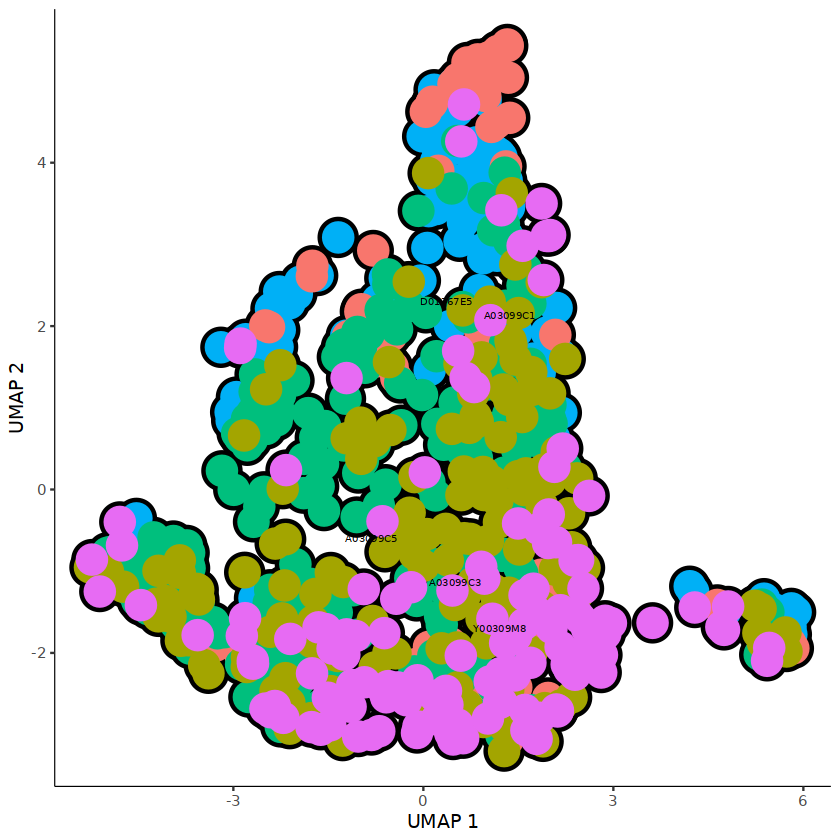

In [7]:
plot_cells(cds, label_groups_by_cluster=FALSE,  color_cells_by = "sample",cell_size = 5)

In [ ]:
cds <- cluster_cells(cds)

In [ ]:
cds <- learn_graph(cds)

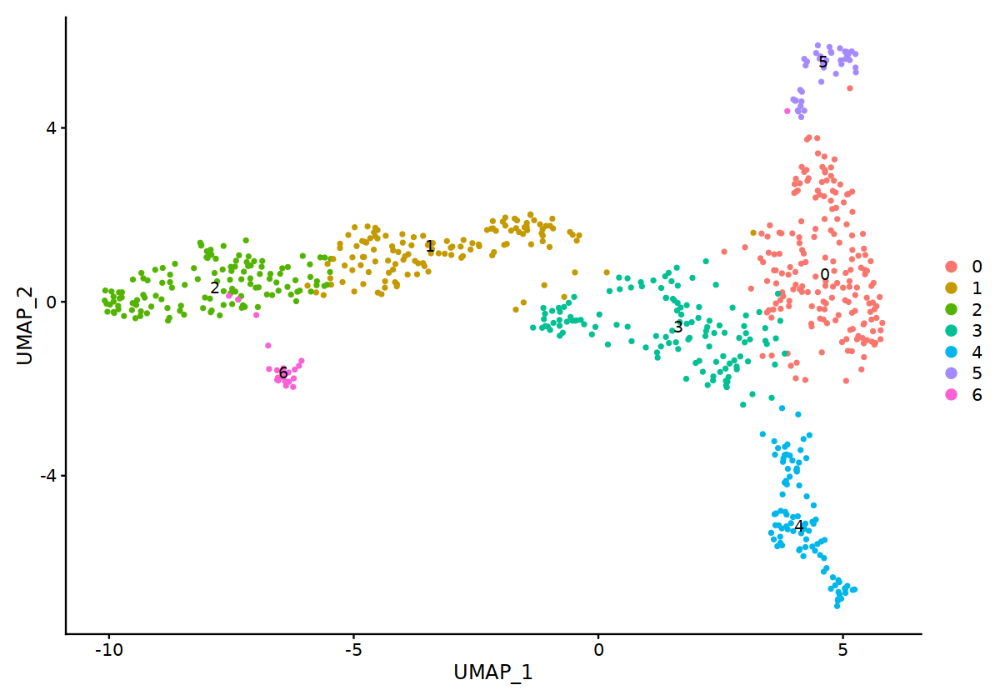

In [23]:
library(Seurat)
DimPlot(mer,label=T)

In [30]:
head(as.data.frame(mer@reductions$umap@cell.embeddings)[order(mer@reductions$umap@cell.embeddings[,1],decreasing = F),])

,UMAP_1,UMAP_2
,<dbl>,<dbl>
C178_4,-10.088552,0.02721487
C73_3,-10.077659,0.25885646
C20_5,-10.051703,-0.04282568
C43_3,-10.033358,-0.22882597
C20_3,-9.981531,-0.06676696
C178_5,-9.950470,0.23725165


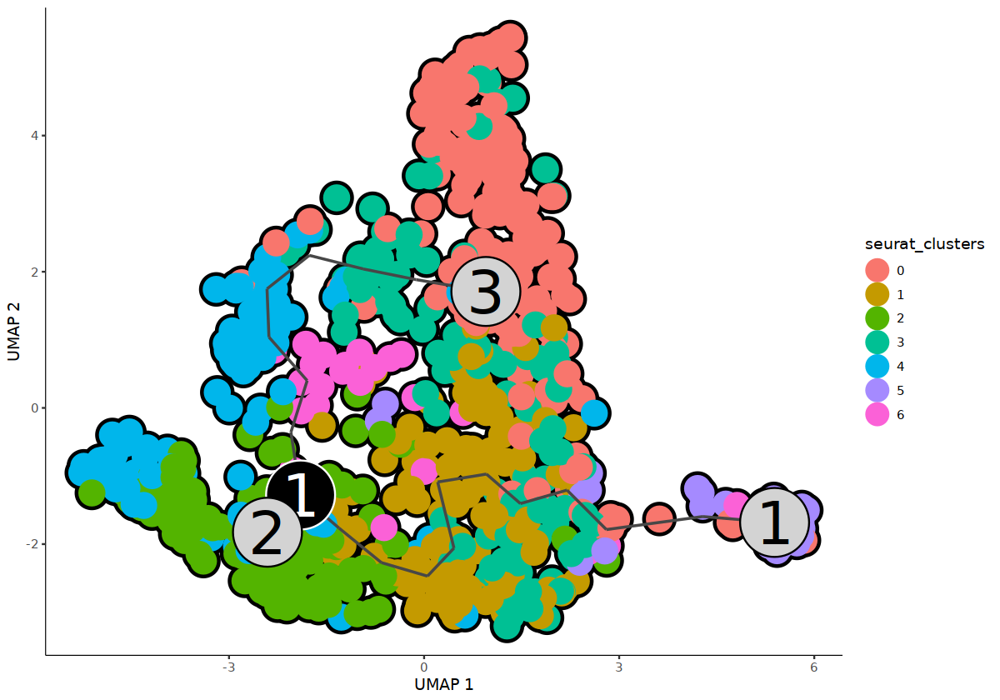

In [10]:
options(repr.plot.width=10)
plot_cells(cds,cell_size = 5,
           color_cells_by = "seurat_clusters",
           label_cell_groups=FALSE,
           label_leaves=TRUE,
           label_branch_points=TRUE,
           graph_label_size=15)

In [19]:
cds <- order_cells(cds,root_cells = c("C178_4","C73_3","C20_5","C43_3","C20_3"))

ERROR: Error: No dimensionality reduction for UMAP calculated. Please run reduce_dimension with reduction_method = UMAP, cluster_cells, and learn_graph before running order_cells.


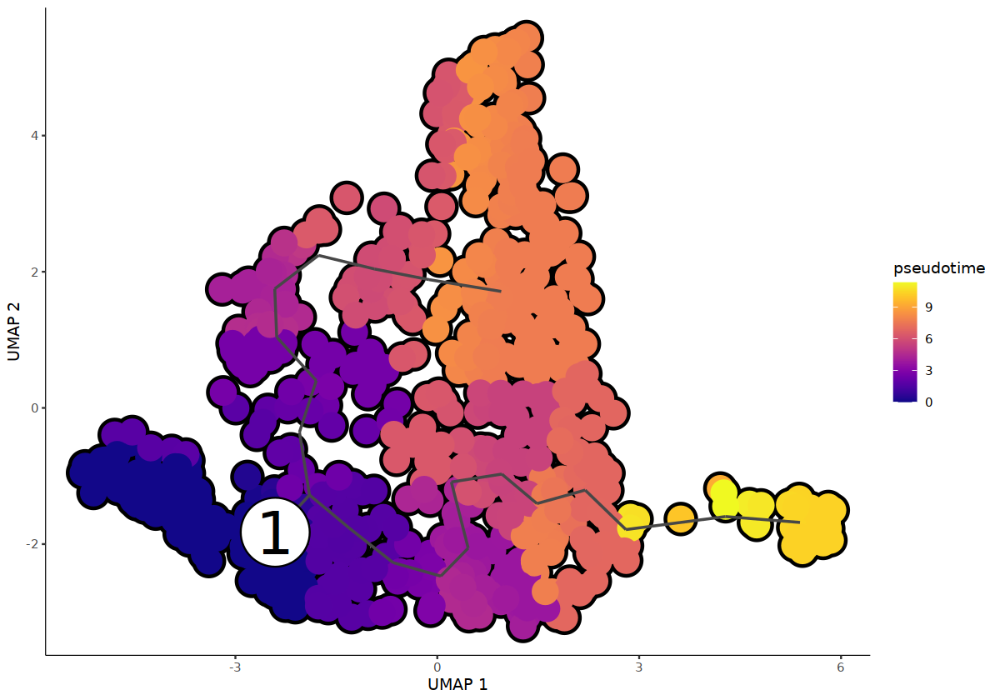

In [32]:
plot_cells(cds,cell_size = 5,
           color_cells_by = "pseudotime",
           label_cell_groups=FALSE,
           label_leaves=FALSE,
           label_branch_points=FALSE,
           graph_label_size=15)

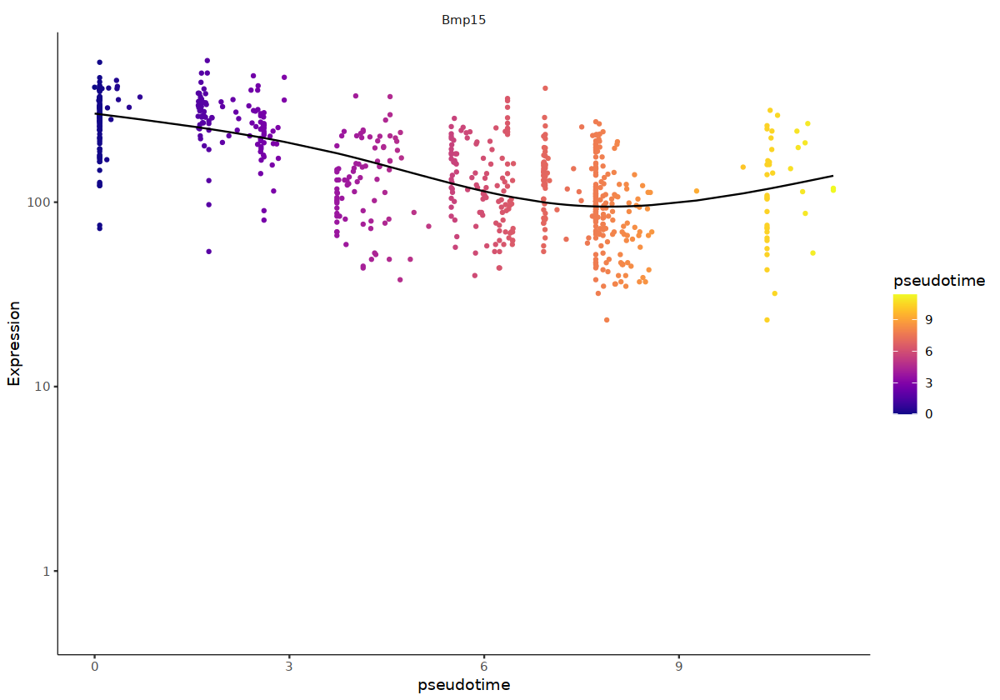

In [36]:
plot_genes_in_pseudotime(cds["Bmp15"],label_by_short_name = F,
                         color_cells_by="pseudotime",
                         min_expr=0.5)

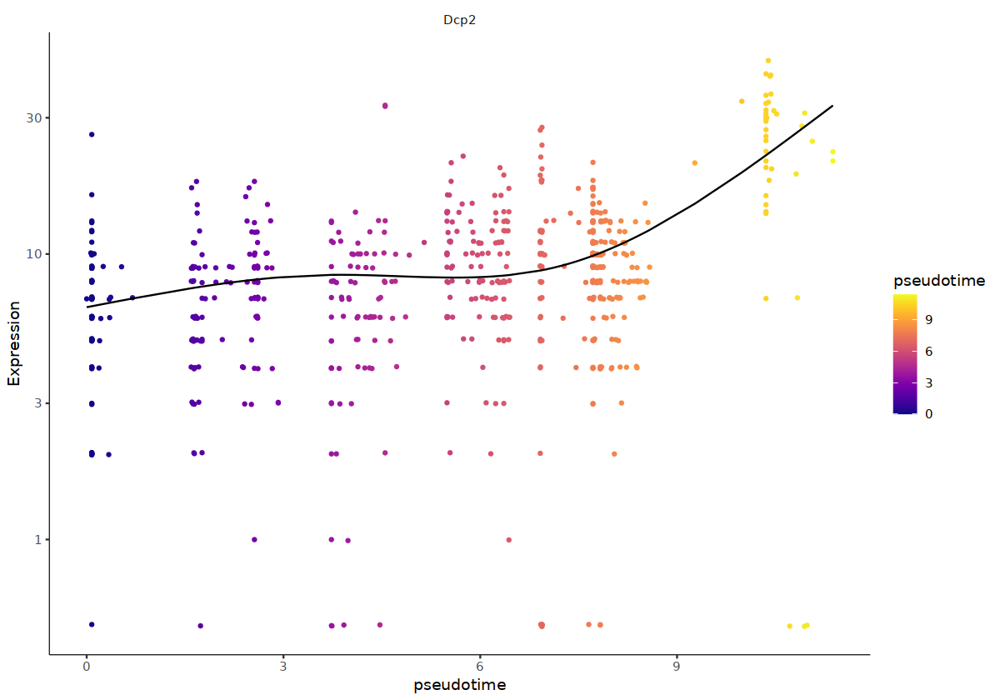

In [38]:
plot_genes_in_pseudotime(cds["Dcp2"],label_by_short_name = F,
                         color_cells_by="pseudotime",
                         min_expr=0.5)

In [194]:
mer$pseudotime=cds@principal_graph_aux@listData$UMAP$pseudotime [ Cells(mer) ]

In [16]:
library(ggplot2)

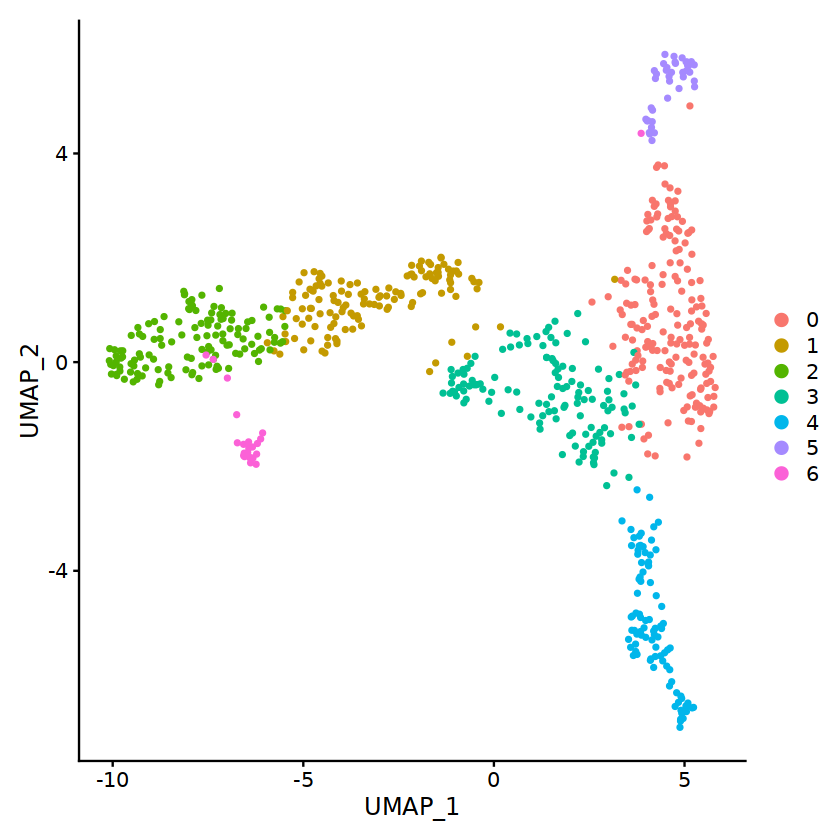

In [20]:
DimPlot(mer)

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


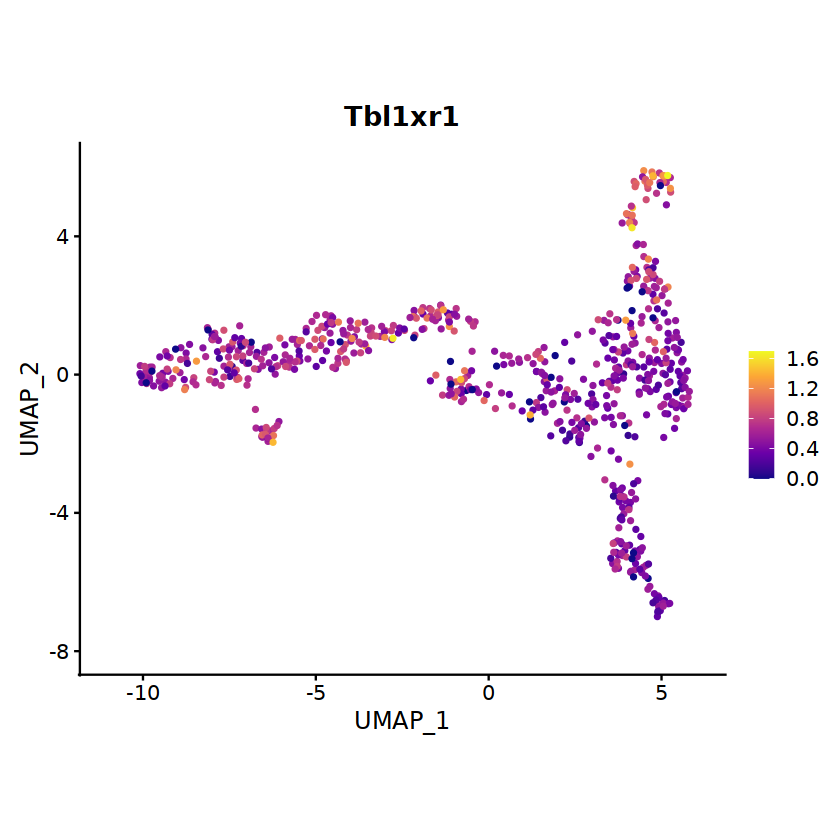

In [18]:
FeaturePlot(mer,features = "Tbl1xr1")+scale_color_viridis_c(option = "C")+coord_fixed()

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


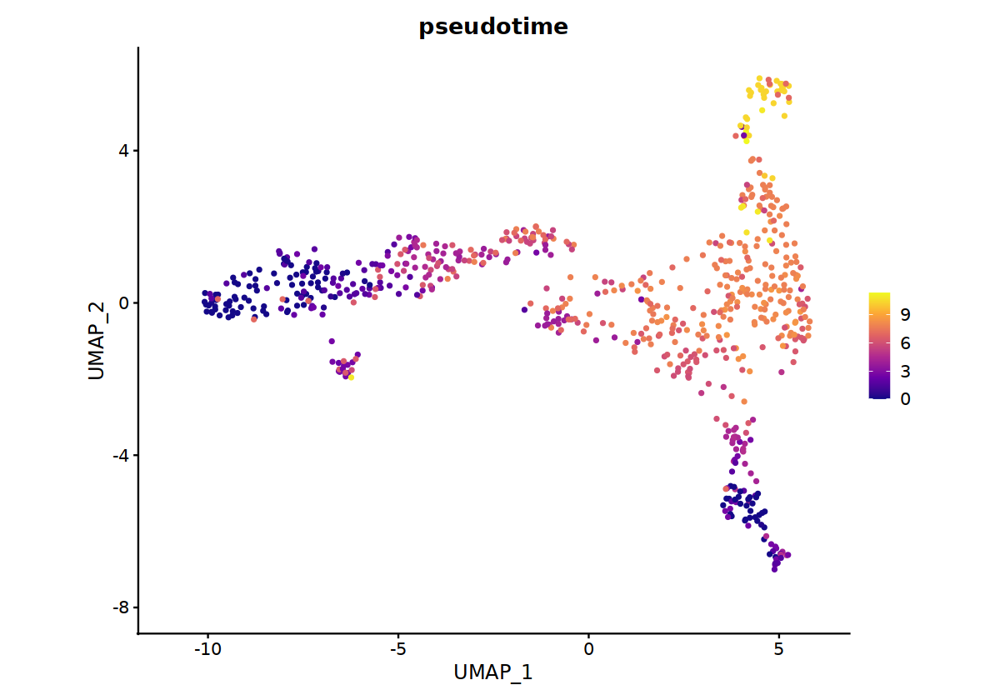

In [172]:
FeaturePlot(mer,features = "pseudotime")+scale_color_viridis_c(option = "C")+coord_fixed()

In [67]:
mer=readRDS("merge.rds")

In [9]:
sce=as.SingleCellExperiment(mer)

In [12]:
library(destiny)
dm <- DiffusionMap(sce, verbose = TRUE)

finding knns...

Warning message in (function (data, k, ..., query = NULL, distance = c("euclidean", :
“find_knn does not yet support sparse matrices, converting data to a dense matrix.”


...done. Time: 0.78s
Calculating transition probabilities...

Warning message:
“'as(<dsCMatrix>, "dsTMatrix")' is deprecated.
Use 'as(., "TsparseMatrix")' instead.
See help("Deprecated") and help("Matrix-deprecated").”


...done. Time: 0.02s

performing eigen decomposition......done. Time: 0.06s


In [13]:
df=eigenvectors(dm)

In [14]:
df=as.data.frame(eigenvectors(dm))
df=cbind(df,mer@meta.data[rownames(df),])

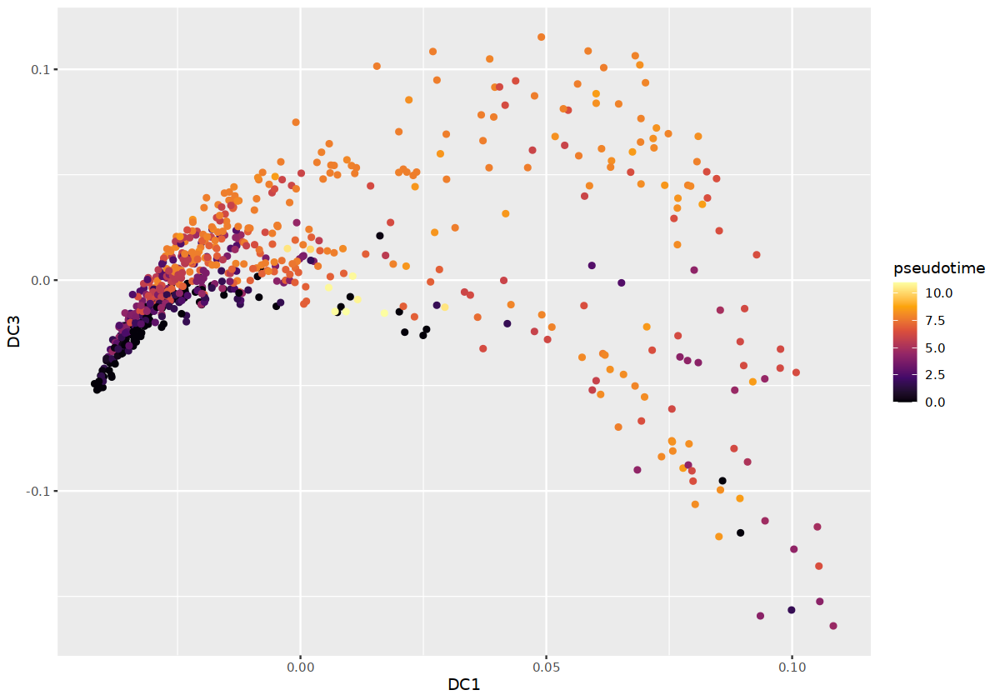

In [100]:
ggplot(df[df$seurat_clusters!=5,],aes(DC1,DC3,color=pseudotime),order=T)+geom_point()+scale_color_viridis_c(option = "B")

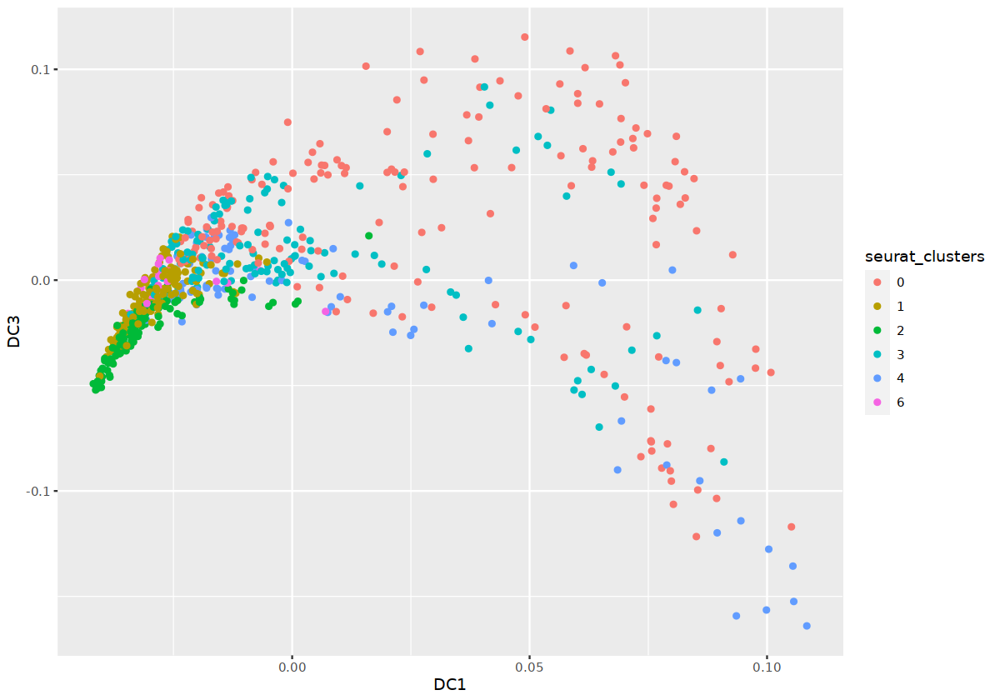

In [102]:
ggplot(df[df$seurat_clusters!=5,],aes(DC1,DC3,color=seurat_clusters),order=T)+geom_point()

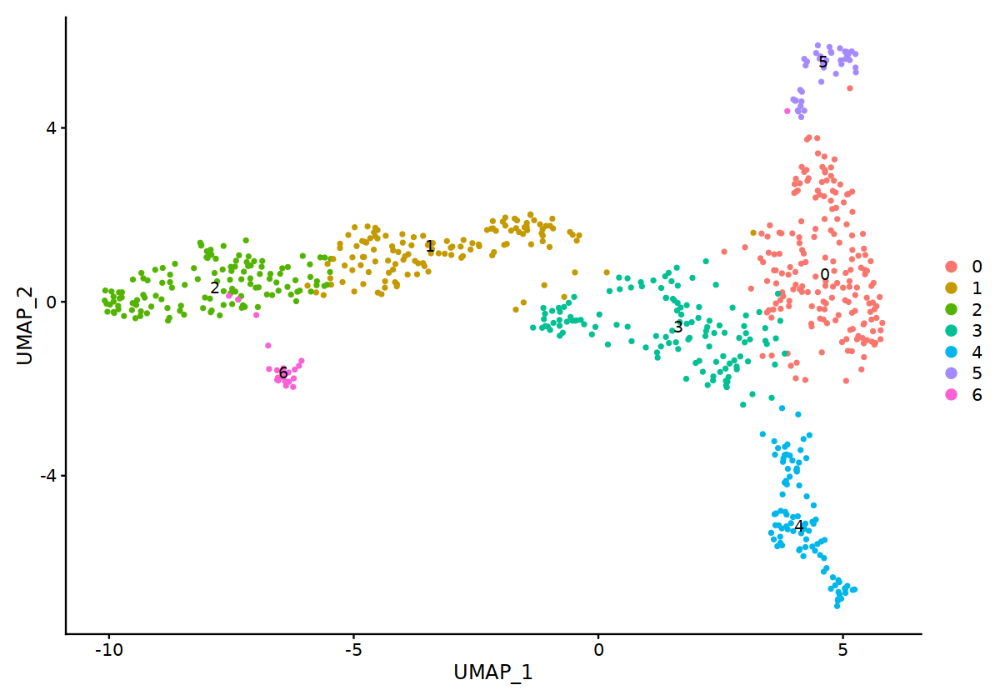

In [92]:
DimPlot(mer,label=T)

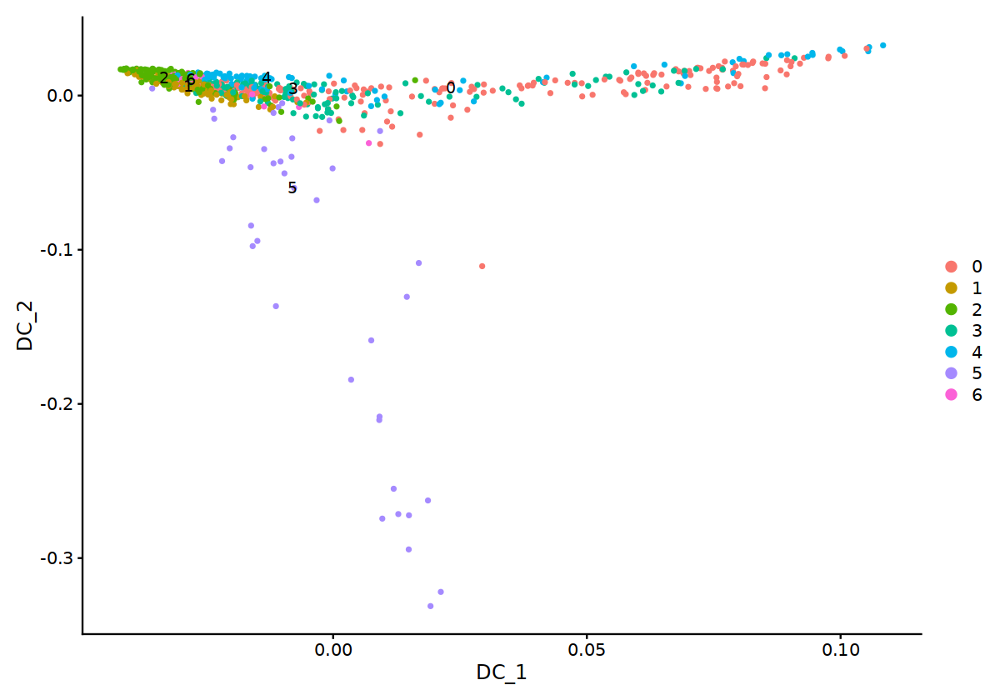

In [104]:
DimPlot(mer,reduction = "dm",label = T)

Scale for x is already present.
Adding another scale for x, which will replace the existing scale.
Scale for y is already present.
Adding another scale for y, which will replace the existing scale.
Warning message:
“Removed 100 rows containing missing values (`geom_raster()`).”


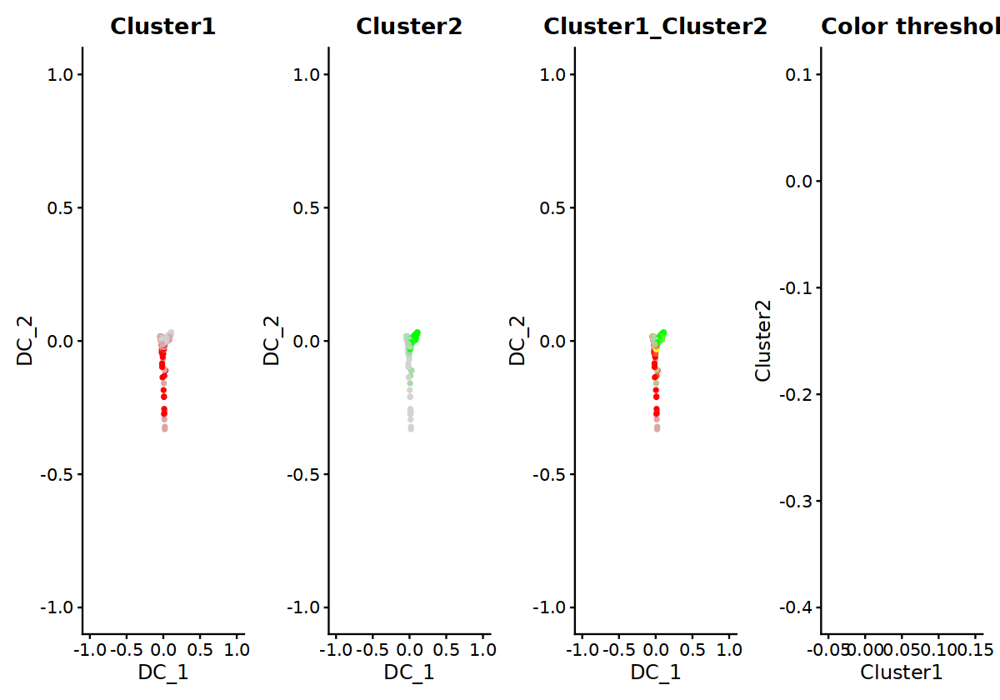

In [116]:
FeaturePlot(mer,reduction = "dm",features = c("Cluster1","Cluster2"),blend = T,)+xlim(-0.05,0.15)+ylim(-0.4,0.1)

Scale for x is already present.
Adding another scale for x, which will replace the existing scale.
Scale for y is already present.
Adding another scale for y, which will replace the existing scale.
Scale for x is already present.
Adding another scale for x, which will replace the existing scale.
Scale for y is already present.
Adding another scale for y, which will replace the existing scale.


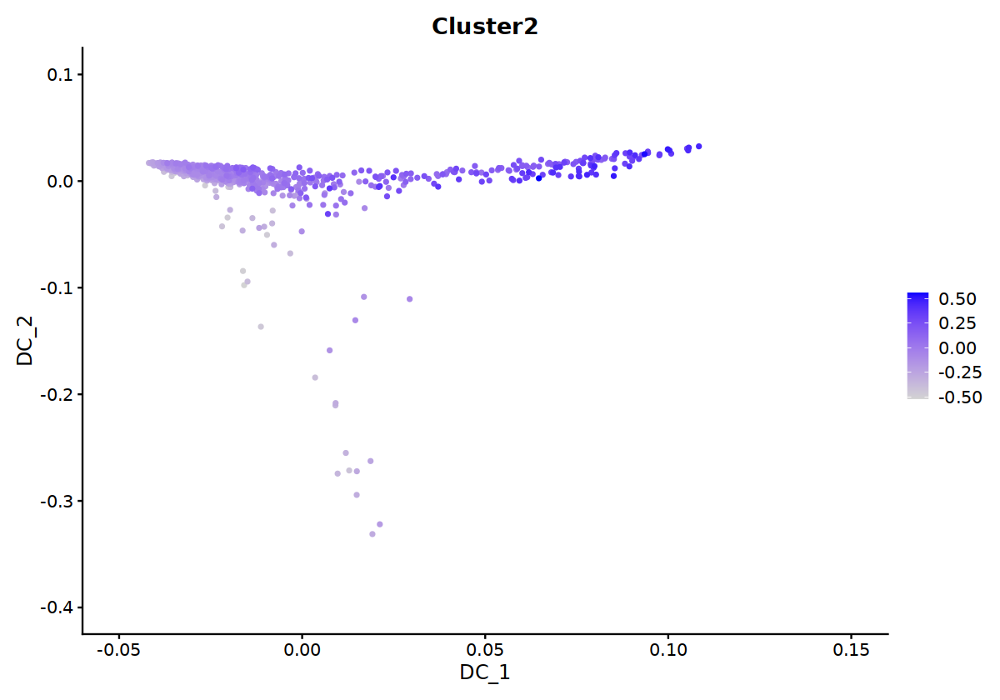

Scale for x is already present.
Adding another scale for x, which will replace the existing scale.
Scale for y is already present.
Adding another scale for y, which will replace the existing scale.


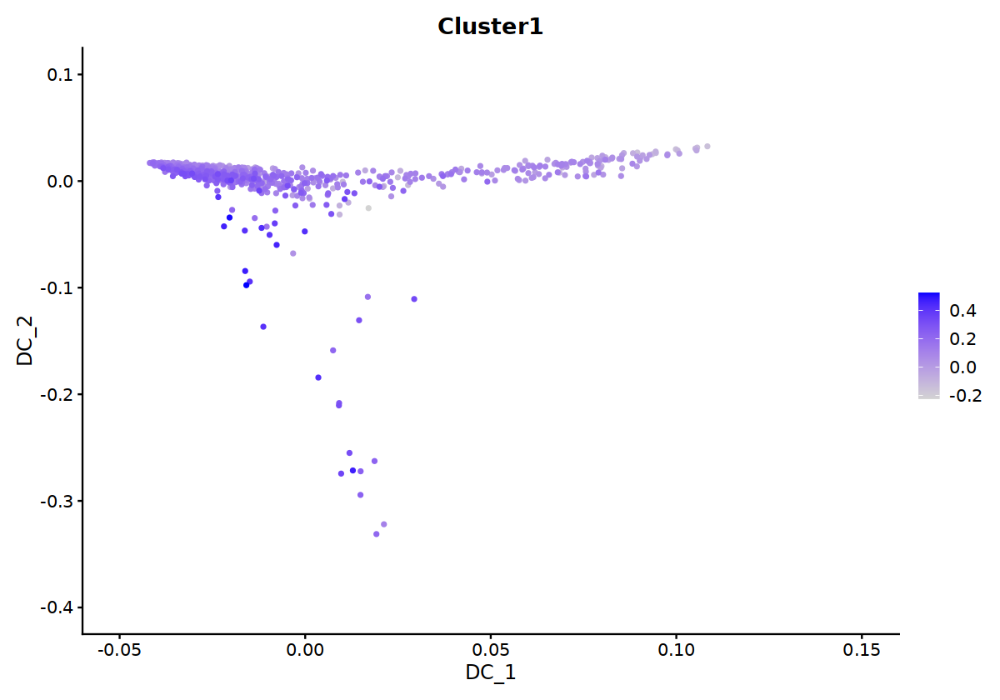

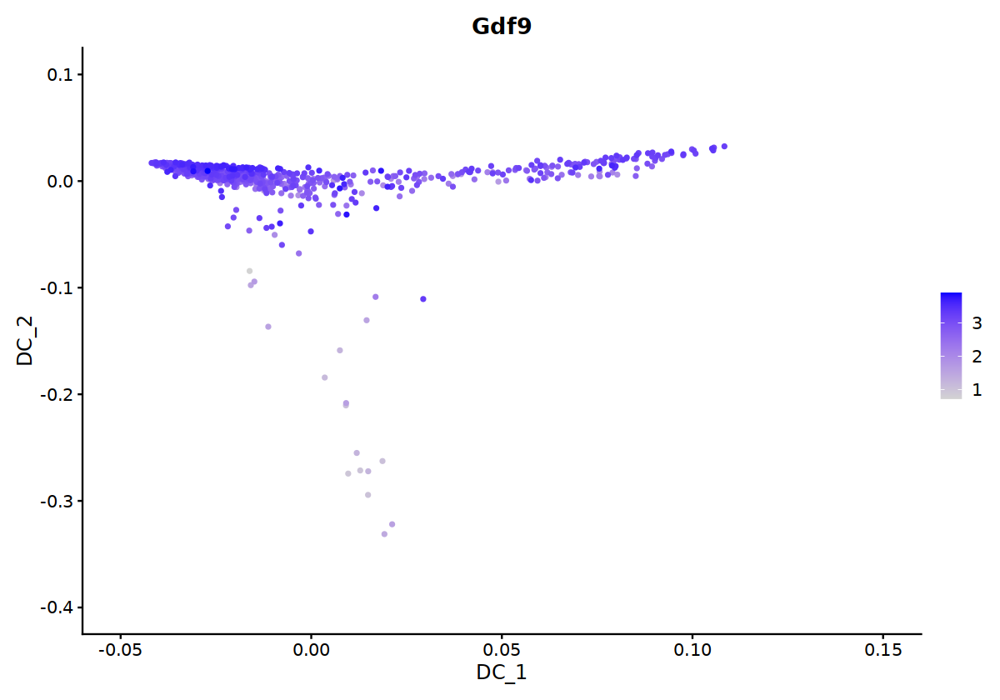

In [114]:
FeaturePlot(mer,reduction = "dm",features = "Cluster2",order=T)+xlim(-0.05,0.15)+ylim(-0.4,0.1)
FeaturePlot(mer,reduction = "dm",features = "Cluster1",order=T)+xlim(-0.05,0.15)+ylim(-0.4,0.1)
FeaturePlot(mer,reduction = "dm",features = "Gdf9",order=T)+xlim(-0.05,0.15)+ylim(-0.4,0.1)

In [195]:
mer@reductions$dm=CreateDimReducObject(as.matrix(df[,1:20]),key = "DC_")

Warning message:
“No assay specified, setting assay as RNA by default.”


In [20]:
gene_fits <- fit_models(cds, model_formula_str = "~pseudotime")

In [21]:
fit_coefs <- coefficient_table(gene_fits)

Warning message:
“Could not find Tbl1xr1 in the default search locations, found in RNA assay instead”


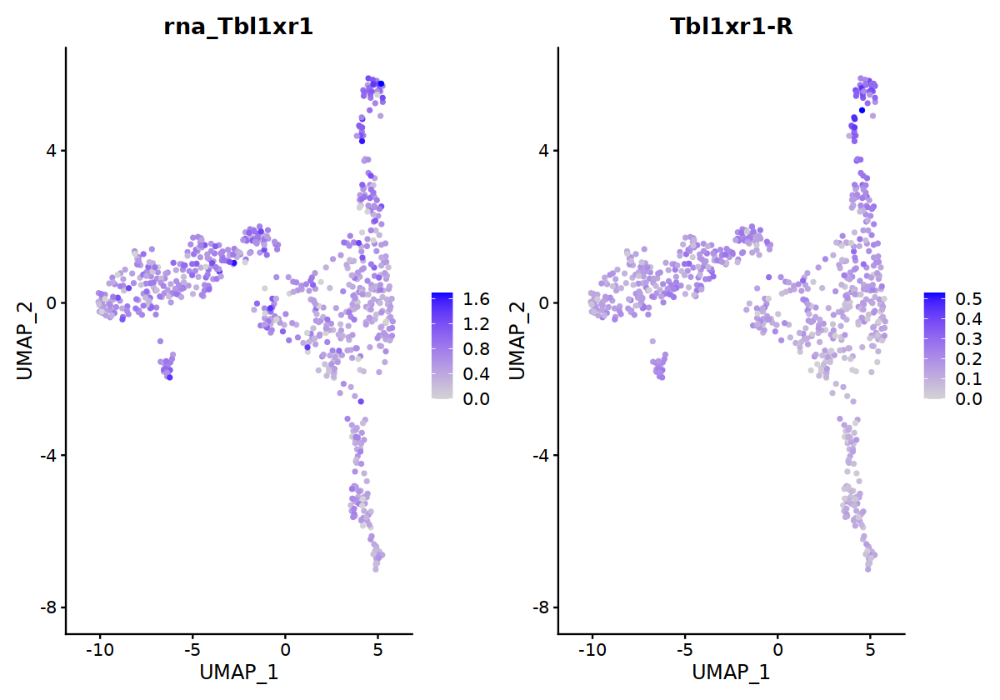

In [250]:
FeaturePlot(mer,"Tbl1xr1")|FeaturePlot(mer,"Tbl1xr1-R")

Warning message:
“Could not find Ehf in the default search locations, found in RNA assay instead”


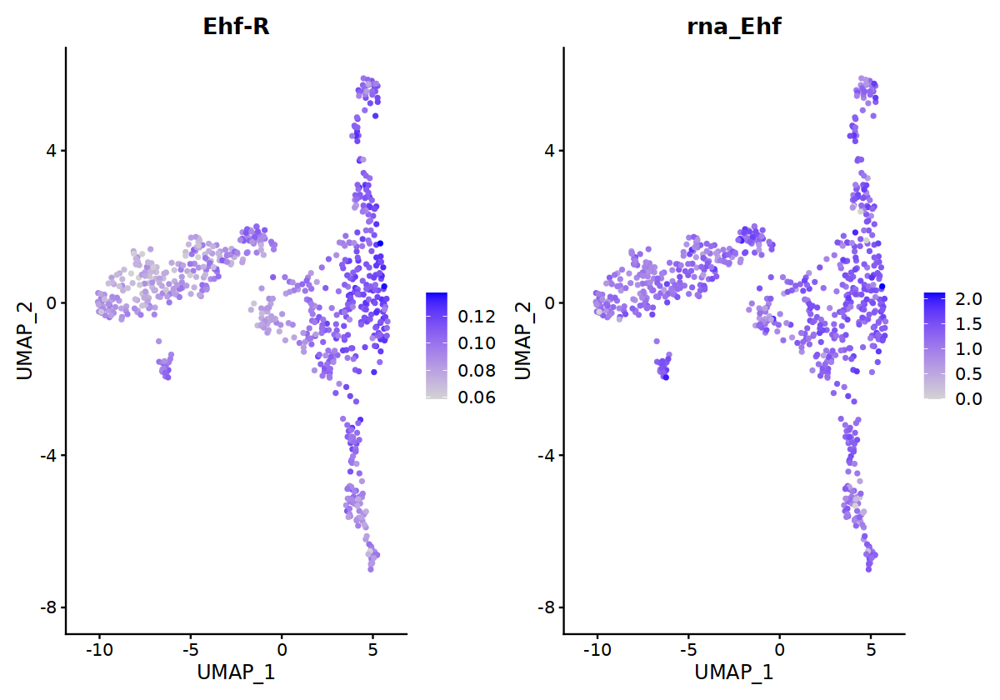

In [253]:
FeaturePlot(mer,"Ehf-R")|FeaturePlot(mer,"Ehf")

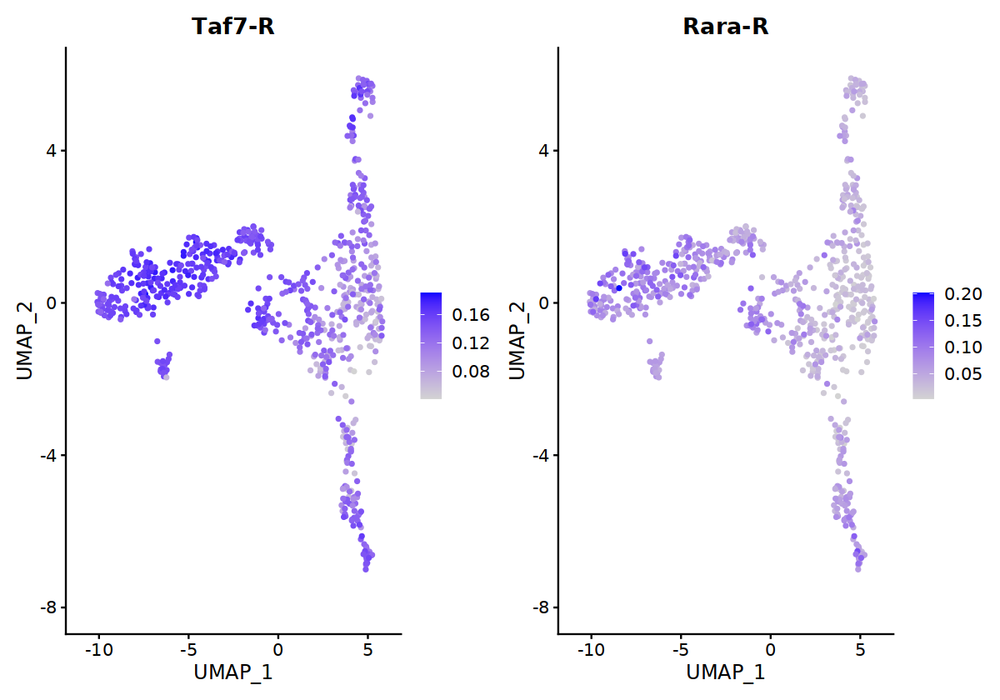

In [262]:
FeaturePlot(mer,"Taf7-R")|FeaturePlot(mer,"Rara-R")

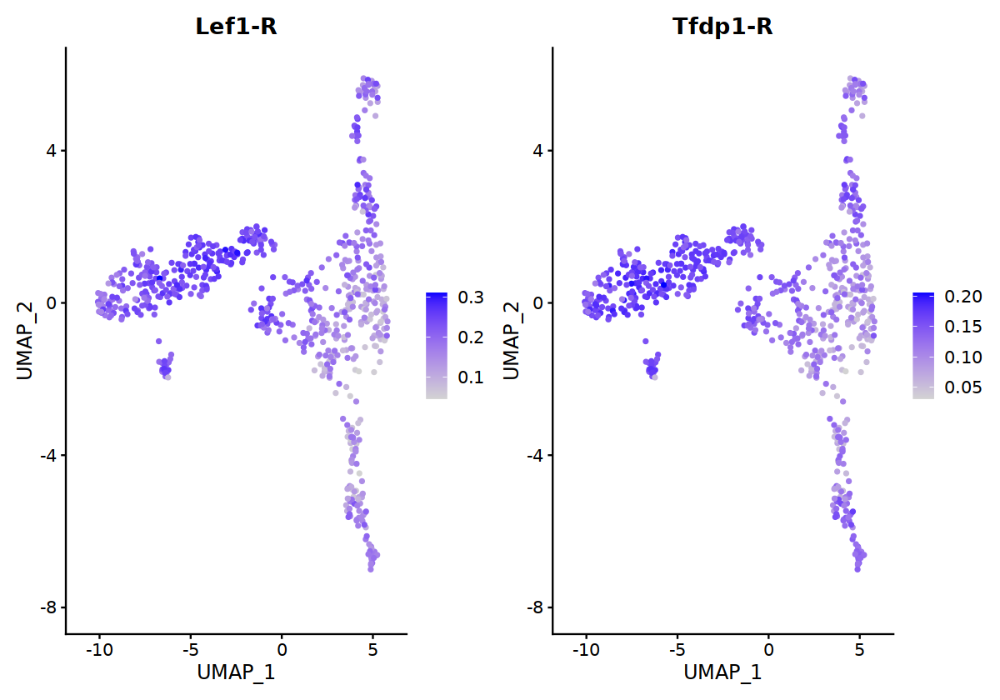

In [263]:
FeaturePlot(mer,"Lef1-R")|FeaturePlot(mer,"Tfdp1-R")

In [264]:
length(unique(markers$gene))

[1] 42

In [258]:
markers=FindAllMarkers(mer,assay = "regulon",logfc.threshold = 0.05)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6



In [196]:
library(ggplot2)
mer$pseudo_order_group=cut_number(mer$pseudotime,n = 20,label=1:20)

In [10]:
library(Seurat)

Attaching SeuratObject


Attaching package: ‘Seurat’


The following object is masked from ‘package:SummarizedExperiment’:

    Assays




In [13]:
mer=readRDS("/mnt/workdir/Stereo-cell/review_202505/expand.merge.rds")

In [33]:
fit_coefs=readRDS("/mnt/workdir/Stereo-cell/review_202505/monocle3.fit.gene.rds")
library(dplyr)
df=fit_coefs %>% filter(term == "pseudotime") %>% filter (q_value < 0.05) %>% 
         select(gene_short_name, term, q_value, estimate,num_cells_expressed) %>% arrange(order_by = estimate)
dim(df)
AveExp=AverageExpression(mer,assays = "RNA",group.by = "pseudo_order_group",features = df$gene_short_name)

[1] 6024    5

In [266]:
AveReg=AverageExpression(mer,assays = "regulon",group.by = "pseudo_order_group",features = unique(markers$gene))$regulon

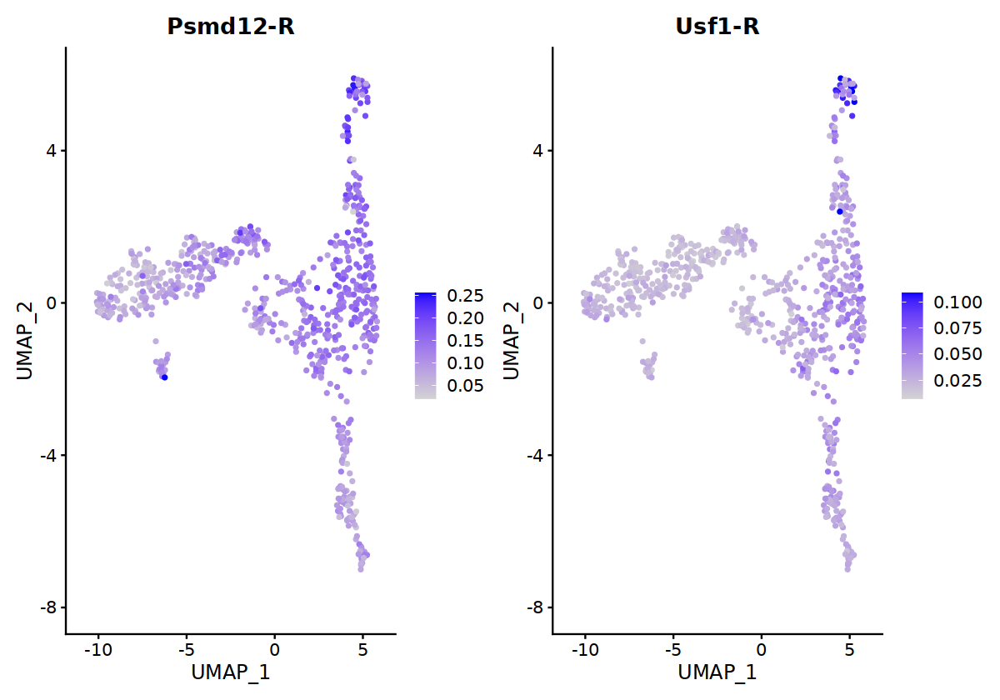

In [331]:
FeaturePlot(mer,"Psmd12-R")|FeaturePlot(mer,"Usf1-R",max.cutoff = "q99")

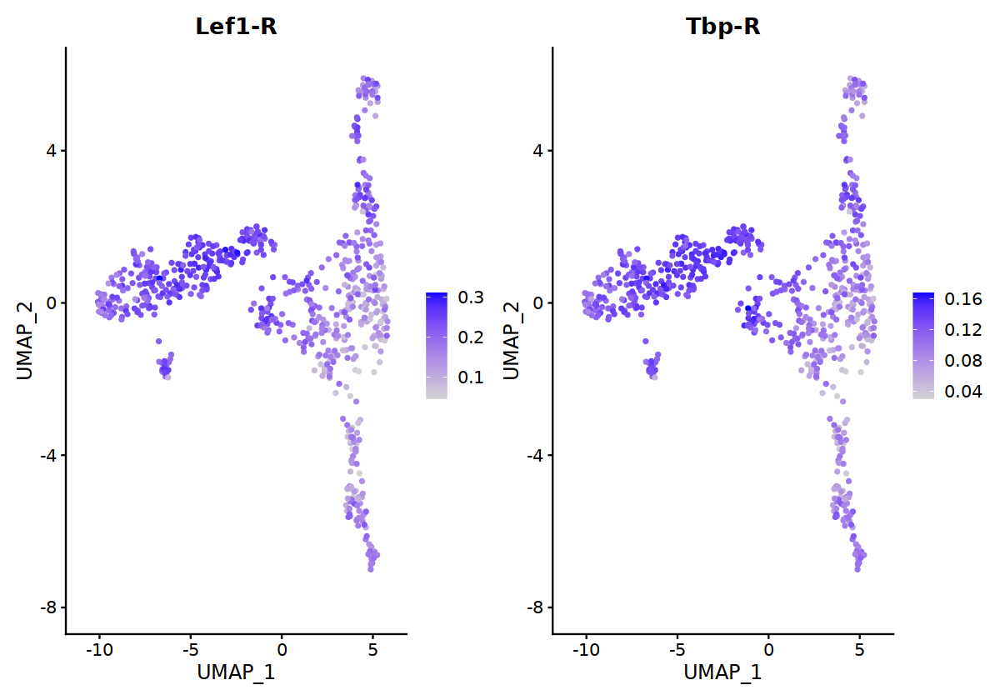

In [270]:
FeaturePlot(mer,"Lef1-R")|FeaturePlot(mer,"Tbp-R") 

Warning message:
“Could not find Tbl1xr1-R in the default search locations, found in regulon assay instead”


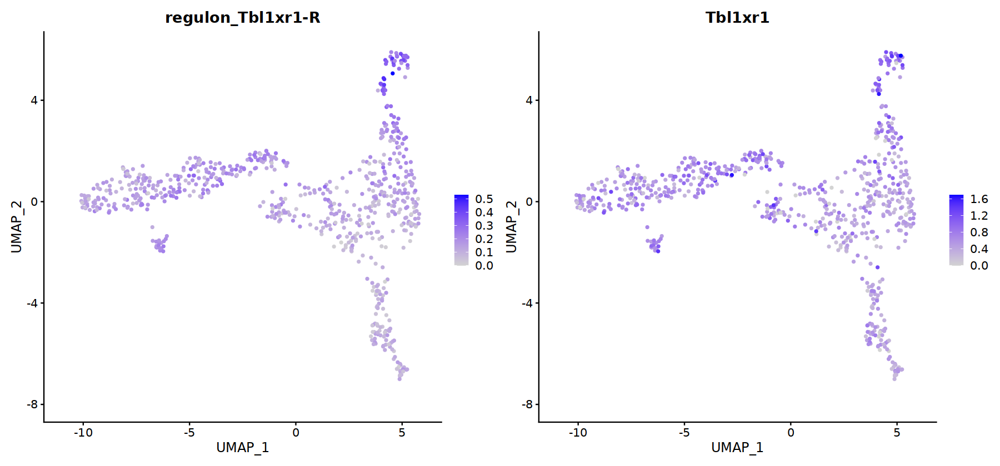

In [493]:
FeaturePlot(mer,"Tbl1xr1-R")|FeaturePlot(mer,"Tbl1xr1")

Warning message:
“Could not find Foxj3-R in the default search locations, found in regulon assay instead”
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Warning message:
“Could not find Tbl1xr1-R in the default search locations, found in regulon assay instead”
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Warning message:
“Could not find Psmd12-R in the default search locations, found in regulon assay instead”
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Warning message:
“Could not find Ep300-R in the default search locations, found in regulon assay instead”
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Warning message:
“Could not find Tfdp1-R in the default search locations, found in regulon assay instead”
Scale for colour is already pre

png 
  2

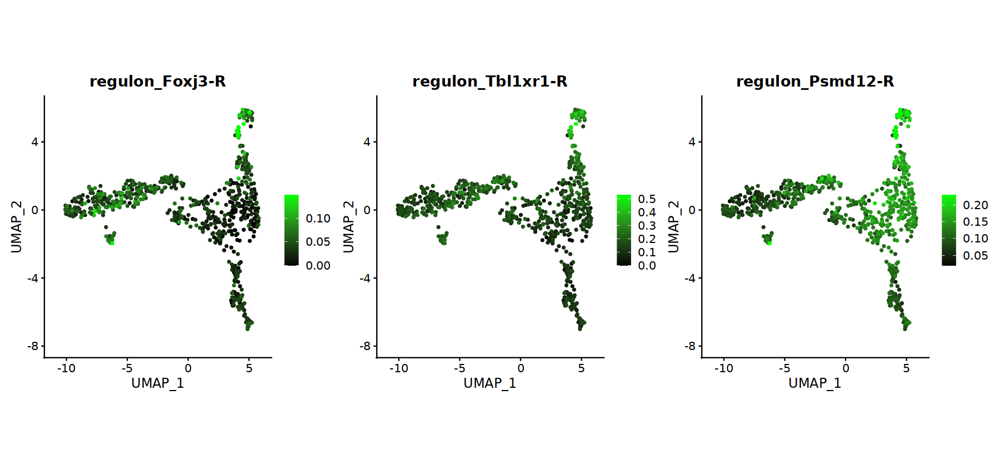

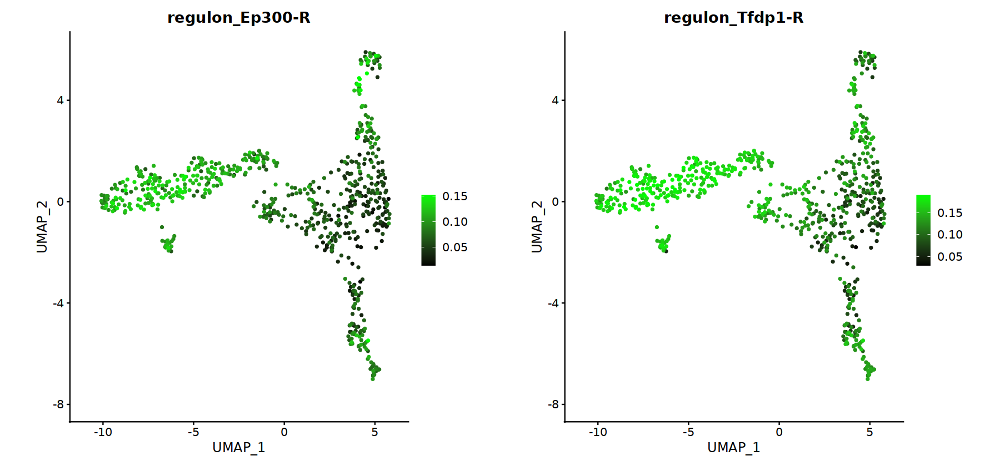

In [487]:
pdf("regulons_gene.pdf",width=15,height=8)
p1=FeaturePlot(mer,"Foxj3-R",max.cutoff = "q99",order=T)+coord_fixed(ratio = 1.4)+scale_color_gradientn(colours = c("black","green"))|FeaturePlot(mer,"Tbl1xr1-R",order=T)+coord_fixed(ratio = 1.4)+scale_color_gradientn(colours = c("black","green"))|FeaturePlot(mer,"Psmd12-R",max.cutoff = "q99",order=T)+coord_fixed(ratio = 1.4)+scale_color_gradientn(colours = c("black","green"))
p2=FeaturePlot(mer,"Ep300-R",max.cutoff = "q99",order=T)+coord_fixed(ratio = 1.4)+scale_color_gradientn(colours = c("black","green"))|FeaturePlot(mer,"Tfdp1-R",max.cutoff = "q99",order=T)+coord_fixed(ratio = 1.4)+scale_color_gradientn(colours = c("black","green"))
p1/p2
dev.off()
p1
p2

Warning message:
“Could not find Lef1-R in the default search locations, found in regulon assay instead”
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


png 
  2

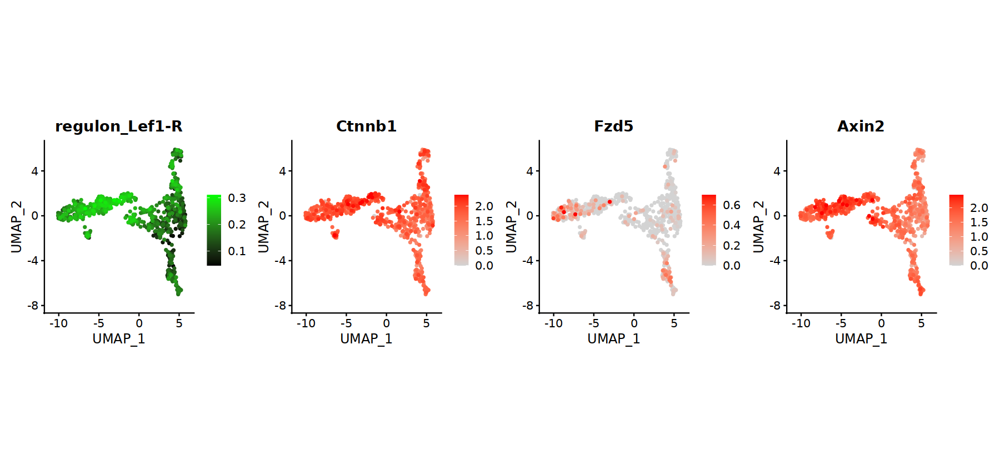

In [488]:
pdf("Wnt_regulon_gene.pdf",width=15,height=4)
p=FeaturePlot(mer,"Lef1-R",order=T)+coord_fixed(ratio = 1.4)+scale_color_gradientn(colours = c("black","green"))|FeaturePlot(mer,"Ctnnb1",max.cutoff = "q99",order=T)+coord_fixed(ratio = 1.4)+scale_color_gradientn(colours = c("lightgray","red"))|FeaturePlot(mer,"Fzd5",max.cutoff = "q99",order=T)+coord_fixed(ratio = 1.4)+scale_color_gradientn(colours = c("lightgray","red"))|FeaturePlot(mer,"Axin2",max.cutoff = "q99",order=T)+coord_fixed(ratio = 1.4)+scale_color_gradientn(colours = c("lightgray","red"))
p
dev.off()
p

In [492]:
go_list$

[1] "Parp1"   "Fkbp1a"  "Smad1"   "Smad2"   "Smad3"   "Smad4"   "Smad6"  
 [8] "Ppm1a"   "Tgfb1"   "Ldlrad4" "Tbx20"   "Pmepa1"  "Eid2"

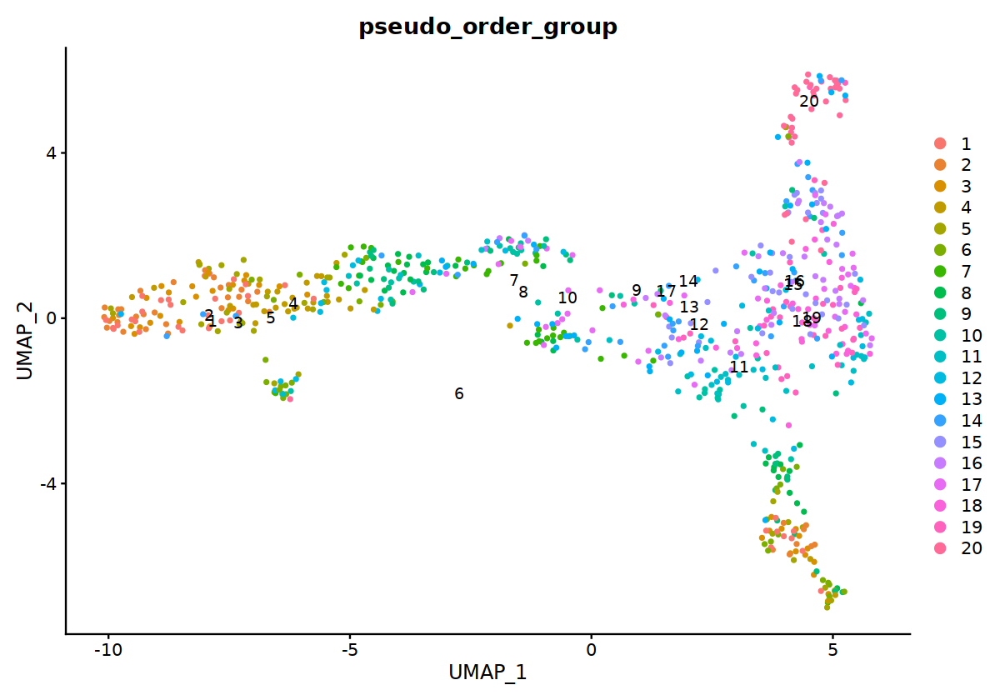

In [276]:
DimPlot(mer,group.by = "pseudo_order_group",label=T)

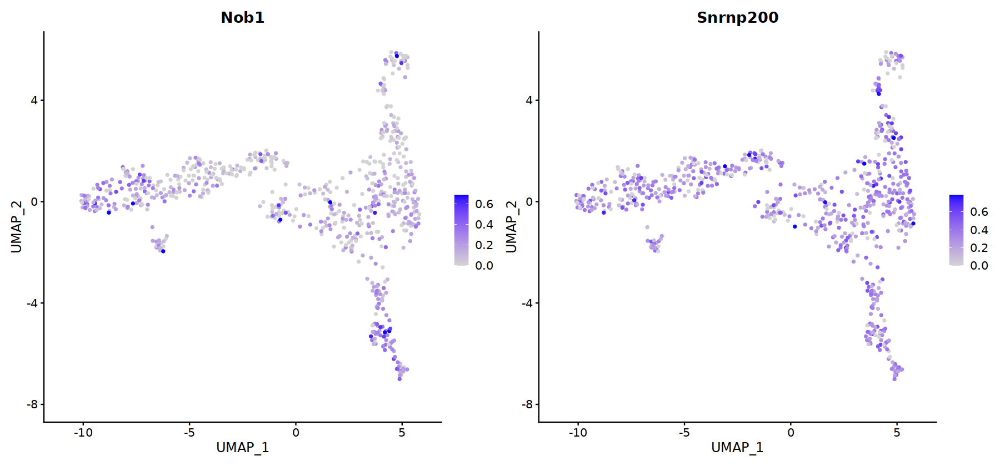

In [491]:
FeaturePlot(mer,"Nob1" ,max.cutoff="q99")|FeaturePlot(mer,"Snrnp200",max.cutoff="q99") 

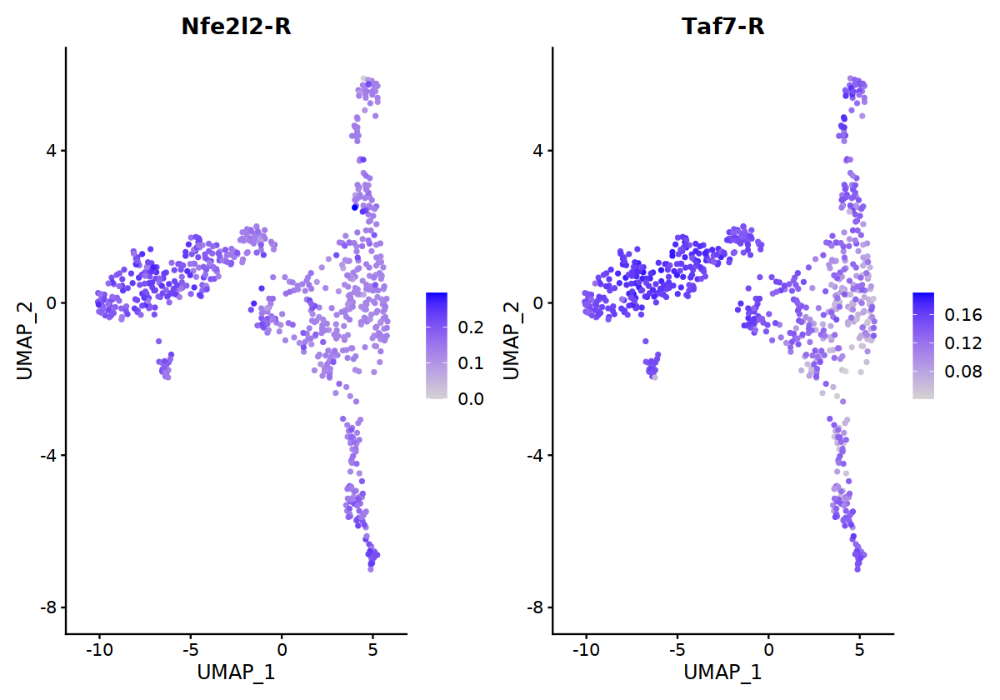

In [280]:
FeaturePlot(mer,"Nfe2l2-R")|FeaturePlot(mer,"Taf7-R") 

Warning message:
“Could not find Adgrg2 in the default search locations, found in RNA assay instead”
Warning message:
“Could not find Adgrg1 in the default search locations, found in RNA assay instead”


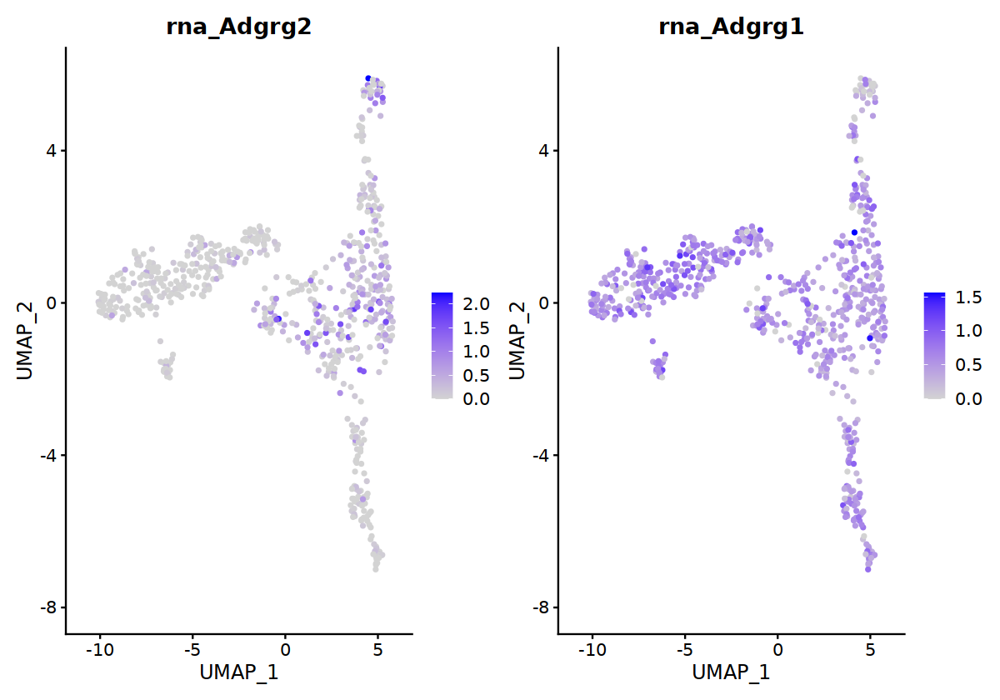

In [283]:
FeaturePlot(mer,"Adgrg2")|FeaturePlot(mer,"Adgrg1")

Warning message:
“Could not find Irf1 in the default search locations, found in RNA assay instead”


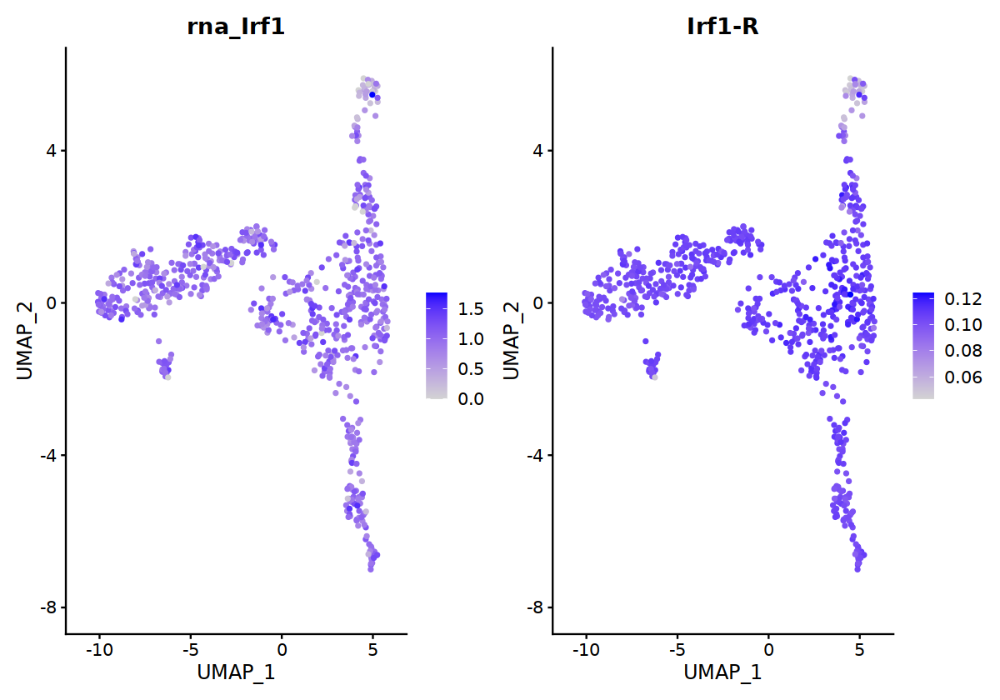

In [284]:
FeaturePlot(mer,"Irf1")|FeaturePlot(mer,"Irf1-R")

Warning message:
“Could not find Lgr5 in the default search locations, found in RNA assay instead”
Warning message:
“Could not find Axin2 in the default search locations, found in RNA assay instead”


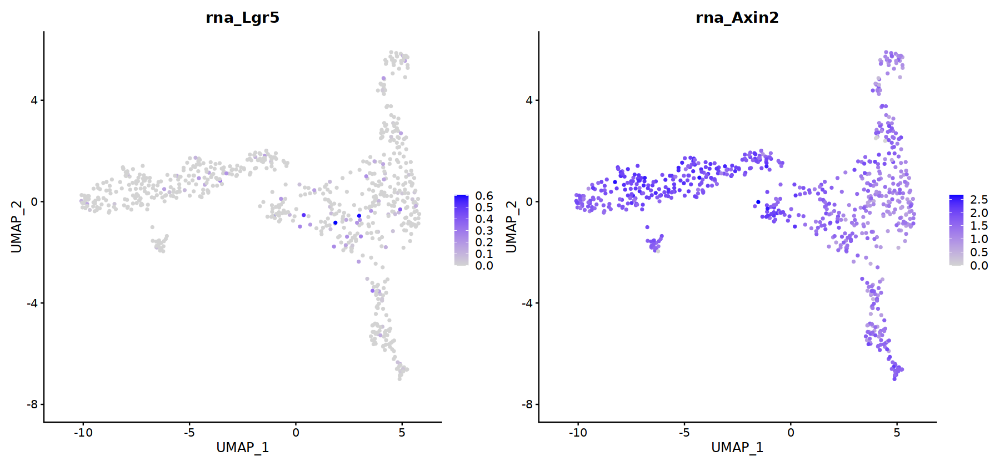

In [348]:
FeaturePlot(mer,"Lgr5")|FeaturePlot(mer,"Axin2")

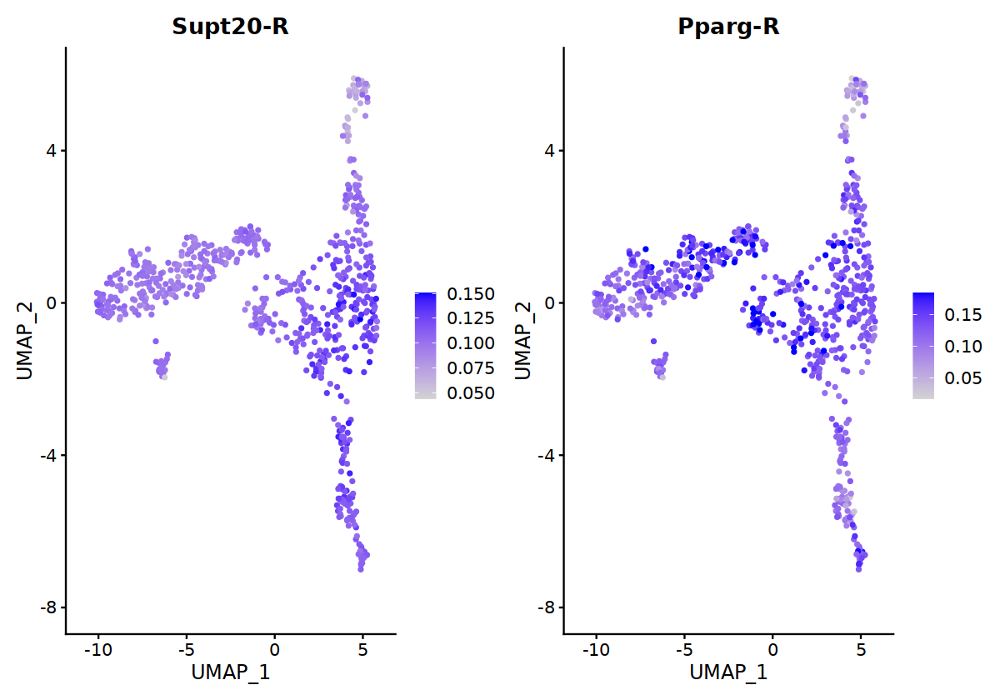

In [288]:
FeaturePlot(mer,"Supt20-R")|FeaturePlot(mer,"Pparg-R",max.cutoff = "q95")

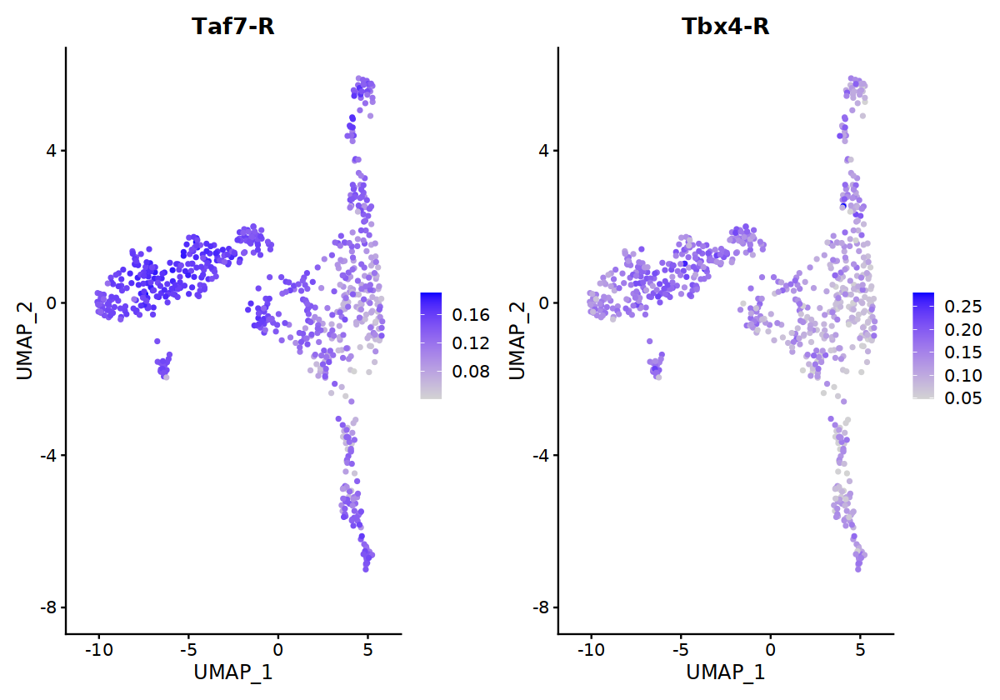

In [289]:
FeaturePlot(mer,"Taf7-R")|FeaturePlot(mer,"Tbx4-R")

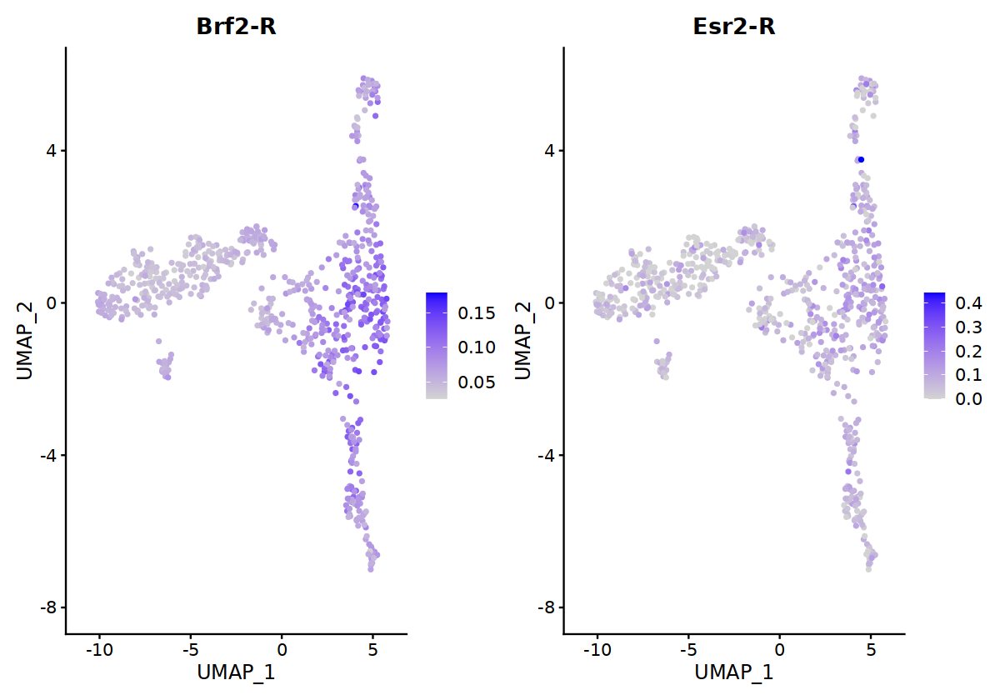

In [290]:
FeaturePlot(mer,"Brf2-R")|FeaturePlot(mer,"Esr2-R",max.cutoff) # Secondary Oocyte

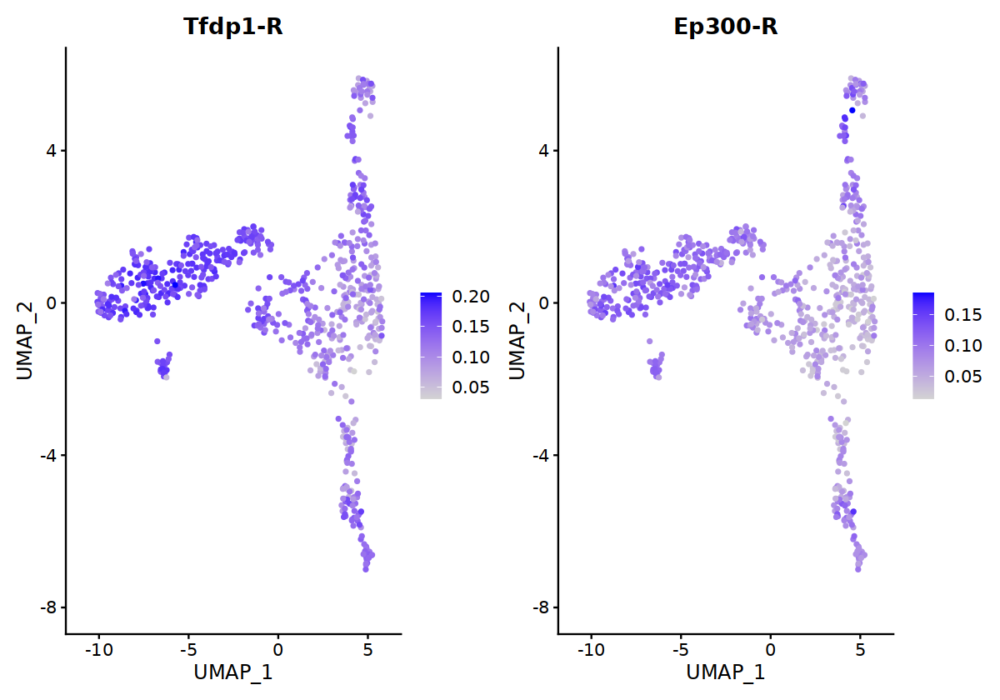

In [291]:
FeaturePlot(mer,"Tfdp1-R")|FeaturePlot(mer,"Ep300-R") # Chromatin

Warning message:
“Could not find Tfdp1 in the default search locations, found in RNA assay instead”
Warning message:
“Could not find Ep300 in the default search locations, found in RNA assay instead”


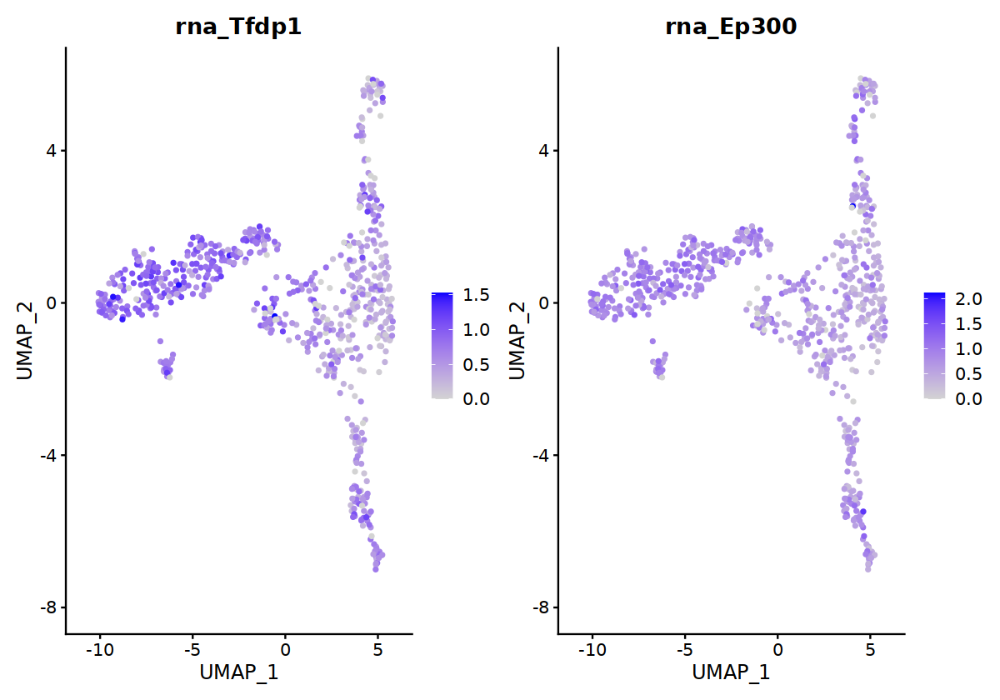

In [292]:
FeaturePlot(mer,"Tfdp1")|FeaturePlot(mer,"Ep300") # Chromatin

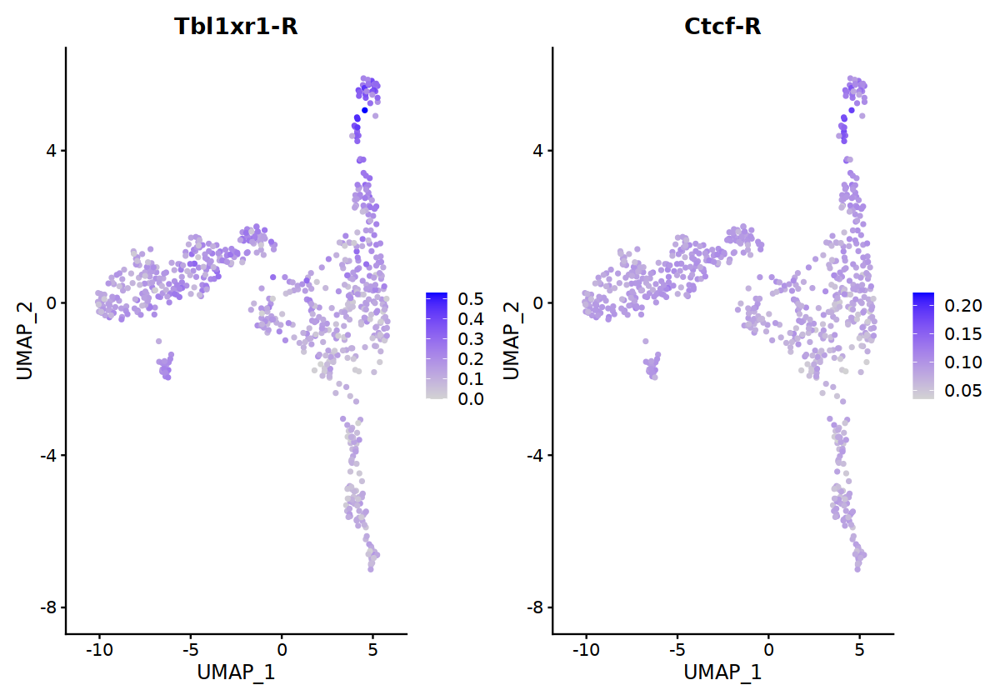

In [336]:
FeaturePlot(mer,"Tbl1xr1-R")|FeaturePlot(mer,"Ctcf-R") # 

In [457]:
FeaturePlot(mer,"Prkca-R")|FeaturePlot(mer,"Tbx2-R") # 

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Prkca-R”


ERROR: Error: None of the requested features were found: Prkca-R in slot data


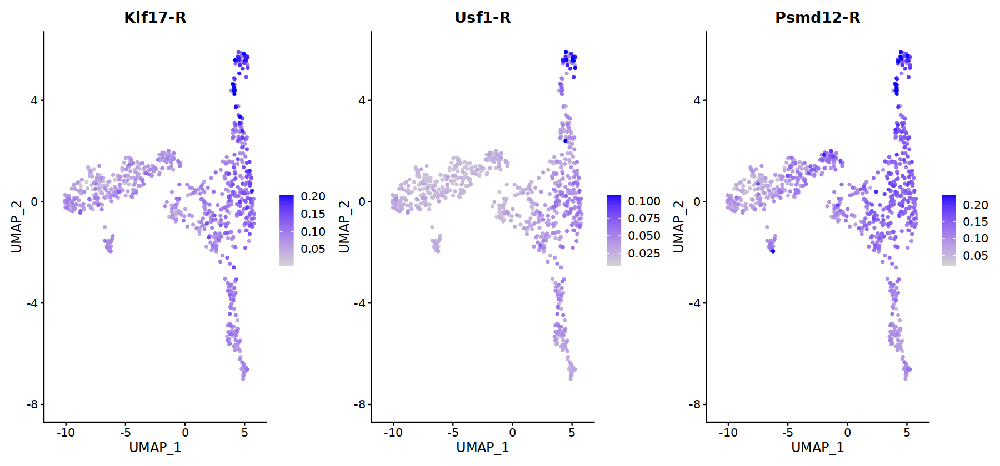

In [341]:
options(repr.plot.width=15)
FeaturePlot(mer,"Klf17-R",max.cutoff="q99",order=T)|FeaturePlot(mer,"Usf1-R",max.cutoff="q99",order=T) |FeaturePlot(mer,"Psmd12-R",max.cutoff="q99",order=T) # Secondary Oocyte

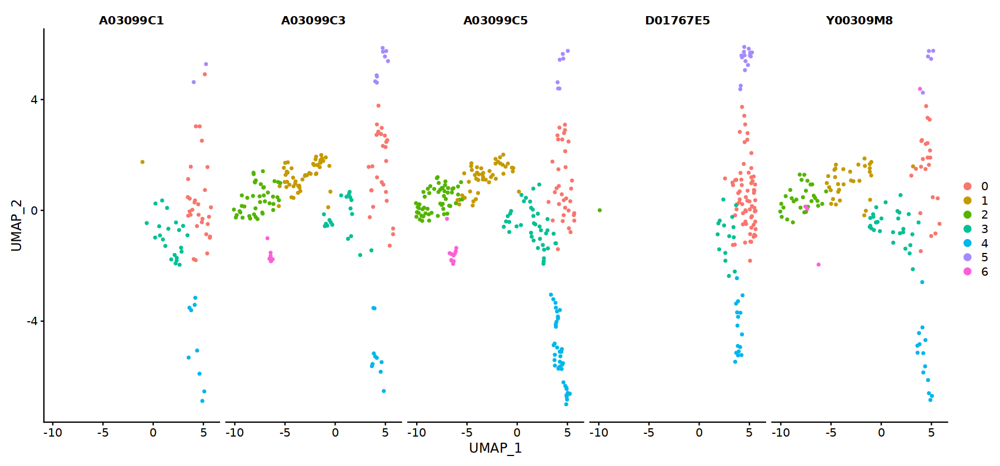

In [41]:
options(repr.plot.width=15)
DimPlot(mer,split.by="sample")

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for x is already present.
Adding another scale for x, which will replace the existing scale.
Scale for y is already present.
Adding another scale for y, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for x is already present.
Adding another scale for x, which will replace the existing scale.
Scale for y is already present.
Adding another scale for y, which will replace the existing scale.


png 
  2

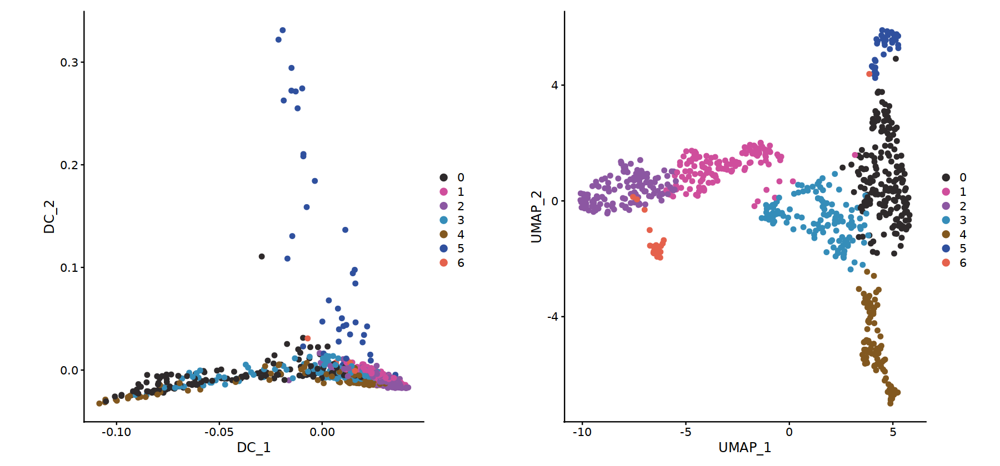

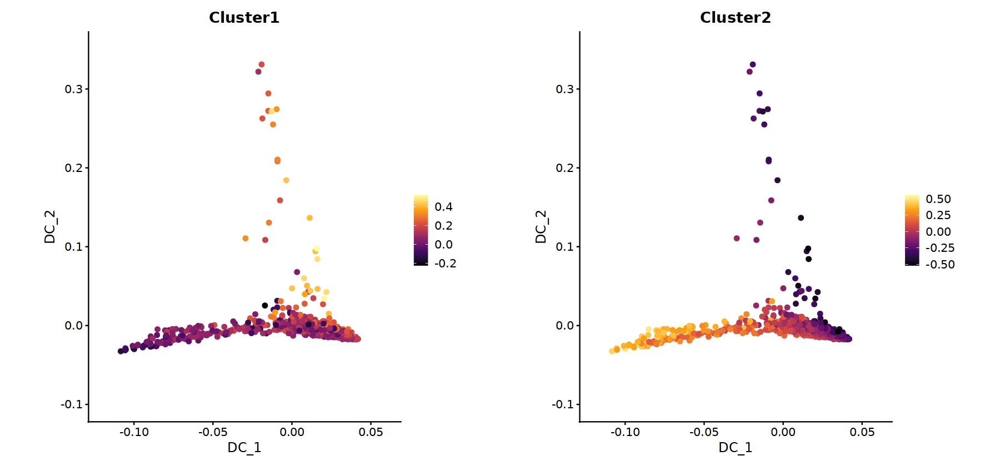

In [46]:
pdf("Diffutionmap.dimplot.M.GV.pdf",width=12,height = 12)
p1=DimPlot(mer,reduction = "dm",pt.size = 2)+ggsci::scale_color_cosmic()+coord_fixed(ratio = 0.5) | DimPlot(mer,reduction = "umap",pt.size = 2)+ggsci::scale_color_cosmic()+coord_fixed(ratio = 1.4)
p2=FeaturePlot(mer,features = "Cluster1",reduction = "dm",pt.size=2)+coord_fixed(ratio = 0.5)+scale_color_viridis_c(option = "B",direction = 1)+xlim(-0.12,0.06)+ylim(-0.1,0.35)|FeaturePlot(mer,features = "Cluster2",reduction = "dm",pt.size=2)+coord_fixed(ratio = 0.5)+scale_color_viridis_c(option = "B",direction = 1)+xlim(-0.12,0.06)+ylim(-0.1,0.35)
p1/p2
dev.off()
p1
p2

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for x is already present.
Adding another scale for x, which will replace the existing scale.
Scale for y is already present.
Adding another scale for y, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


png 
  2

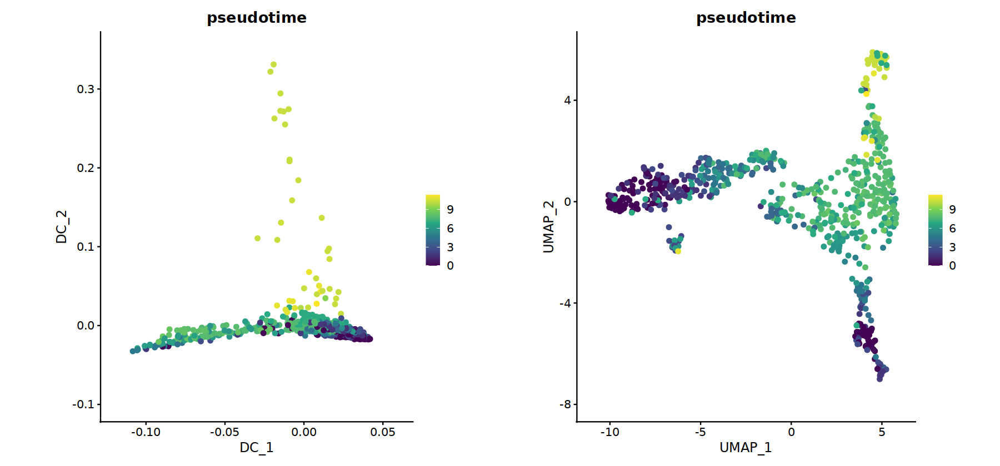

In [446]:
pdf("Trajectory.featurePlot.pdf",width=12,height = 6)
p1=FeaturePlot(mer,features = "pseudotime",reduction = "dm",pt.size=2)+coord_fixed(ratio = 0.5)+scale_color_viridis_c()+xlim(-0.12,0.06)+ylim(-0.1,0.35)
p2=FeaturePlot(mer,reduction = "umap",pt.size = 2,"pseudotime")+scale_color_viridis_c()+coord_fixed(ratio = 1.4)
p1|p2
dev.off()
p1|p2

In [41]:
go_list=readRDS("/hwfssz5/ST_SUPERCELLS/P21Z10200N0090/haoshijie/software/GO_KEGG.db/AllBP.gene.rds")

In [459]:
go_list$`Wnt signaling pathway`

[1] "Abl1"          "Abl2"          "Macf1"         "Apc"          
  [5] "Xiap"          "Apoe"          "App"           "Arntl"        
  [9] "Atp6v0c"       "Axin1"         "Axin2"         "Barx1"        
 [13] "Bcl7b"         "Bmp2"          "Btrc"          "Aspm"         
 [17] "Ctnnb1"        "Ctnnd1"        "Cav1"          "Ccnd1"        
 [21] "Ccne1"         "Cd44"          "Cdh1"          "Cdh2"         
 [25] "Cdh3"          "Celsr1"        "Col1a1"        "Cpe"          
 [29] "Csnk2a1"       "Csnk2a2"       "Csnk2b"        "Dab2"         
 [33] "Dapk3"         "Ddb1"          "Ddit3"         "Ddx3x"        
 [37] "Dkk1"          "Dlx5"          "Drd2"          "Dvl1"         
 [41] "Dvl2"          "Dvl3"          "Eda"           "Egf"          
 [45] "Egfr"          "Egr1"          "Emd"           "Mark2"        
 [49] "Epm2a"         "Etv2"          "Ext1"          "Lgr5"         
 [53] "Fgf10"         "Fgf2"          "Fgf9"          "Fgfr2"        
 [57] "Fgfr3"         "Foxl1"         "Folr1"         "Frat1"        
 [61] "Fzd1"          "Fzd3"          "Fzd4"          "Fzd5"         
 [65] "Fzd6"          "Fzd7"          "Fzd8"          "Fzd9"         
 [69] "Gata3"         "Gli1"          "Gli3"          "Gnaq"         
 [73] "Gpc3"          "Gpc4"          "Grk5"          "Grb10"        
 [77] "Tle5"          "Gsc"           "Hdac2"         "Hesx1"        
 [81] "Hhex"          "Hic1"          "Hmga2"         "Ilk"          
 [85] "Ins2"          "Invs"          "Isl1"          "Itga3"        
 [89] "Jrk"           "Mdfic"         "Klf4"          "Krt6a"        
 [93] "Lats1"         "Ldb1"          "Lect2"         "Lef1"         
 [97] "Lrp1"          "Lrp5"          "Lrp6"          "Smad3"        
[101] "Mbd2"          "Mdfi"          "Mdk"           "Mesp1"        
[105] "Mgat3"         "Mitf"          "Usp34"         "Myc"          
[109] "Myoc"          "Ndp"           "Nfkb1"         "Nkx2-5"       
[113] "Nlk"           "Nog"           "Notch1"        "Ctnnd2"       
[117] "Nxn"           "Cdk14"         "Pitx2"         "Pkd1"         
[121] "Pkd2"          "Pou5f1"        "Ppm1a"         "Ppm1b"        
[125] "Prop1"         "Psen1"         "Pten"          "Ptpru"        
[129] "Ptpro"         "Rac1"          "Rbpj"          "Ruvbl2"       
[133] "Ryk"           "Sfrp2"         "Sema5a"        "Sfrp1"        
[137] "Frzb"          "Sfrp4"         "Shh"           "Siah2"        
[141] "Six3"          "Snai2"         "Smarca4"       "Sox10"        
[145] "Sox17"         "Sox2"          "Sox4"          "Sox7"         
[149] "Sox9"          "Spin1"         "Src"           "Stk11"        
[153] "Wnt8a"         "Sdc1"          "Tbl1x"         "Hnf1a"        
[157] "Hnf1b"         "Tcf7"          "Tcf7l1"        "Tcf7l2"       
[161] "Tert"          "Tgfb1"         "Tgfb1i1"       "Thra"         
[165] "Tiam1"         "Tle1"          "Tle2"          "Tle3"         
[169] "Tle4"          "Tnfaip3"       "Tnks"          "Ctr9"         
[173] "Tsc2"          "Ube2b"         "Kdm6a"         "Uty"          
[177] "Ccn4"          "Wnt1"          "Wnt10a"        "Wnt10b"       
[181] "Wnt11"         "Wnt9b"         "Wnt2"          "Wnt2b"        
[185] "Wnt3"          "Wnt3a"         "Wnt4"          "Wnt5a"        
[189] "Wnt5b"         "Wnt6"          "Wnt7a"         "Wnt7b"        
[193] "Wnt8b"         "Yap1"          "Amfr"          "Apc2"         
[197] "Grem1"         "Pin1"          "Tlr2"          "Vax2"         
[201] "Wif1"          "Zeb2"          "Grk6"          "Mapk14"       
[205] "Cul3"          "Ror1"          "Ror2"          "Slc9a3r1"     
[209] "Brd7"          "G3bp1"         "Csnk1e"        "Peg12"        
[213] "Limd1"         "Ndrg2"         "Fbxw4"         "Lats2"        
[217] "Dkkl1"         "Dkk3"          "Prkn"          "Reck"         
[221] "Porcn"         "Celsr2"        "Snx3"          "Sfrp5"        
[225] "Paf1"          "Ift20"         "Stk3"          "Arl6"         
[229] "Amotl

In [42]:
mer@active.assay="RNA"
mer=AddModuleScore(mer,features = list(go_list$`Wnt signaling pathway`),name = "WNT")
mer=AddModuleScore(mer,features = list( go_list$`response to transforming growth factor beta` ),name = "TGFb")

Warning message:
“The following features are not present in the object: Etv2, Foxl1, Fzd9, Tle5, Prop1, Six3, Ccn4, Wnt1, Wnt8b, Prkn, Notum, Amer3, Nppa, Mir20a, Mir154, Mir15a, Mir182, Mir195a, Mir196a-1, Mir27b, Mir29b-1, Mir200a, Mir200b, Mir221, Mir222, Mir32, Mir93, Mir224, Mir106b, Mir196a-2, Hm629797, Tle7, not searching for symbol synonyms”
Warning message:
“The following features are not present in the object: Foxh1, Nkx2-1, Wnt1, Lrg1, Wfikkn1, Dusp15, Mir21a, Mir155, Mir192, not searching for symbol synonyms”


In [ ]:
p=FeaturePlot(mer,"WNT1")+scale_color_viridis_c(option = "B")+coord_fixed(ratio = 1.4)|FeaturePlot(mer,"TGFb1")+scale_color_viridis_c(option="B")+coord_fixed(ratio = 1.4)
p
ggsave("WNT_TGFb1.umap.pdf",width=12,height = 6,plot=p)

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


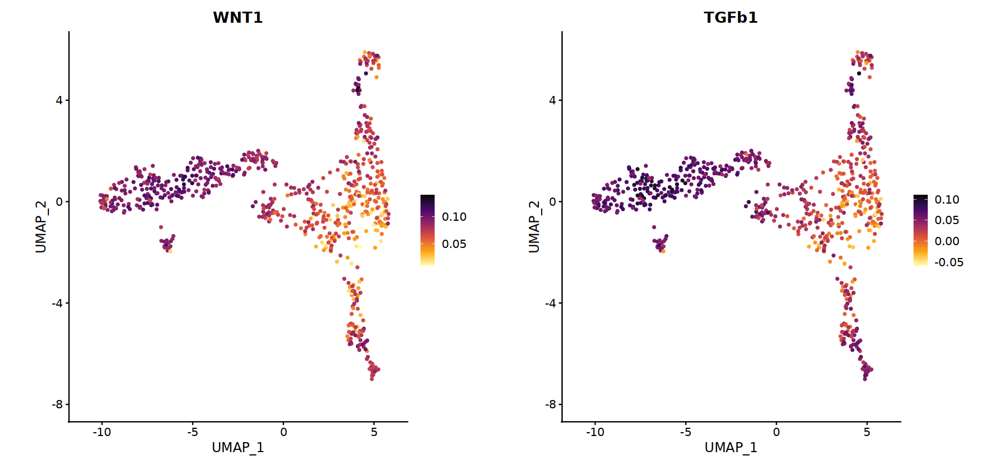

In [45]:
options(repr.plot.height=7)
p=FeaturePlot(mer,"WNT1")+scale_color_viridis_c(option = "B",direction = -1)+coord_fixed(ratio = 1.4)|FeaturePlot(mer,"TGFb1")+scale_color_viridis_c(option="B",direction=-1)+coord_fixed(ratio = 1.4)
p
ggsave("WNT_TGFb1.umap.pdf",width=12,height = 6,plot=p)

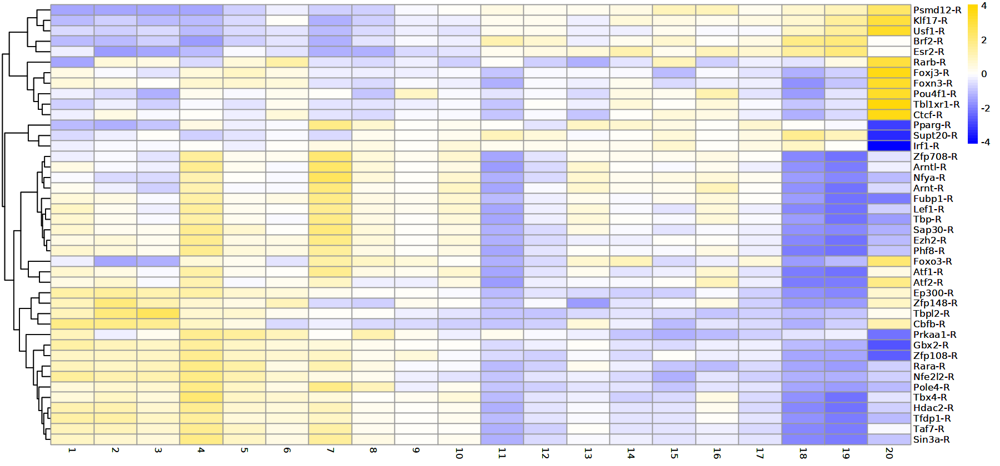

In [425]:
p=pheatmap::pheatmap(AveReg,cluster_cols = F,scale="row",color = colorRampPalette(c("blue","white","gold1"))(50))
p
ggsave(filename = "Trajectory_regulon.pheatmap.pdf",width=9,height = 7,plot=p)

In [42]:
anno=df[,c(1,3,4,5)]
anno=as.data.frame(anno)
rownames(anno)=anno[,1]
anno=anno[,-1]

In [127]:
regulon=read.table("/hwfssz1/ST_SUPERCELLS/P22Z10200N0661/haoshijie/FIGURE4/Scenic/test/Oocyte.auc_mtx.tsv",header=T,row.names = 1)

In [128]:
rownames(regulon)=sub("\\(\\+","",rownames(regulon))
rownames(regulon)=sub("\\)","",rownames(regulon))
rownames(regulon)=sub("$","_R",rownames(regulon))

In [181]:
reg_assay=CreateAssayObject(counts=as.matrix(regulon),min.cells = 10)

Warning message:
“Feature names cannot have underscores ('_'), replacing with dashes ('-')”


In [192]:
mer[["regulon"]]=reg_assay

In [209]:
mer@active.assay="regulon"

In [43]:
test=AveExp$RNA
lab.row=rownames(test)
lab.row[!lab.row %in% c("Klhl21","Fzd5","Tbl1xr1","Usf1","Dcp2","H1foo","Lef1","Axin2","Tgfbr1","Tgfbr3","Psmd12","EP300","Tfdp1","Foxj3","Ctnnb1","Klf17","Ctcf","Esr2","Brf2","Taf7","Tbx4","Pparg","Supt20","Irf1","Nfe2l2","Tbp","Dnmt1","Gdf9","Bmp15","Oosp1")]=""

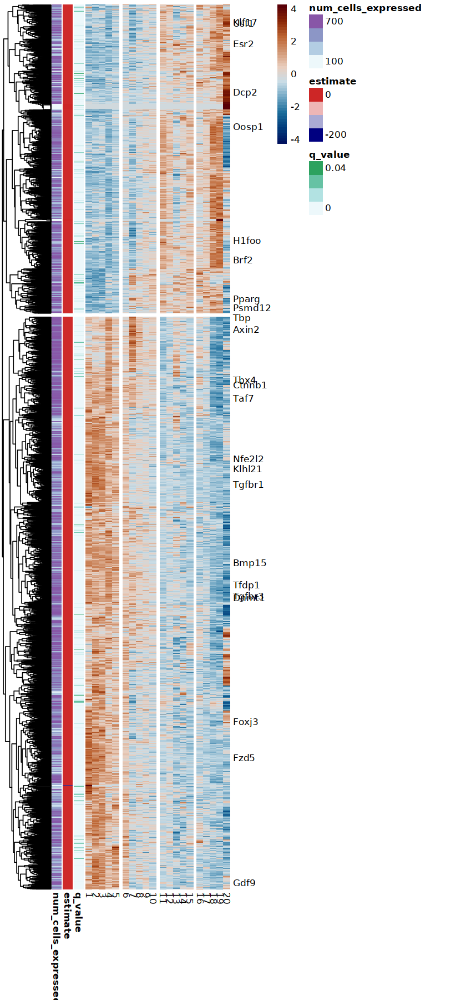

In [31]:
options(repr.plot.height=15)
set.seed(6)
p=pheatmap::pheatmap(test,cluster_cols = F,scale="row",cutree_rows = 2,annotation_row = anno,labels_row = lab.row,color = colorRampPalette(colors = scico::scico(palette = "vik",n=10))(50),
                   annotation_colors = list(estimate=colorRampPalette(colors = c("navy","white","firebrick3"))(10)),gaps_col = cumsum(c(5,5,5)))
ggsave(filename = "Trajectory_gene.pheatmap.pdf",width=9,height=12,plot=p)

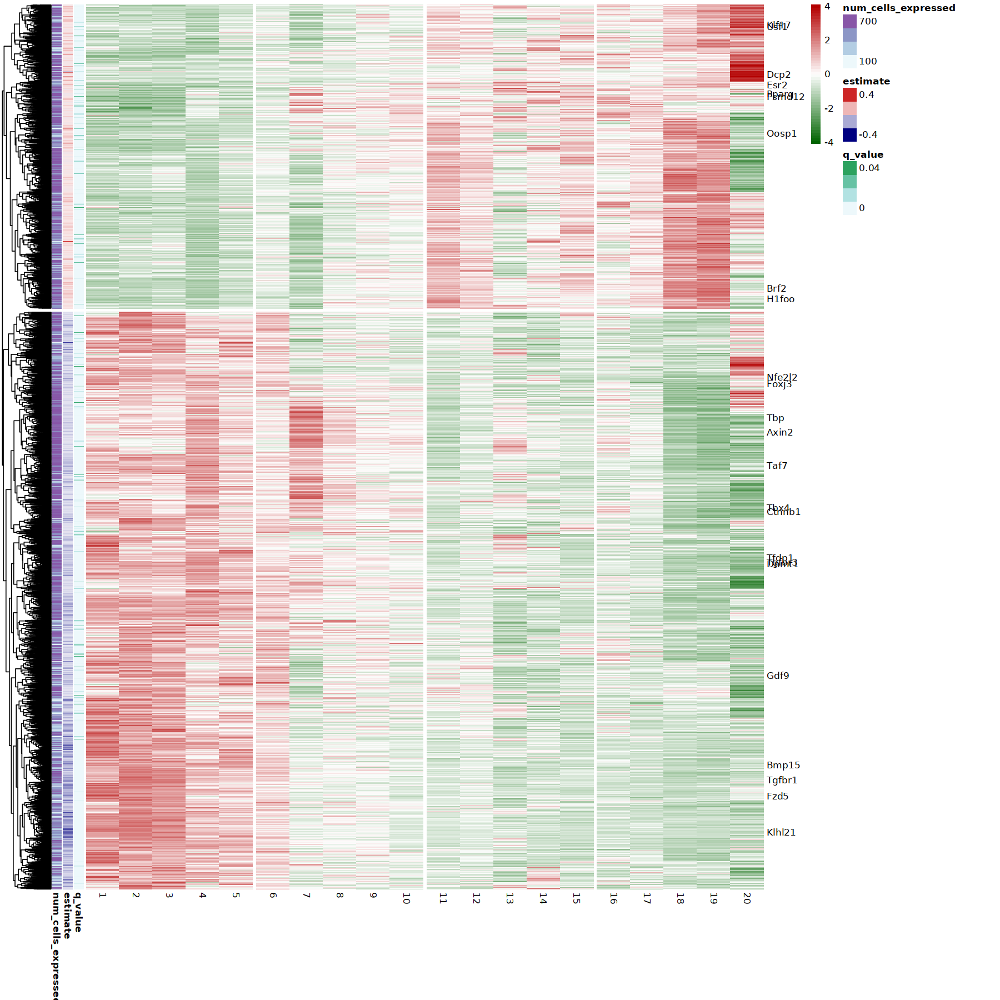

In [496]:
options(repr.plot.height=15)
p=pheatmap::pheatmap(test,cluster_cols = F,scale="row",cutree_rows = 2,annotation_row = anno,labels_row = lab.row,color = colorRampPalette(colors = c("darkgreen","white",rgb(180/255,0,0)))(50),
                   annotation_colors = list(estimate=colorRampPalette(colors = c("navy","white","firebrick3"))(10)),gaps_col = cumsum(c(5,5,5)))


In [39]:
pdf("nFeature_RNA.pdf",width=5,height=5)
VlnPlot(mer,"nFeature_RNA",group.by="sample")
dev.off()

png 
  2

In [2]:
Ep300=read.table("/hwfssz1/ST_SUPERCELLS/P22Z10200N0661/haoshijie/FIGURE4/Scenic/test/Ep300.target.list")

In [11]:
res1=enrichGO(Ep300$V1,OrgDb = "org.Mm.eg.db",keyType = "SYMBOL",ont = "BP")

In [37]:
pdf("Ep300_Tfdp1.targetgene.go.pdf",width=9,height=4)
dotplot(res1,showCategory=5)+dotplot(res2,showCategory=5)
dev.off()

png 
  2

Warning message:
“Could not find Apc in the default search locations, found in RNA assay instead”
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


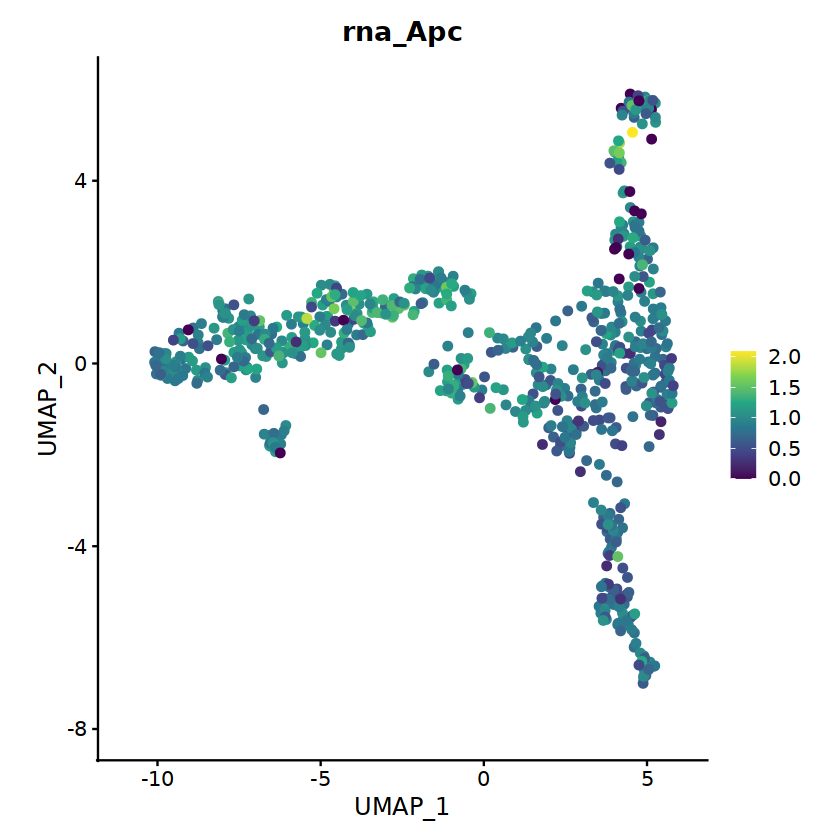

In [30]:
library(Seurat)
library(ggplot2)
FeaturePlot(mer,reduction = "umap",pt.size = 2,features = "Apc")+scale_color_viridis_c()+coord_fixed(ratio = 1.4)

In [5]:
Tfdp1=read.table("Scenic//test/Tfdp1.target.list")

In [13]:
res2=enrichGO(Tfdp1$V1,OrgDb = "org.Mm.eg.db",keyType = "SYMBOL",ont="BP")

In [19]:
Ep300$V1

[1] "9230112D13Rik" "Acly"          "Acsl1"         "Add3"         
  [5] "Adgrg1"        "Agap3"         "Ahr"           "Asap1"        
  [9] "Atp1b1"        "Atxn1l"        "Azin1"         "Calcb"        
 [13] "Camsap2"       "Carmil1"       "Ccdc171"       "Ccdc71l"      
 [17] "Cdc42"         "Cdkl5"         "Cdyl"          "Cxcr2"        
 [21] "Dse"           "Efna5"         "Elk1"          "Ell"          
 [25] "Ep300"         "Fam117b"       "Fam126b"       "Fam49a"       
 [29] "Fam53c"        "Fbxo11"        "Fcho2"         "Fnip1"        
 [33] "Foxn2"         "Galnt3"        "Gm15413"       "Gm19757"      
 [37] "Golga4"        "Gria4"         "Gzf1"          "Hnf1b"        
 [41] "Hnrnpl"        "Hpse"          "Il17rd"        "Ino80d"       
 [45] "Ints8"         "Itga8"         "Itgb1"         "Kit"          
 [49] "Klhl26"        "Knl1"          "Marcks"        "Med13"        
 [53] "Mllt10"        "Mpp5"          "Msrb3"         "Mtpn"         
 [57] "N4bp2"         "Nedd9"         "Nemf"          "Neurog1"      
 [61] "Nfkb1"         "Nipbl"         "Npas3"         "Nufip2"       
 [65] "Numb"          "Osbpl8"        "Otud4"         "Pag1"         
 [69] "Pard3"         "Pdzd8"         "Phip"          "Phlpp2"       
 [73] "Pik3c2a"       "Pkp4"          "Polk"          "Ppard"        
 [77] "Ppargc1b"      "Ppp1cb"        "Prkg1"         "Rif1"         
 [81] "Rnd3"          "Rnf2"          "Rtn4"          "Runx1t1"      
 [85] "Sec22c"        "Sec62"         "Sept7"         "Sh2b3"        
 [89] "Shank2"        "Slc45a3"       "Smarcad1"      "Sod2"         
 [93] "Sorbs2"        "Spred1"        "Srsf11"        "Stag2"        
 [97] "Strip2"        "Tbccd1"        "Thoc2"         "Tmcc1"        
[101] "Tmem184b"      "Tnrc6b"        "Twf1"          "Ubl3"         
[105] "Vamp4"         "Vegfa"         "Washc4"        "Wdr82"        
[109] "Xpo7"          "Ywhag"         "Zdhhc5"        "Zfp516"       
[113] "Zfp518a"       "Zfyve27"

In [15]:
res2@result

,ID,Description,GeneRatio,BgRatio,pvalue,p.adjust,qvalue,geneID,Count
,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<int>
GO:1903311,GO:1903311,regulation of mRNA metabolic process,33/650,317/28943,3.196412e-13,1.532680e-09,1.032609e-09,Axin2/Ccnb1/Cirbp/Cnot1/Cnot6/Cpeb1/Dazl/Dyrk1a/E2f1/Eif4enif1/Fxr1/Hnrnpd/Hnrnpk/Khsrp/Larp4b/Papola/Parn/Pnpt1/Pum2/Rbm15/Rbm15b/Rbm39/Rest/Rock1/Sf1/Son/Srsf2/Srsf6/Tnrc6a/Tnrc6b/Tob1/Ythdf3/Zc3h14,33
GO:0016055,GO:0016055,Wnt signaling pathway,38/650,451/28943,3.755701e-12,6.859922e-09,4.621722e-09,Abl1/Amfr/Apc/Axin2/Ccne1/Ccnyl1/Cdh3/Csnk1e/Ctnnb1/Daam1/Dab2ip/Egr1/Ext1/Fgf9/Foxo1/Fzd7/Gli1/Gli3/Gnaq/Lef1/Mcc/Mitf/Nlk/Nphp4/Otud5/Pitx2/Pten/Rspo2/Siah1a/Smad3/Sox9/Strn/Tiam1/Ube2b/Usp47/Wnk1/Yap1/Zbtb33,38
GO:0198738,GO:0198738,cell-cell signaling by wnt,38/650,453/28943,4.291922e-12,6.859922e-09,4.621722e-09,Abl1/Amfr/Apc/Axin2/Ccne1/Ccnyl1/Cdh3/Csnk1e/Ctnnb1/Daam1/Dab2ip/Egr1/Ext1/Fgf9/Foxo1/Fzd7/Gli1/Gli3/Gnaq/Lef1/Mcc/Mitf/Nlk/Nphp4/Otud5/Pitx2/Pten/Rspo2/Siah1a/Smad3/Sox9/Strn/Tiam1/Ube2b/Usp47/Wnk1/Yap1/Zbtb33,38
GO:0016570,GO:0016570,histone modification,39/650,480/28943,5.946975e-12,7.128936e-09,4.802965e-09,Atrx/Atxn7/Brd4/Ctnnb1/Dnmt1/Dnmt3b/Ep300/Kansl1/Kansl2/Kdm5c/Kmt2c/Lef1/Msl3/Mtf2/Naa40/Nelfa/Nfyb/Nsd3/Phf8/Prdm1/Prkd1/Pwwp2a/Rcor1/Rcor3/Rest/Rif1/Rnf168/Rps6ka5/Satb1/Scml2/Sirt1/Suz12/Tada1/Taf1/Taf4/Tet3/Ube2b/Usp3/Wdr82,39
GO:0043414,GO:0043414,macromolecule methylation,32/650,338/28943,9.398489e-12,9.013151e-09,6.072414e-09,Atf7ip/Atrx/Brd4/Ctnnb1/Dnmt1/Dnmt3b/Dubr/Fam98b/Hells/Ilf3/Kansl1/Kansl2/Kmt2c/Mettl15/Mettl9/Mis18a/Mtf2/Nelfa/Nfyb/Nsd3/Ppm1d/Prdm1/Rab6a/Rbm15/Rbm15b/Rif1/Satb1/Sirt1/Suz12/Tdrkh/Tet3/Wdr82,32
GO:0032259,GO:0032259,methylation,33/650,382/28943,5.202586e-11,3.693644e-08,2.488512e-08,Atf7ip/Atrx/Brd4/Ctnnb1/Dnmt1/Dnmt3b/Dubr/Fam98b/Hells/Ilf3/Kansl1/Kansl2/Kmt2c/Mettl15/Mettl9/Mis18a/Mtf2/Nelfa/Nfyb/Nsd3/Ppm1d/Prdm1/Prdm13/Rab6a/Rbm15/Rbm15b/Rif1/Satb1/Sirt1/Suz12/Tdrkh/Tet3/Wdr82,33
GO:0060070,GO:0060070,canonical Wnt signaling pathway,29/650,300/28943,5.392181e-11,3.693644e-08,2.488512e-08,Amfr/Apc/Axin2/Ccnyl1/Cdh3/Csnk1e/Ctnnb1/Dab2ip/Egr1/Ext1/Fgf9/Foxo1/Fzd7/Gli1/Gli3/Gnaq/Lef1/Mcc/Nphp4/Otud5/Pten/Rspo2/Siah1a/Smad3/Sox9/Ube2b/Usp47/Wnk1/Yap1,29
GO:0030111,GO:0030111,regulation of Wnt signaling pathway,29/650,319/28943,2.339733e-10,1.402377e-07,9.448210e-08,Abl1/Amfr/Apc/Axin2/Ccnyl1/Cdh3/Csnk1e/Ctnnb1/Dab2ip/Egr1/Fgf9/Foxo1/Fzd7/Gli1/Gli3/Gnaq/Lef1/Mcc/Nlk/Nphp4/Otud5/Rspo2/Smad3/Sox9/Tiam1/Ube2b/Usp47/Wnk1/Yap1,29
GO:0035107,GO:0035107,appendage morphogenesis,21/650,175/28943,4.913557e-10,2.268467e-07,1.528330e-07,Atrx/Bcl2l11/Bmpr1a/Ctnnb1/Ext1/Fgf9/Fgfr1/Gli2/Gli3/Gnaq/Lef1/Map3k20/Pitx2/Rarb/Rdh10/Rspo2/Sall4/Sox9/Traf3ip1/Trp63/Ttbk2,21


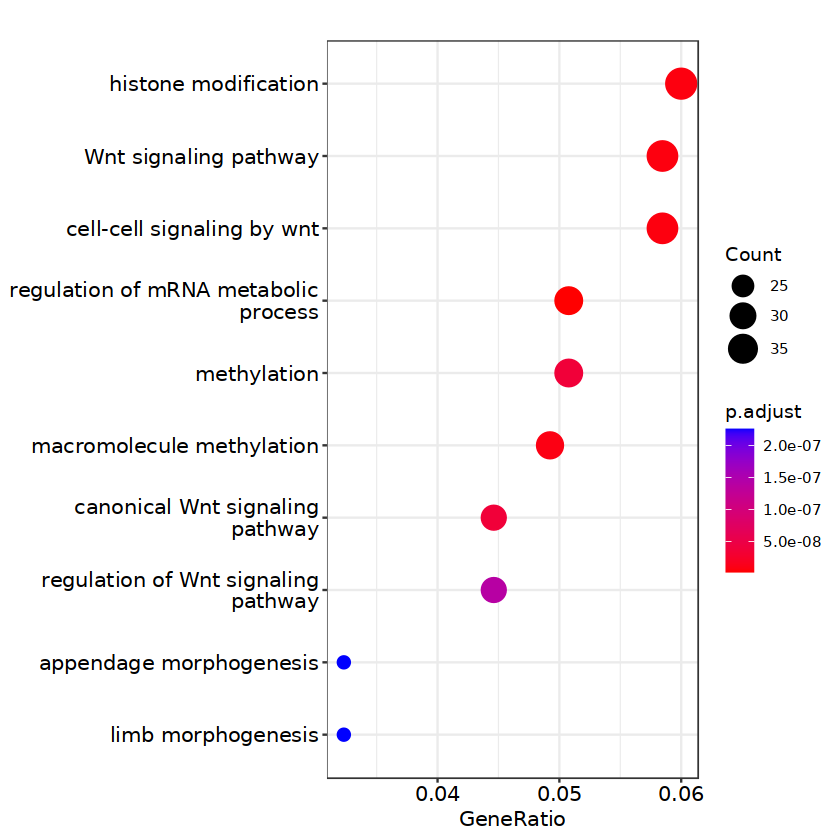

In [14]:
dotplot(res2)

In [409]:
ggsave(filename = "Trajectory_gene.pheatmap.pdf",width=9,height=12,plot=p)

In [392]:
res=enrichGO(gene = head(df$gene_short_name[ order(df$estimate,decreasing = T)],1000),OrgDb = "org.Mm.eg.db",keyType = "SYMBOL")

In [414]:
nrow(test)

[1] 5934

In [35]:
table(df$estimate>0)


FALSE  TRUE 
 3913  2111 

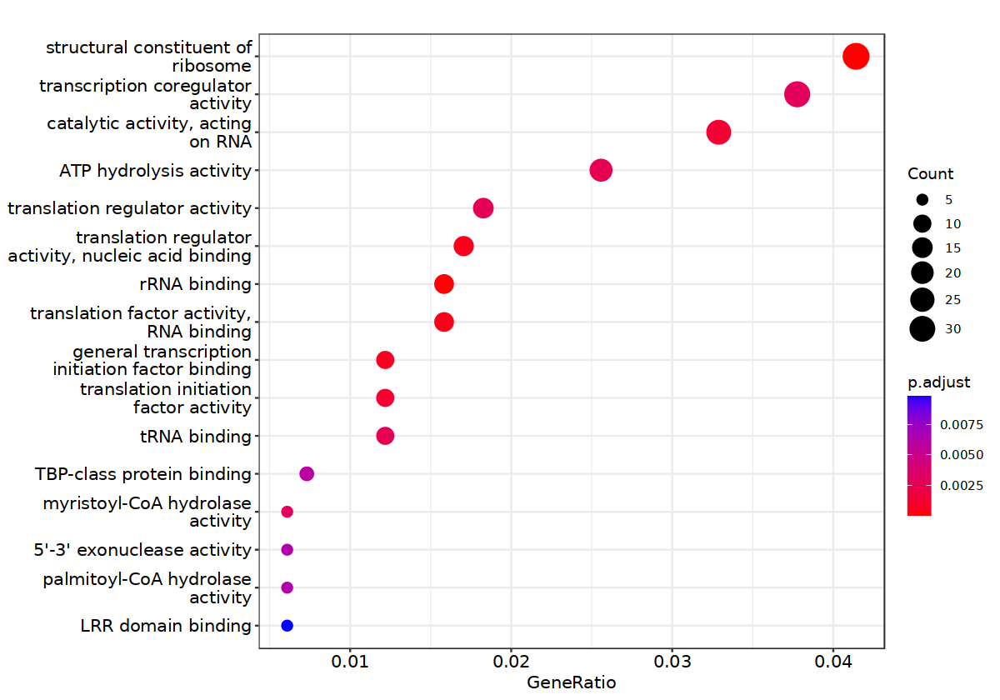

In [323]:
dotplot(res,showCategory=16)

In [324]:
res=enrichGO(gene = head(df$gene_short_name[ order(df$estimate,decreasing = F)],1000),OrgDb = "org.Mm.eg.db",keyType = "SYMBOL")

Warning message:
“Could not find Tgfbr3 in the default search locations, found in RNA assay instead”


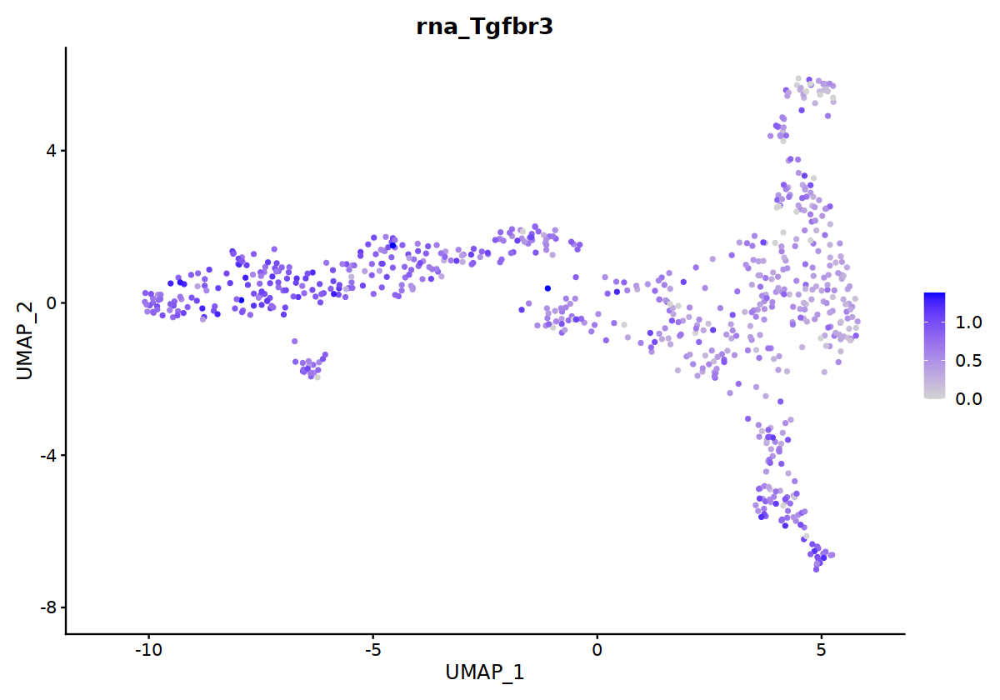

In [330]:
FeaturePlot(mer,"Tgfbr3")

In [327]:
res@result["GO:0046332",]

,ID,Description,GeneRatio,BgRatio,pvalue,p.adjust,qvalue,geneID,Count
,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<int>
GO:0046332,GO:0046332,SMAD binding,13/916,85/28404,3.239767e-06,0.0002876913,0.0002465633,Eid2/Tob1/Tgif1/Tgfbr1/Yy1/Tcf12/Smad5/Zbtb7a/Purb/Mef2a/Pax6/Bmpr1a/Tgfbr3,13


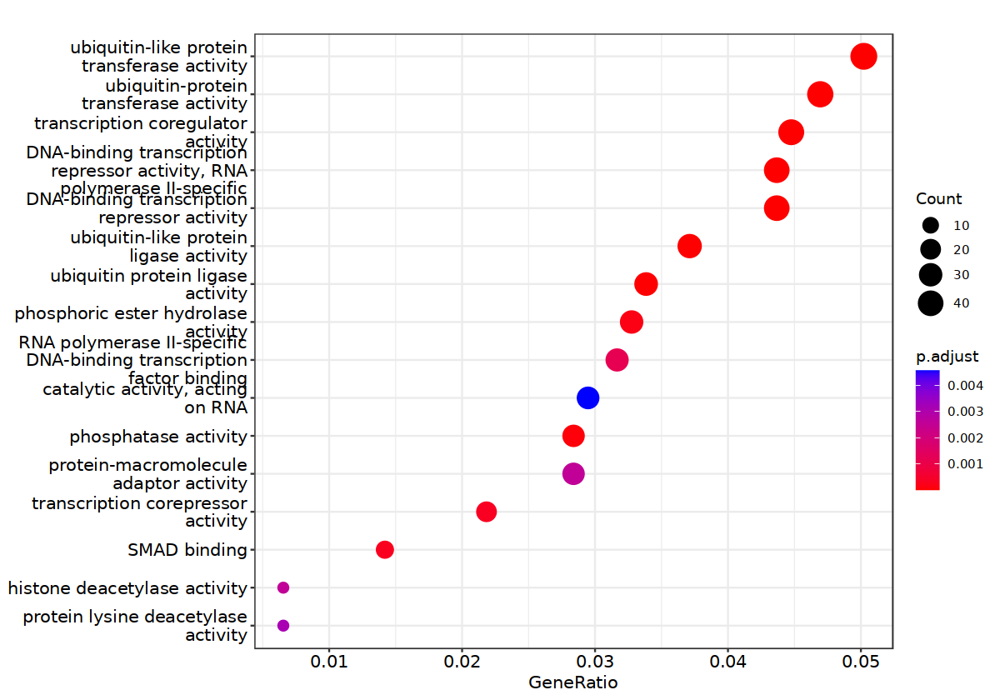

In [325]:
dotplot(res,showCategory=16)

In [294]:
library(clusterProfiler)

In [219]:
ls()

[1] "anno"      "AveExp"    "cds"       "df"        "dm"        "fit_coefs"
 [7] "gene_fits" "mer"       "reg"       "reg_assay" "regulon"   "sce"      
[13] "test"

In [217]:
saveRDS(fit_coefs,"monocle3.fit.gene.rds")

In [372]:
library(dplyr)
df=fit_coefs %>% filter(term == "pseudotime") %>% filter (q_value < 0.05) %>% 
         select(gene_short_name, term, q_value, estimate,num_cells_expressed) %>% arrange(order_by = estimate)
df

gene_short_name,term,q_value,estimate,num_cells_expressed
<chr>,<chr>,<dbl>,<dbl>,<int>
Pde2a,pseudotime,0.000000e+00,-226.3212074,1
4930568G15Rik,pseudotime,0.000000e+00,-226.3212074,1
Ido1,pseudotime,0.000000e+00,-226.3212074,1
Gm28076,pseudotime,0.000000e+00,-226.3212074,1
Gm29296,pseudotime,4.153945e-14,-57.3059008,2
Gm13881,pseudotime,5.923401e-13,-57.2308293,2
Slc6a19os,pseudotime,1.739600e-02,-38.0897680,1
Gm48923,pseudotime,1.739600e-02,-38.0897680,1
Klk9,pseudotime,1.739600e-02,-38.0897680,1


In [236]:
saveRDS(gene_fits,"gene_fits_pseudotime.rds")

In [260]:
save_monocle_objects(cds,directory_path = "monocle3.result")

  cds_object.rds  (full_cds  RDS  from  cell_data_set)

  rdd_umap_transform_model_umap.idx  (UMAP  UMAP_NN_index  from  reduce_dimension)



In [241]:
fit_coefs <- coefficient_table(gene_fits)
test=fit_coefs %>% filter(term != "(Intercept)") %>%
      select(gene_id, term, q_value, estimate)

In [57]:
mer$annotation="M"
mer$annotation[ mer$seurat_clusters==0 ]="GV2"
mer$annotation[ mer$seurat_clusters==2 ]="GV1"
mer$annotation[ mer$seurat_clusters==1 ]="M"

In [156]:
markers[ markers$cluster==0 & markers$avg_log2FC>0, ]

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene,num
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>,<int>
Fam46c,8.497037e-23,1.3297927,0.988,0.713,2.304227e-18,0,Fam46c,1
Osbpl9,9.968663e-21,0.9842994,1.000,0.963,2.703302e-16,0,Osbpl9,2
Git2,1.027594e-20,0.6551468,1.000,0.938,2.786630e-16,0,Git2,3
Fam110c,1.449470e-20,0.7483872,1.000,0.938,3.930674e-16,0,Fam110c,4
Thap1,2.460110e-20,0.7020585,1.000,0.938,6.671325e-16,0,Thap1,5
Actr8,2.778949e-20,0.5190631,1.000,0.912,7.535953e-16,0,Actr8,6
Ckap2,2.784924e-20,0.6687629,1.000,0.938,7.552156e-16,0,Ckap2,7
Haus3,2.966414e-20,0.7708059,1.000,0.988,8.044321e-16,0,Haus3,8
Prr14,1.955722e-19,0.7433966,1.000,0.863,5.303527e-15,0,Prr14,9


In [152]:
markers= FindAllMarkers(mer)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2



In [154]:
library(dplyr)
markers$num=1:nrow(markers)
markers[ markers$avg_log2FC>0, ] %>% group_by(cluster) %>% top_n(n=10,wt=-num)

p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene,num
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>,<int>
8.497037e-23,1.3297927,0.988,0.713,2.304227e-18,0,Fam46c,1
9.968663e-21,0.9842994,1.000,0.963,2.703302e-16,0,Osbpl9,2
1.027594e-20,0.6551468,1.000,0.938,2.786630e-16,0,Git2,3
1.449470e-20,0.7483872,1.000,0.938,3.930674e-16,0,Fam110c,4
2.460110e-20,0.7020585,1.000,0.938,6.671325e-16,0,Thap1,5
2.778949e-20,0.5190631,1.000,0.912,7.535953e-16,0,Actr8,6
2.784924e-20,0.6687629,1.000,0.938,7.552156e-16,0,Ckap2,7
2.966414e-20,0.7708059,1.000,0.988,8.044321e-16,0,Haus3,8
1.955722e-19,0.7433966,1.000,0.863,5.303527e-15,0,Prr14,9


In [141]:
library(dplyr)
markers$num=1:nrow(markers)
markers[ markers$avg_log2FC>0, ] %>% group_by(cluster) %>% top_n(n=10,wt=-num)

p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene,num
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>,<int>
9.365076e-21,0.8085882,1.000,0.988,2.539621e-16,0,Tbc1d14,1
1.836058e-20,1.1836884,0.952,0.750,4.979021e-16,0,Fam46c,2
2.703175e-20,0.8905875,1.000,1.000,7.330471e-16,0,Lsm14b,3
3.058943e-20,0.8654697,1.000,0.963,8.295242e-16,0,Dusp7,4
4.570652e-20,1.0135506,1.000,0.975,1.239469e-15,0,Lamb1,5
9.423241e-20,0.7482183,1.000,0.863,2.555394e-15,0,Prr14,6
1.979267e-19,0.8294995,1.000,0.950,5.367376e-15,0,Nkd1,7
1.385537e-18,0.6274909,1.000,0.975,3.757298e-14,0,Phf3,8
2.724918e-18,0.6151316,1.000,0.938,7.389432e-14,0,Git2,9


In [80]:
df=AverageExpression(mer,group.by = "stage")

Removing cells with NA for 1 or more grouping variables



In [83]:
ls()

[1] "df"       "markers1" "mer"      "obj"      "stage"    "stages"   "TT"